<img src="https://storage.googleapis.com/kaggle-competitions/kaggle/26680/logos/header.png?t=2021-04-23-22-04-05)" />

# Project Description

# Prologue

The coronavirus affected all of our lives severely in the last year; whether we got sick or not, whether we had severe symptoms or not. Therefore, when I saw a competition in Kaggle with the goal to find a better way to diagnose COVID19 cases, I was interested in the challenge both on the academic and personal levels. I find this also an opportunity to participate in a live competition and be a part of the Kaggle community.

# Project Description

## Overview
Here in Israel, it can be said that the Coronavirus is over. (This sentence was written three months ago, and was left here as a warning from overoptimism.)  After an amazing vaccine campaign, and after over 5 million people got vaccinated in a very short period of time, the pandemic has almost completely stopped.  
But all over the world, the pandemic is still spreading. As of today, there are 14M active cases worldwide and about 500K daily cases on average. All over the world, governments are racing against the virus by running their own vaccine campaigns. But the virus is still faster. So the effort to slow down the disease spreading is now of most importance.  
As we all learned in the last year, one of the key tools in this context is the early and large-scale detection of infections. The main method used for infection detection now is PCR tests. But these tests have their own disadvantages - their costs make it difficult to apply them at a large scale, and they have a lower bound on the results time, so it seems to be a good idea to search for additional tools for infection detection.
It's well known that COVID19 causes shortness of breath. But this phenomenon can also serve us - if the virus influences the lungs so strongly, we can try to detect the infection by examining the lungs.

In this project, we will develop a way to use chest radiographs (CXR) for COVID19 infection detection.  This could be a fast way to early determine COVID19 infection and could be another stone in the effort to block the virus.



 ## Competition Description From Kaggle
 Follows is the description of the competition from the Kaggle website:
 
<p>Five times more deadly than the flu, COVID-19 causes significant morbidity and mortality. Like other pneumonias, pulmonary infection with COVID-19 results in inflammation and fluid in the lungs. COVID-19 looks very similar to other viral and bacterial pneumonias on chest radiographs, which makes it difficult to diagnose. Your computer vision model to detect and localize COVID-19 would help doctors provide a quick and confident diagnosis. As a result, patients could get the right treatment before the most severe effects of the virus take hold.</p><p><img style="float: right" width="200" src="https://www.googleapis.com/download/storage/v1/b/kaggle-user-content/o/inbox%2F603584%2Fd514aaf604bc9667b518b232a77d1aa7%2FCXR%20image1.jpg?generation=1620769201081719&amp;alt=media"></p><p>Currently, COVID-19 can be diagnosed via polymerase chain reaction to detect genetic material from the virus or chest radiograph. However, it can take a few hours and sometimes days before the molecular test results are back. By contrast, chest radiographs can be obtained in minutes. While guidelines exist to help radiologists differentiate COVID-19 from other types of infection, their assessments vary. In addition, non-radiologists could be supported with better localization of the disease, such as with a visual bounding box.</p><p>As the leading healthcare organization in their field, the Society for Imaging Informatics in Medicine (SIIM)'s mission is to advance medical imaging informatics through education, research, and innovation. SIIM has partnered with the Foundation for the Promotion of Health and Biomedical Research of Valencia Region (FISABIO), Medical Imaging Databank of the Valencia Region (BIMCV) and the Radiological Society of North America (RSNA) for this competition.</p><p>In this competition, you’ll identify and localize COVID-19 abnormalities on chest radiographs. In particular, you'll categorize the radiographs as negative for pneumonia or typical, indeterminate, or atypical for COVID-19. You and your model will work with imaging data and annotations from a group of radiologists.</p><p>If successful, you'll help radiologists diagnose the millions of COVID-19 patients more confidently and quickly. This will also enable doctors to see the extent of the disease and help them make decisions regarding treatment. Depending upon severity, affected patients may need hospitalization, admission into an intensive care unit, or supportive therapies like mechanical ventilation. As a result of better diagnosis, more patients will quickly receive the best care for their condition, which could mitigate the most severe effects of the virus.</p>

## Understanding the challenge

This challenge, as well as the dataset itself, is composed of two levels. The first is the image level which contains the chest radiographs, and above it we have the study level, which contains the general conclusion from all the patient radiographs.  
On the study level, each study is classified by specialists as `Negative for Pneumonia`, or as `Typical Appearance`, `Indeterminate  Appearance`, or `Atypical Appearance` to Covid-19.
The grading system is based on [this paper](https://journals.lww.com/thoracicimaging/Fulltext/2020/11000/Review_of_Chest_Radiograph_Findings_of_COVID_19.4.aspx) which proposes a new reporting language for chest radiographs (CXR) findings related to COVID-19, as described in the following table (Table 1 in the paper):


> |Radiographic Classification | CXR Findings | Suggested Reporting Language|
|:--------------------------|:-------------|:----------------------------|
|Typical appearance|Multifocal bilateral, peripheral opacities Opacities with rounded morphology Lower lung–predominant distribution|“Findings typical of COVID-19 pneumonia are present. However, these can overlap with other infections, drug reactions, and other causes of acute lung injury”|
| Indeterminate appearance | Absence of typical findings AND Unilateral, central or upper lung predominant distribution | “Findings indeterminate for COVID-19 pneumonia and which can occur with a variety of infections and noninfectious conditions” |
| Atypical appearance | Pneumothorax or pleural effusion Pulmonary edema Lobar consolidation Solitary lung nodule or mass Diffuse tiny nodules Cavity	|“Findings atypical or uncommonly reported for COVID-19 pneumonia. Consider alternative diagnoses” |
| Negative for pneumonia | No lung opacities | “No findings of pneumonia. However, chest radiographic findings can be absent early in the course of COVID-19 pneumonia”|
      
Although these findings refer to the CXR themselves, on this challenge we were provided with these labels only at the study level, while each study can have many images.
On image level, each image has a list of bounding boxes of findings. The bounding boxes can contain findings from different types, as described by the competition hosts:
> Bounding boxes were placed on lung opacities, whether typical or indeterminate. Bounding boxes were also placed on some atypical findings including solitary lobar consolidation, nodules/masses, and cavities. Bounding boxes were not placed on pleural effusions, or pneumothoraces. No bounding boxes were placed for the negative for pneumonia category.

The dataset doesn't distinguish between the findings type. The findings were given the label opacity, and the prediction in the submission for the findings class should be always  `opacity`.  
The details of the study grading method according to the findings in the images described in the table above. Even though the exact meaning of the terminology is definitely beyond my understanding, one thing we can learn from this table is that the classifying is based on the nature of findings, as well as on their region in the lungs. This is crucial for a better understanding of what our model is supposed to learn.

# Notebook initialize

## Basic Imports

In [ ]:
!pip install numpy --upgrade 1>/dev/nell 2>&1
!pip install python-gdcm 1>/dev/null 2>&1

In [ ]:
from pathlib import Path
import sys
from ast import literal_eval

import numpy as np
import pandas as pd

import matplotlib as mlp
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import seaborn as sns

print(sys.version)

mlp.rcParams['figure.figsize'] = (15, 7)

3.7.10 | packaged by conda-forge | (default, Feb 19 2021, 16:07:37) 
[GCC 9.3.0]


## Enviroment Settings

To run this notebook I switched between Kaggle kernels and Google Colab. The main advantage of the Kaggle kernels is that the competition data came built-in for the kernel, and the disk is relatively fast. On the other hand, Google colab is a much more convenient environment, not to mention the free GPU while Kaggle kernels are limited to 30 GPU hours per week. Downloading the dataset from Colab and saving it on a mounted drive doesn't work - the data was too big and crashed the kernel. To be able to work on Google colab, I downloaded all the competition dataset on a local machine with a high upload rate and uploaded it to Google Drive. Then I could mount my drive on Colab kernel and get access to the data - but the performance that way was much worse than on Kaggle. The code below is used to switch between the environments.

In [ ]:
is_colab = 'google.colab' in sys.modules
if is_colab:
    from google.colab import drive
    drive.mount('/content/drive')
    path = Path('/content/drive/MyDrive/covid19-detection/data') 
else:
    path = Path('/kaggle/input/siim-covid19-detection') 

# EDA

The dataset is composed of three parts. The CXR files in DICOM format, and two metadata tables: one for the image level and another for the study level. Let's explore first the image-level metadata of the training set.

In [ ]:
image_df = pd.read_csv(path/'train_image_level.csv', index_col='id')

In [ ]:
image_df.head()

,boxes,label,StudyInstanceUID
id,,,
000a312787f2_image,"[{'x': 789.28836, 'y': 582.43035, 'width': 102...",opacity 1 789.28836 582.43035 1815.94498 2499....,5776db0cec75
000c3a3f293f_image,NaN,none 1 0 0 1 1,ff0879eb20ed
0012ff7358bc_image,"[{'x': 677.42216, 'y': 197.97662, 'width': 867...",opacity 1 677.42216 197.97662 1545.21983 1197....,9d514ce429a7
001398f4ff4f_image,"[{'x': 2729, 'y': 2181.33331, 'width': 948.000...",opacity 1 2729 2181.33331 3677.00012 2785.33331,28dddc8559b2
001bd15d1891_image,"[{'x': 623.23328, 'y': 1050, 'width': 714, 'he...",opacity 1 623.23328 1050 1337.23328 2156 opaci...,dfd9fdd85a3e


Before doing anything else, we'd like to change this terrible column name `StudyInstanceUID` to a more reasonable one.

In [ ]:
image_df = image_df.rename(columns={'StudyInstanceUID':'study_id'})

Now it's much better.

For each image we are provided with image id, study id, the findings bounding boxes, and labels for each bounding box. Let's examine the label column first.
The content of the label column corresponds to the submission's desired format. It contains a description of an unlimited number of finding, separated by whitespace. Each of the descriptions contains 6 fields, also separated by whitespace, as follows:
  
`finding_label confidence xmin ymin xmax ymax  `
The content of this row is as this pattern, repeated as the number of this image's findings. So if we have $k$ finding for specific image, the label row will be:
`finding_label_1 confidence_1 xmin_1 ymin_1 xmax_1 ymax_1 finding_label_2 ...  finding_label_k confidence_k xmin_k ymin_k xmax_k ymax_k `

Let's extract these values.

In [ ]:
def extract_label(row):
    values = row.label.split()
    if len(values) % 6 != 0:
        # corrupted row
        print(f'row #{row.index}: wrong number of paramerers in label field')
    return [dict(zip('id finding_id label confident xmin ymin xmax ymax'.split(), [row.name, i] + values[6*i:6*(i+1)])) for i in range(len(values) // 6)]

In [ ]:
findings = pd.DataFrame.from_dict(image_df.apply(extract_label, axis=1).sum()).set_index('id')
findings.head()

,finding_id,label,confident,xmin,ymin,xmax,ymax
id,,,,,,,
000a312787f2_image,0,opacity,1,789.28836,582.43035,1815.94498,2499.73327
000a312787f2_image,1,opacity,1,2245.91208,591.20528,3340.5737,2352.75472
000c3a3f293f_image,0,none,1,0,0,1,1
0012ff7358bc_image,0,opacity,1,677.42216,197.97662,1545.21983,1197.75876
0012ff7358bc_image,1,opacity,1,1792.69064,402.5525,2409.71798,1606.9105


Now we can see the domains of these values

In [ ]:
print(f'The unique findings label values are {findings.label.unique()}')

The unique findings label values are ['opacity' 'none']


In [ ]:
print(f'The unique findings confdence values are {findings.confident.unique()}')

The unique findings confdence values are ['1']


The labels are only `none` and `opacity`, and the confidence in the training set is always 1 (since this is a labeled dataset). All bounding box data is provided in the `boxes` field, this field is `Nan` when there are no findings (as we can see in the second row in the head of the Dataframe printed above). So in fact, all the data we need exists in the `boxes` field.  
Thus, we can extract the findings data directly from the boxes fields and examine some of their properties.

In [ ]:
findings = image_df.apply(lambda x: [{'id':x.name, 'finding_id': i, **box} for i, box in enumerate(literal_eval(x.boxes))] if type(x.boxes) == str else [{'id': x.name}], axis=1)
findings = pd.DataFrame.from_dict(findings.sum()).set_index('id')

In [ ]:
print(f'Total number of findings: {findings.shape[0]}')
findings.head()

Total number of findings: 9893


,finding_id,x,y,width,height
id,,,,,
000a312787f2_image,0.0,789.28836,582.43035,1026.65662,1917.30292
000a312787f2_image,1.0,2245.91208,591.20528,1094.66162,1761.54944
000c3a3f293f_image,NaN,NaN,NaN,NaN,NaN
0012ff7358bc_image,0.0,677.42216,197.97662,867.79767,999.78214
0012ff7358bc_image,1.0,1792.69064,402.55250,617.02734,1204.35800


Before further exploration of findings properties, let's explore the study-level metadata:

In [ ]:
study_df = pd.read_csv(path/'train_study_level.csv', index_col='id')

In [ ]:
study_df.head()

,Negative for Pneumonia,Typical Appearance,Indeterminate Appearance,Atypical Appearance
id,,,,
00086460a852_study,0,1,0,0
000c9c05fd14_study,0,0,0,1
00292f8c37bd_study,1,0,0,0
005057b3f880_study,1,0,0,0
0051d9b12e72_study,0,0,0,1


In this dataframe each study is classified into one of 4 classes: `Negative for Pneumonia`, `Typical Appearance`, `Indeterminate Appearance`, and `Atypical Appearance`. It is important to know how these classes are distributed over the dataset.  
In the evaluation section in the competition details in Kaggle it's said that
> Studies in the test set may contain more than one label. They are as follows: `negative`, `typical`, `indeterminate`, `atypical`

Accordingly,  this is a multilabel classification task.    
In contrast, in [a post](https://www.kaggle.com/c/siim-covid19-detection/discussion/240250) in the competition discussion section, the hosts indicated that
> Per the grading schema, chest radiographs are classified into one of four categories, which are **mutually exclusive**

Since the two descriptions contradict, it is worth inspecting the training set to see which labels can be assigned to an image together.

In [ ]:
(study_df.apply(sum, axis=1) == 1).all()

True

So in the training set, each of the studies has a single label attached to it, and this classification is in fact one-hot encoded classification for each study to one of those 4 classes.  

Since the results of our check on the training set supports the second post, and since inherently, by their meanings, the labels seem to be mutually exclusive , we will leave it as a single-label classification task. For convenience , we will store the labels in one row rather than in one-hot encoding format and join it with the images dataframe.

In [ ]:
image_df.study_id += '_study' 
study_labels = study_df.idxmax(axis=1).rename('study_label')
# study_labels.index = study_labels.index.str.extract('(^[^_]*)').apply(lambda x:x[0], axis=1)
image_df = image_df.merge(study_labels, left_on='study_id', right_index=True)

Next we will check how these classes are distributed over the dataset.

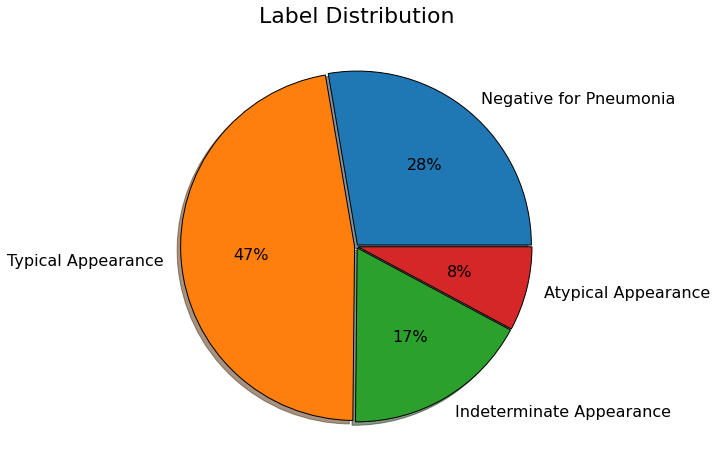

In [ ]:
label_count = study_df.sum()
plt.figure(figsize=(8, 8))
plt.pie(label_count, labels=label_count.index, wedgeprops={'edgecolor': 'black'}, autopct='%1.f%%', textprops={'fontsize': 16}, explode=[.01]*4, shadow=True)
plt.title('Label Distribution', fontdict={'fontsize':22});

We have 47% certain Covid cases (typical appearance), 36% non-covid (28% negative for pneumonia and 8% atypical to covid), and 17% obscure cases. From a covid vs non-covid point of view, the dataset is quite balanced. But from the classification point of view,  almost 50% of the cases are from one class and only 8% of the cases are from another class.  
To better understand the distribution, let’s see that classification distribution in absolute numbers:

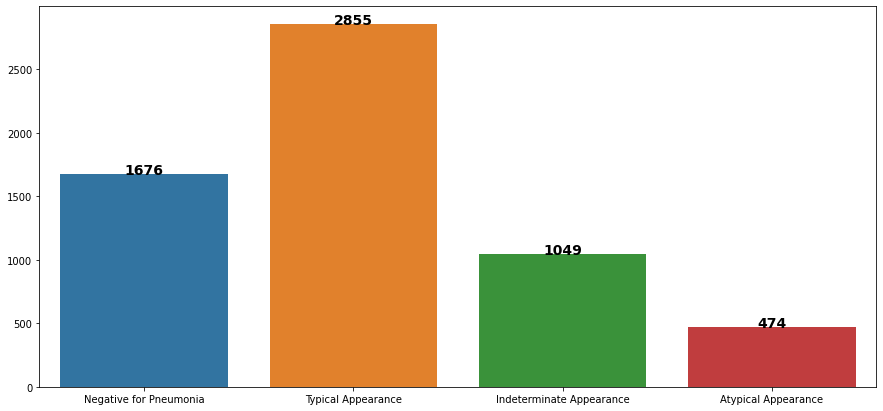

In [ ]:
g = sns.barplot(x=label_count.index, y=label_count)
for label, count in zip(range(label_count.index.shape[0]), label_count):
    g.text(label, count, count, color='black', ha="center", fontdict=dict(fontsize=14, weight='bold'))

Next, let's look at some properties of the findings. The number of findings varies for each image. Each of them is an opacity (or another type of the above-mentioned findings) in the CXR, and for each of them we provided the bounding box of the opacity area. Let’s look at the number of findings per image and the main statistical properties of their areas: sum, mean, max, etc.

In [ ]:
findings['area'] = findings.width * findings.height
findings_props = findings.groupby('id').area.agg(['count','sum', 'min', 'max', 'mean', 'std'])

In [ ]:
# findings_props.index = findings_props.index.str.extract('(^[^_]*)').apply(lambda x:x[0], axis=1)
image_props = image_df.join(findings_props)
image_props.head()

,boxes,label,study_id,study_label,count,sum,min,max,mean,std
id,,,,,,,,,,
000a312787f2_image,"[{'x': 789.28836, 'y': 582.43035, 'width': 102...",opacity 1 789.28836 582.43035 1815.94498 2499....,5776db0cec75_study,Typical Appearance,2,3.896712e+06,1.928301e+06,1.968412e+06,1.948356e+06,28362.881484
000c3a3f293f_image,NaN,none 1 0 0 1 1,ff0879eb20ed_study,Negative for Pneumonia,0,0.000000e+00,NaN,NaN,NaN,NaN
0012ff7358bc_image,"[{'x': 677.42216, 'y': 197.97662, 'width': 867...",opacity 1 677.42216 197.97662 1545.21983 1197....,9d514ce429a7_study,Typical Appearance,2,1.610730e+06,7.431218e+05,8.676086e+05,8.053652e+05,88025.459354
001398f4ff4f_image,"[{'x': 2729, 'y': 2181.33331, 'width': 948.000...",opacity 1 2729 2181.33331 3677.00012 2785.33331,28dddc8559b2_study,Atypical Appearance,1,5.725921e+05,5.725921e+05,5.725921e+05,5.725921e+05,NaN
001bd15d1891_image,"[{'x': 623.23328, 'y': 1050, 'width': 714, 'he...",opacity 1 623.23328 1050 1337.23328 2156 opaci...,dfd9fdd85a3e_study,Typical Appearance,2,1.531871e+06,7.421867e+05,7.896840e+05,7.659353e+05,33585.683848


The findings count for each class label is:

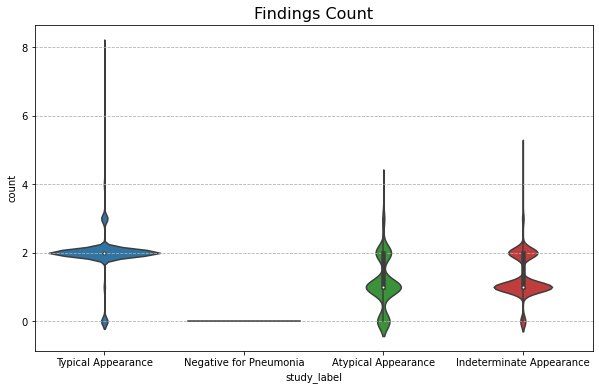

In [ ]:
plt.figure(figsize=(10,6))
plt.gca().yaxis.grid(linestyle='--')
sns.violinplot(data=image_props, x='study_label', y='count')
plt.title('Findings Count', fontdict={'fontsize':16})
plt.show()

It is clear now that all the negative results have no findings at all, as stated in the grading method table. On the other hand, for each of the other four types it seems that there are instances with no opacity findings, contrary to these grades descriptions in the above table. But is this really the case? We saw earlier that we have more images than studied. That is, some studies have more than one image. So it seems that in some cases the prognosis is based on findings that are determined only in one of the scans. Let's verify this conclusion.

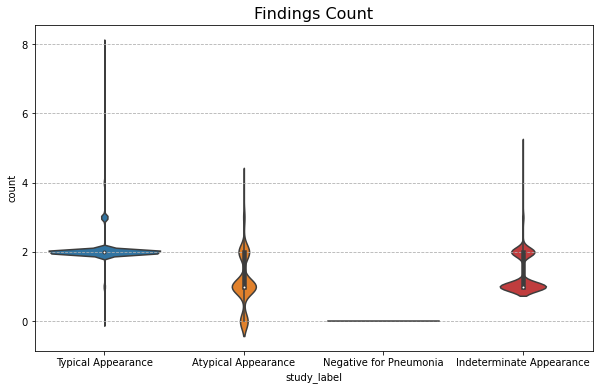

In [ ]:
study_findings_props = image_props.groupby(['study_id'])
study_findings_count = study_findings_props['count'].agg('sum').to_frame().join(study_labels)
plt.figure(figsize=(10,6))
plt.gca().yaxis.grid(linestyle='--')
sns.violinplot(data=study_findings_count, x='study_label', y='count')
plt.title('Findings Count', fontdict={'fontsize':16})
plt.show()

It becomes clear that the above conclusion is correct. Almost all of the clear covid-19 cases have 2 findings, and a couple of them with 3 findings. The indeterminate cases also have at least one finding each, and only the non-covid cases sometimes have no findings, even when positive to pneumonia. But according to our table, `No Findings` means `Positive to Pneumonia`, so we'll put these instances aside for now.

In [ ]:
studies_to_remove = study_df[study_df.index.isin(study_findings_props['count'].sum()[study_findings_props['count'].sum() == 0].index) & 
         (study_df['Negative for Pneumonia'] == 0)]
study_df['removed'] = False
study_df.loc[studies_to_remove.index, 'removed'] = True
print(f'Total number of removed rows: {study_df.loc[studies_to_remove.index].shape[0]}')
print(f'\n\nRemoved rows by label:\n')
print(study_df.loc[studies_to_remove.index].iloc[:, :-1].sum().to_string())

Total number of removed rows: 84


Removed rows by label:

Negative for Pneumonia       0
Typical Appearance           1
Indeterminate Appearance     0
Atypical Appearance         83


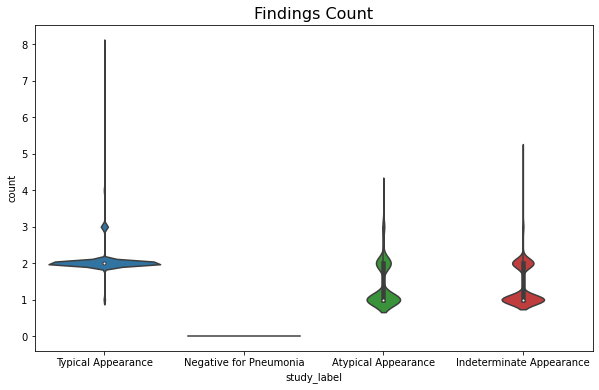

In [ ]:
image_props = image_props.drop(image_props.loc[image_props.study_id.isin(studies_to_remove.index)].index)

study_findings_props = image_props.groupby(['study_id'])
study_findings_count = study_findings_props['count'].agg('sum').to_frame().join(study_labels)
plt.figure(figsize=(10,6))
# plt.gca().yaxis.grid(linestyle='--')
sns.violinplot(data=study_findings_count, x='study_label', y='count')
plt.title('Findings Count', fontdict={'fontsize':16})
plt.show()

Now all the positive cases have findings. Let's inspect other findings properties:

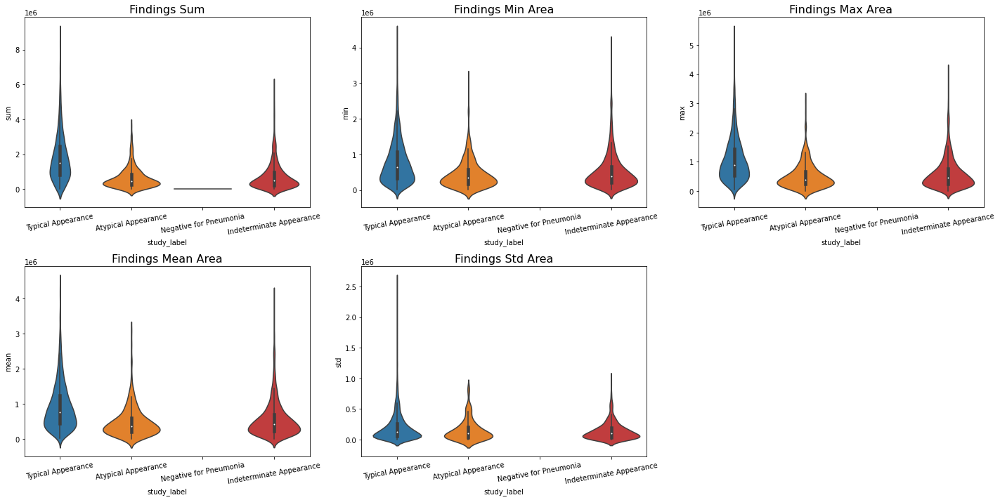

In [ ]:
plt.figure(figsize=(20,10))

for i, prop in enumerate(['sum', 'min', 'max', 'mean', 'std'], start=1):
    plt.subplot(2, 3, i)
#     plt.gca().yaxis.grid(linestyle='--')
    sns.violinplot(data=image_props, x='study_label', y=prop, order=study_labels.unique())
    plt.xticks(rotation=10)
    title = f'Findings {prop.title()}'
    if prop.title() != 'Sum': title += ' Area'
    plt.title(title, fontdict={'fontsize':16})
plt.tight_layout()
plt.show()

One can see that clear covid cases strongly tend to have  larger findings area. The indeterminate cases also tend to have larger findings areas than the atypical ones, but this difference is much less significant. Let's inspect these features again, but now at the study level.

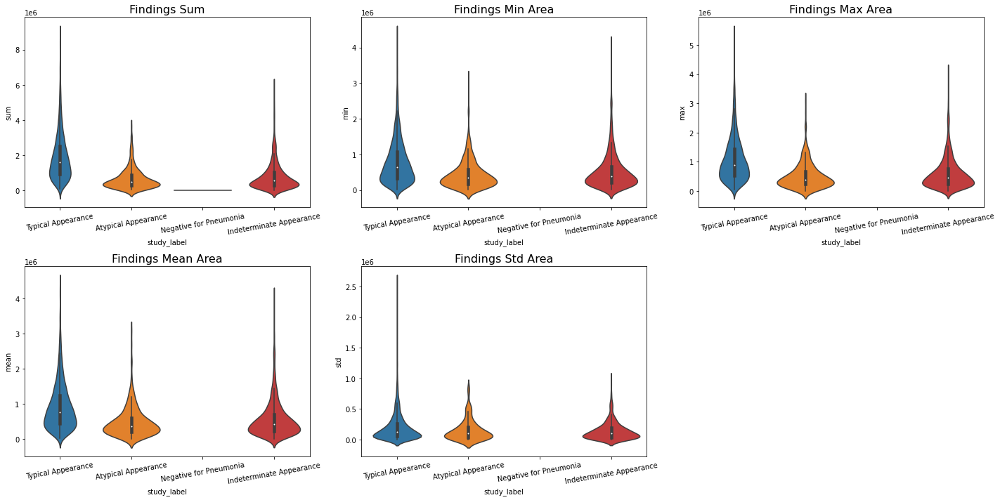

In [ ]:
study_props = (image_props[['study_id']]
               .join(findings)
               .groupby('study_id').area.agg(['count','sum', 'min', 'max', 'mean', 'std'])
               .merge(study_labels, left_on='study_id', right_index=True))

plt.figure(figsize=(20,10))

for i, prop in enumerate(['sum', 'min', 'max', 'mean', 'std'], start=1):
    plt.subplot(2, 3, i)
#     plt.gca().yaxis.grid(linestyle='--')
    sns.violinplot(data=study_props, x='study_label', y=prop, order=study_labels.unique(), pallete=['blue', 'green', 'green', 'red'])
    plt.xticks(rotation=10)
    title = f'Findings {prop.title()}'
    if prop.title() != 'Sum': title += ' Area'
    plt.title(title, fontdict={'fontsize':16})
plt.tight_layout()
plt.show()

It seems that there is no significant difference between the image level and study level. But, this leads us to two important questions: How many images are related to one study on average? In case that a study had more than one image, how many images the prognosis is based on?

In [ ]:
image_df.groupby('study_id').label.count().unique()

array([1, 2, 3, 9, 4, 6, 5, 7])

In [ ]:
print(image_df.groupby('study_id').label.agg(images_count='count').value_counts().to_string())
# g = sns.countplot(data=image_df.groupby('study_id').label.agg(images_count='count'), x='images_count')

images_count
1               5822
2                207
3                 15
4                  4
5                  3
6                  1
7                  1
9                  1


In most cases there’s one image per study. But in the cases with multiple images, what is the difference between the images? Is the prognosis based on all of the images?  
It is straightforward to get an answer to the second password from the data. We simply count the number of images labeled with findings.

In [ ]:
multiple_images = image_df.groupby('study_id').filter((lambda x: x.label.count() > 1))
multiple_images_with_findings = multiple_images[multiple_images.boxes.notna()]
print('Images with finding in Study Counts')
print(multiple_images_with_findings.groupby('study_id').boxes.agg(count='count').value_counts().to_string())

Images with finding in Study Counts
count
1        177


So it is established that , there is never more than one image labeled with findings per study. Now it will interesting to see the difference between the images in one study. To do that, we have to pay attention to the third and most important part of our dataset - the DICOM files.

#### DICOM files
The data is provided in [DICOM fromat](https://en.wikipedia.org/wiki/DICOM), which is the standard in medical imaging information and related data. This format packs each medical image with related data, such as Patient Id, Name, Sex, etc. In our case, the data de-identified for privacy reasons, but we still may have important data in the metadata provided in the DICOM file.
Let's pick a file and see what it looks like.

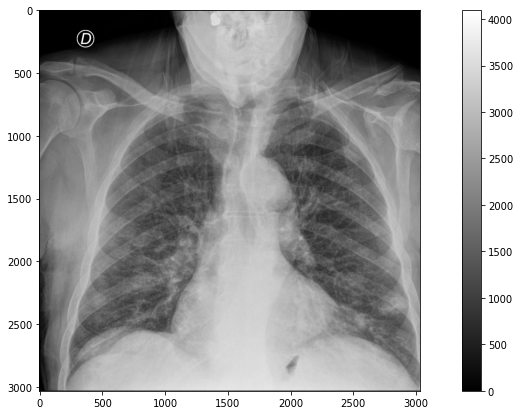

In [ ]:
from pydicom import dcmread

def extract_id(full_id): return full_id[:full_id.index('_')]
def get_file_path(study_id, image_id, dataset='train'):
    study_id, image_id = extract_id(study_id), extract_id(image_id)
    return [*(path/dataset/study_id).glob(f'**/{image_id}.dcm')][0] 

#     return [*(path/dataset/row.study_id.str.extract("(^[^_]*)").values[0,0]).glob(f'**/{row.index.str.extract("(^[^_]*)").values[0,0]}.dcm')][0] 
sample = image_df.sample(random_state=14)
fpath = get_file_path(sample.study_id.values[0], sample.index.values[0])
ds = dcmread(fpath)

# print(ds)
plt.imshow(ds.pixel_array, cmap=plt.cm.gray)
plt.colorbar()
plt.show()

Let's take a taste from our data:

In [ ]:
# import gdcm
def show_dicoms(df, ncols=5, size=5, annotate=False):
    n = df.shape[0]
    nrows = int(np.ceil(n/ncols))

    fig = plt.figure(figsize=(size*ncols, size*nrows))
    for i, row in enumerate(df.itertuples()):
        fpath = get_file_path(row.study_id, row.Index)
        ds = dcmread(fpath)
        plt.subplot(nrows, ncols,i+1)
        plt.imshow(ds.pixel_array, cmap=plt.cm.gray)
        if annotate:
            if isinstance(row.boxes, str):
                for box in literal_eval(row.boxes):
                    rect = patches.Rectangle((box['x'], box['y']), 
                                             box['width'], box['height'],
                                            color='r', fill=False)
                    plt.gca().add_patch(rect)
        plt.xticks([]), plt.yticks([])
    plt.subplots_adjust()
    return fig
#     plt.show()

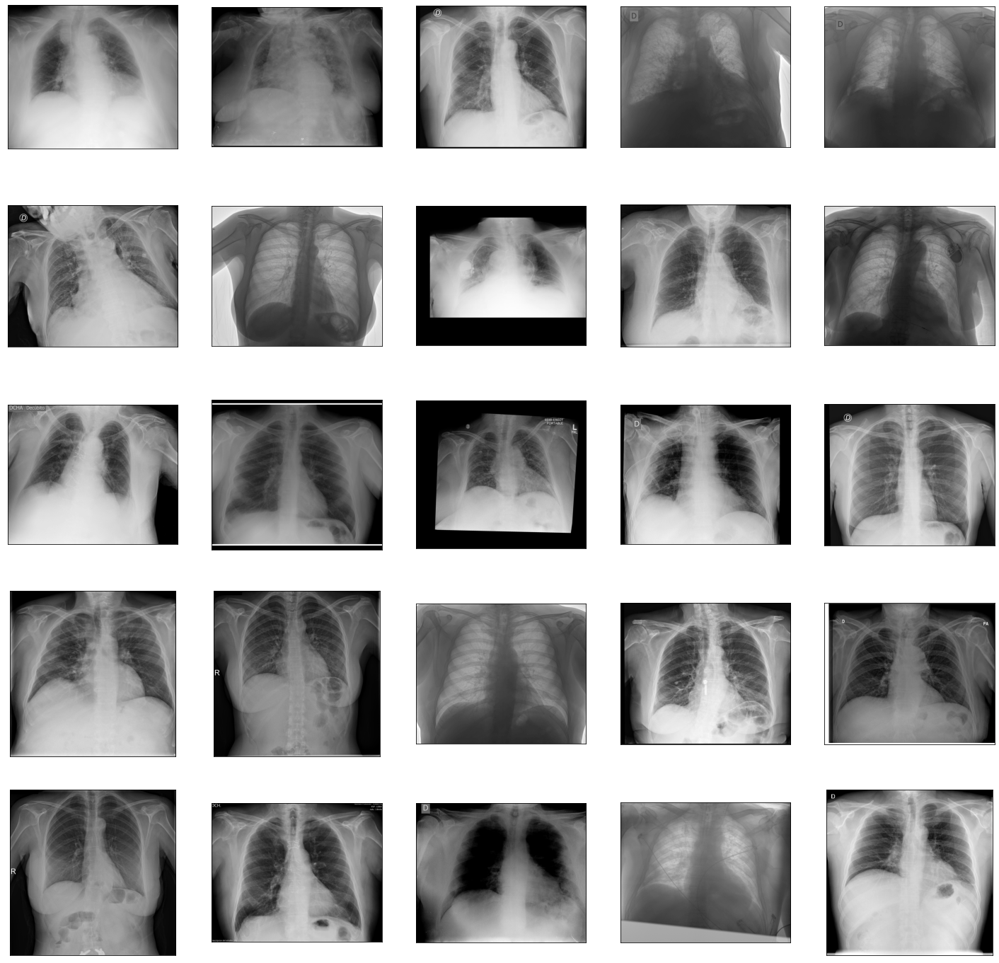

In [ ]:
show_dicoms(image_df.sample(25, random_state=25))
plt.show()

Many of the images are cropped, rotated, and have different lummination level. Lungs are contained in all of the images, but the location of the lungs in the image is not constant, The images margin size are varying, and the images may contain other body parts - neck, stomach, hands, etc. To get a better understanding of the matter in hand, it will be helpful to see CXR from the different labels with the annotated bounding boxes drawn on the image.

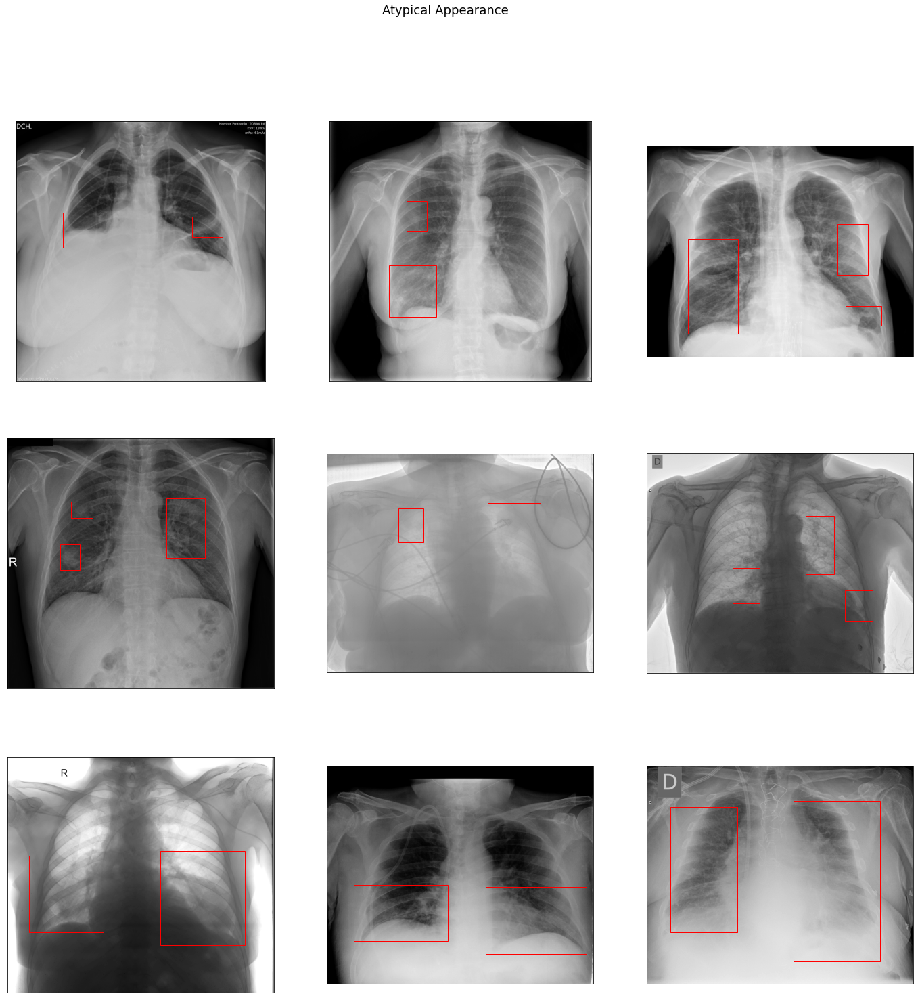

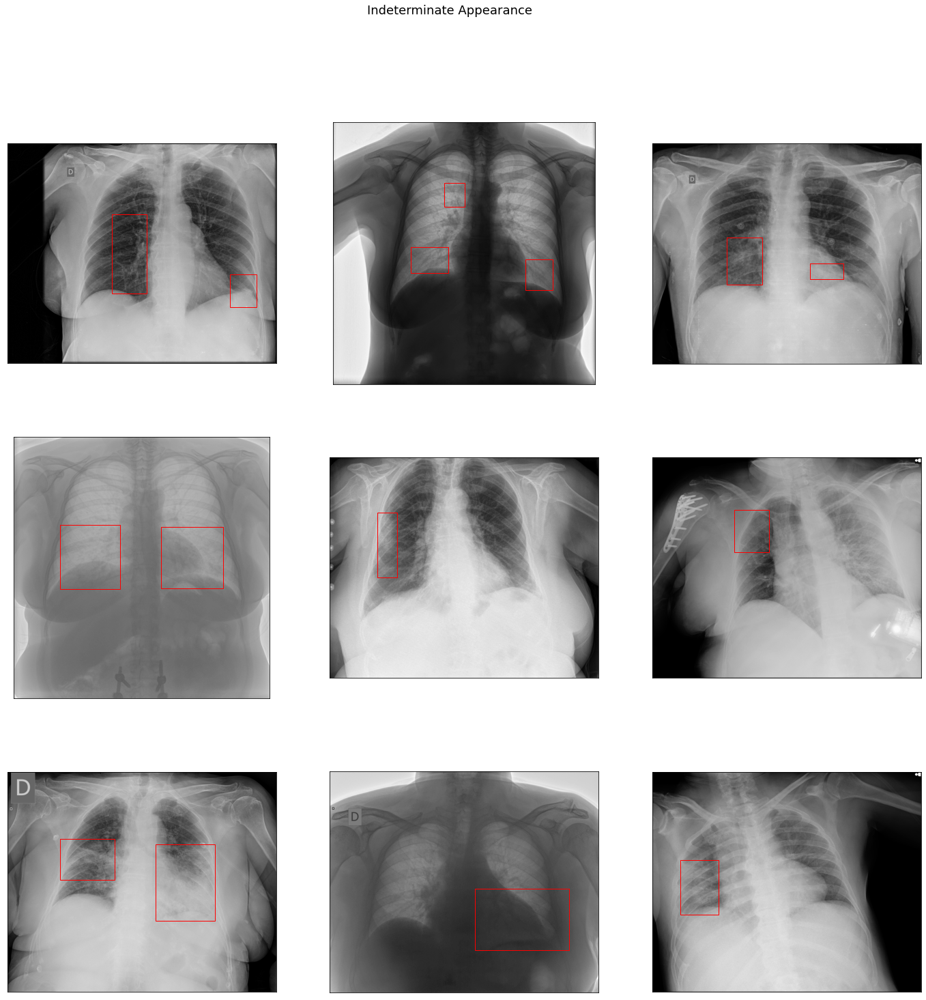

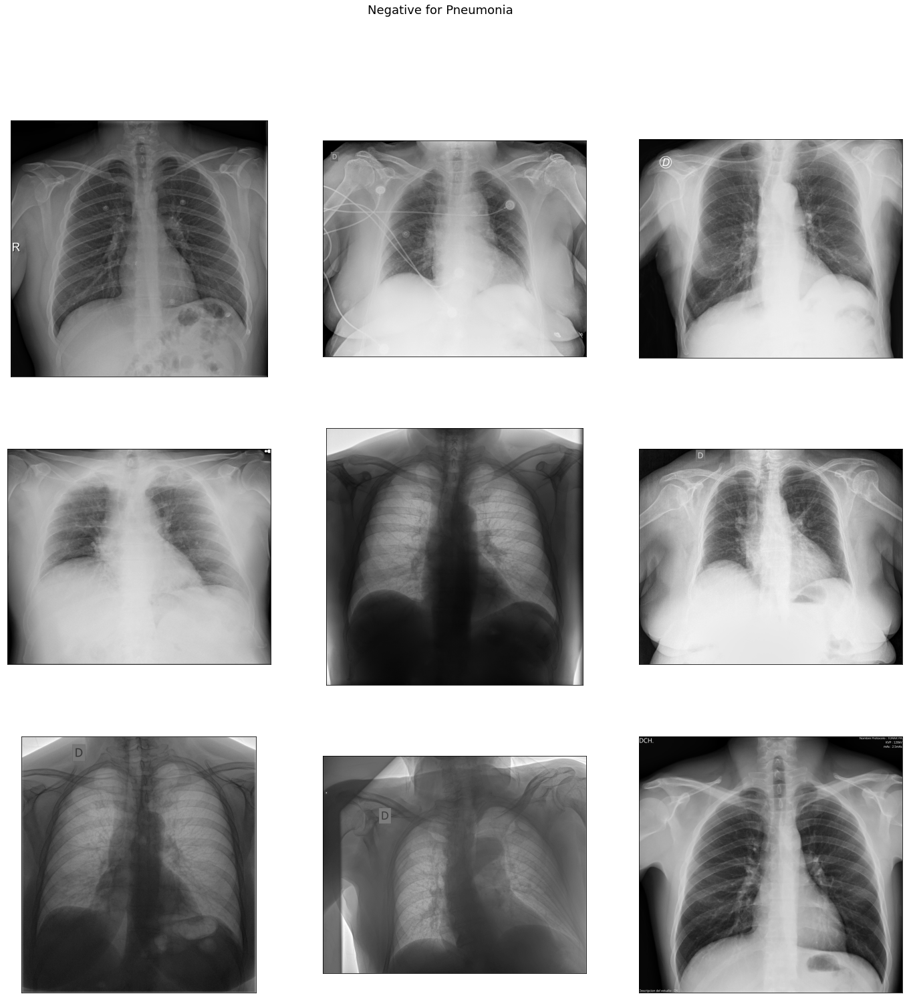

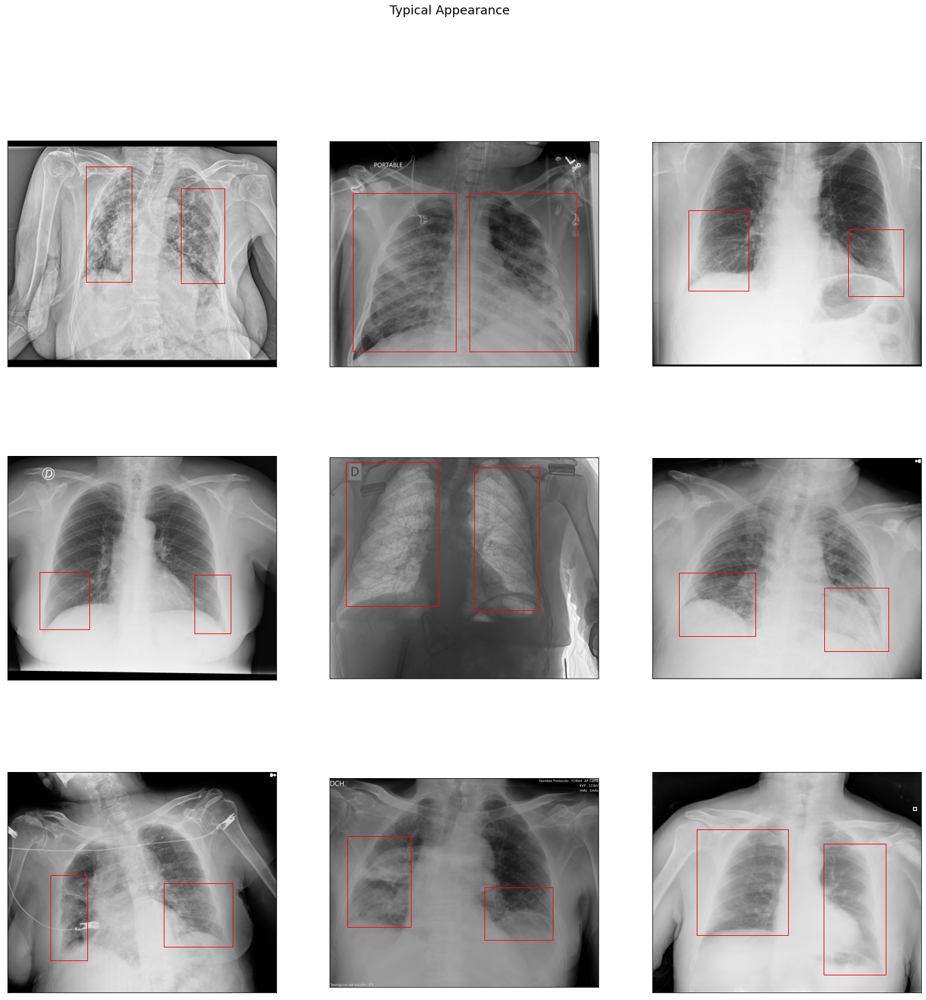

In [ ]:
gb = image_df.groupby('study_label')
for name, group in gb:
    if not name.startswith('Neg'): group = group.loc[group.boxes.notna()]
    fig = show_dicoms(group.sample(9, random_state=4), 3, 8, annotate=True)
    fig.suptitle(name, fontsize=18)
    plt.show()

The results are not clear for the non-expert eye. Although sometimes there is a kind of opacity in the boxes, in other cases there is no clear difference between the area inside and the area outside the box. This will affect the algorithm development and verification processes since I will not be able to rely on my own knowledge and intuition.

Now let's take a look at the metadata provided by the DICOMs. The attributes that may interest us are the body part examined, sex, image size, pixel spacing (represent the physical size of the image), modality (the scanning method), and image type. Let's extract these features to a pandas dataframe for later use.

In [ ]:
from tqdm.notebook import tqdm
data = {}
def append_dcm_properties(row, props):
#     print(row)
    try:
        fpath = get_file_path(row.study_id, row.Index)
#         fpath = [*(path/'train'/row.study_id[:row.study_id.index("_")]).glob(f'**/{row.Index[:row.Index.index("_")]}.dcm')][0] 
        ds = dcmread(fpath)
        data[row.Index] = {prop: getattr(ds, prop.replace(' ', '')) for prop in props}
    except Exception as e:
        print(f'**/{row.name[:row.name.index("_")]}.dcm')
        raise
        
props = ['Image Type', 'Modality','Body Part Examined', 'Photometric Interpretation',
                                       'Patient Sex', 'Imager Pixel Spacing', 'Rows', 'Columns']
# image_df.apply(lambda x: append_dcm_properties(x, props) , axis=1)
for row in tqdm(image_df.itertuples(), total=image_df.shape[0]):
    append_dcm_properties(row, props)

  0%|          | 0/6334 [00:00<?, ?it/s]

In [ ]:
DICOM_metadata = pd.DataFrame.from_dict(data, orient='index')

In [ ]:
DICOM_metadata.to_csv('DICOM_metadata.csv')

In [ ]:
dm = pd.read_csv('/kaggle/working/DICOM_metadata.csv', index_col=0)
dm.head()

,Image Type,Modality,Body Part Examined,Photometric Interpretation,Patient Sex,Imager Pixel Spacing,Rows,Columns
000a312787f2_image,"['ORIGINAL', 'PRIMARY']",DX,CHEST,MONOCHROME2,M,"[0.1, 0.1]",3488,4256
000c3a3f293f_image,"['ORIGINAL', 'PRIMARY']",CR,CHEST,MONOCHROME2,M,"[0.15, 0.15]",2320,2832
0012ff7358bc_image,"['DERIVED', 'PRIMARY']",DX,PORT CHEST,MONOCHROME2,F,"[0.139, 0.139]",2544,3056
001398f4ff4f_image,"['DERIVED', 'PRIMARY', 'POST_PROCESSED', 'RT',...",CR,CHEST,MONOCHROME1,F,"[0.1, 0.1]",3520,4280
001bd15d1891_image,"['ORIGINAL', 'PRIMARY']",DX,CHEST,MONOCHROME1,M,"[0.125, 0.125]",2800,3408


Let's inspect the value ranges of our new data:

In [ ]:
for column in dm[:]:
    print(f'{column}:' )
    print(dm[column].unique())
    print('-'*100)

Image Type:
["['ORIGINAL', 'PRIMARY']" "['DERIVED', 'PRIMARY']"
 "['DERIVED', 'PRIMARY', 'POST_PROCESSED', 'RT', '', '', '', '', '100000']"
 "['DERIVED', 'SECONDARY', '', 'CSA RESAMPLED']"
 "['ORIGINAL', 'SECONDARY']" "['ORIGINAL', 'PRIMARY', '']" 'ORIGINAL'
 "['DERIVED', 'PRIMARY', '']"
 "['ORIGINAL', 'SECONDARY', 'ORIGINAL', 'PRIMARY', '']"
 "['ORIGINAL', 'PRIMARY', '', 'RAD']"
 "['DERIVED', 'PRIMARY', 'POST_PROCESSED', 'RT', '', '', '', '', '150000']"
 "['DERIVED', 'PRIMARY', 'POST_PROCESSED', '', 'RENORMALIZED', '20200405215415', '', '', '100000']"
 "['DERIVED', 'PRIMARY', 'POST_PROCESSED', '', '', '', '', '', '100000']"
 "['DERIVED', 'PRIMARY', 'POST_PROCESSED', '', 'RENORMALIZED', '20200405214833', '', '', '100000']"
 'DERIVED']
----------------------------------------------------------------------------------------------------
Modality:
['DX' 'CR']
----------------------------------------------------------------------------------------------------
Body Part Examined:
['CHEST' 'P

The first thing to inspect is the sex field.
How is our data splitted between the sexes? How the sex is related with the COVID19 prognoses?

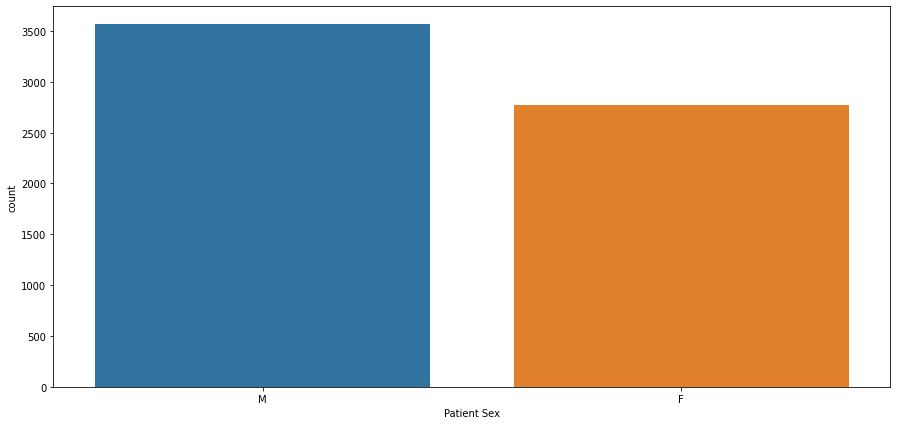

In [ ]:
sns.countplot(data=dm, x='Patient Sex');

<AxesSubplot:xlabel='study_label', ylabel='count'>

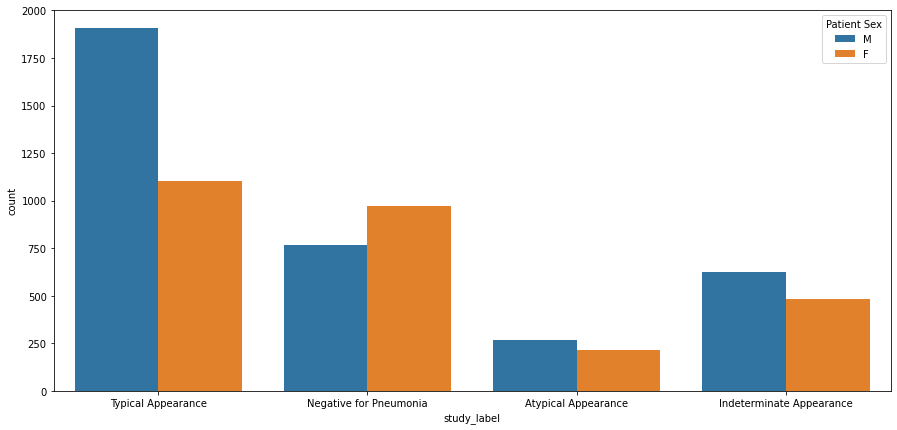

In [ ]:
plt.figure(figsize=(15,7))
sns.countplot(data=dm.join(image_df), x='study_label', hue='Patient Sex')

We can see here the well-known fact that statistically women suffer less from Covid-19. Although our data is quite balanced with respect to sex, women suffer much less from pneumonia of any kind. In the typical covid cases (clear/severe covid cases) there are about two-thirds cases of women than men.

In `Body Part Examined` column, we have the unique values
>`'CHEST' 'PORT CHEST' 'TORAX' nan 'T?RAX' 'Pecho' 'THORAX' 'ABDOMEN'
 'SKULL' '2- TORAX' 'TÒRAX' 'PECHO'`
 
'CHEST', 'THORAX' (which exists in many versions), and 'PECHO' are all the same, whether you prefer English or Spanish. Let's try to see what else we can extract from the metadata. (Why do we have SKULLs here???)

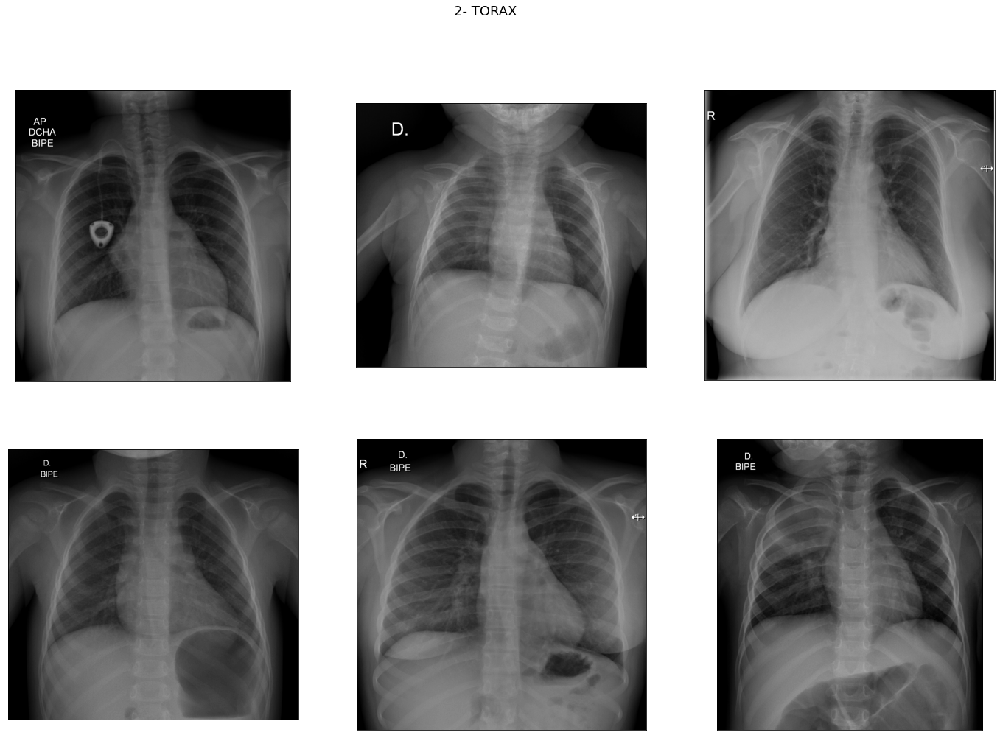

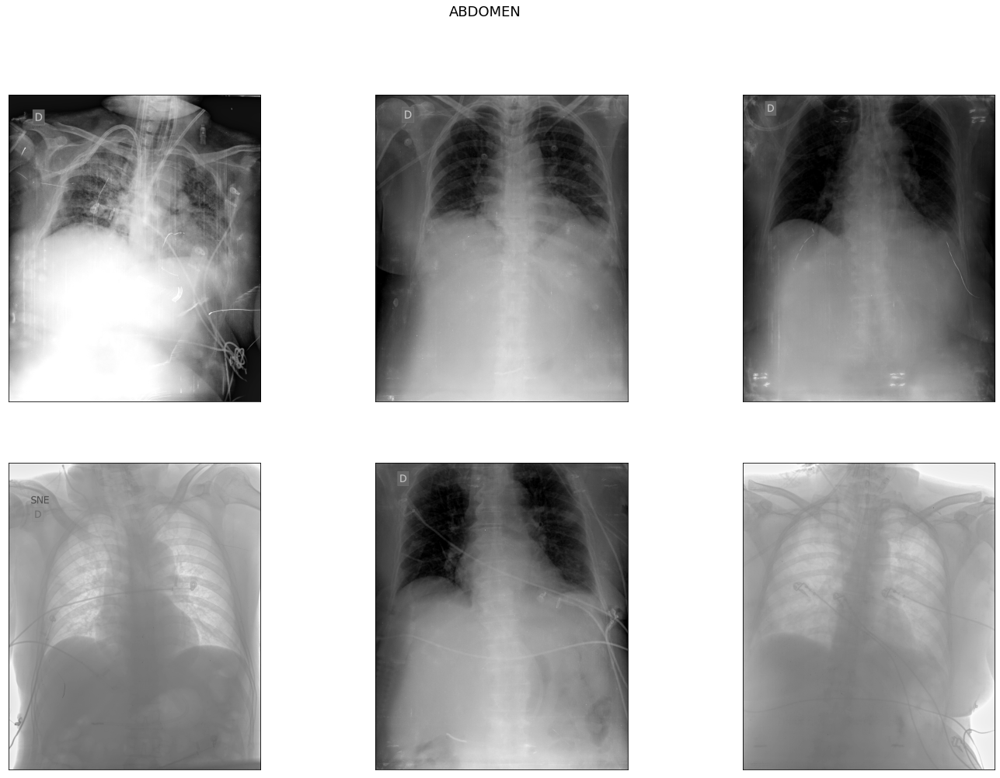

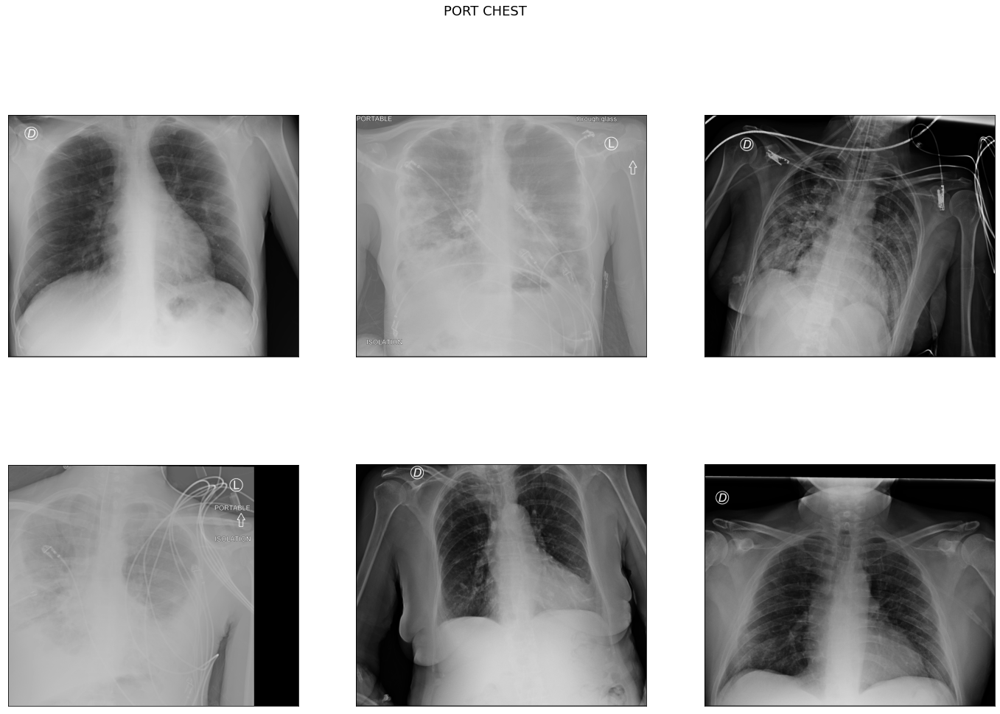

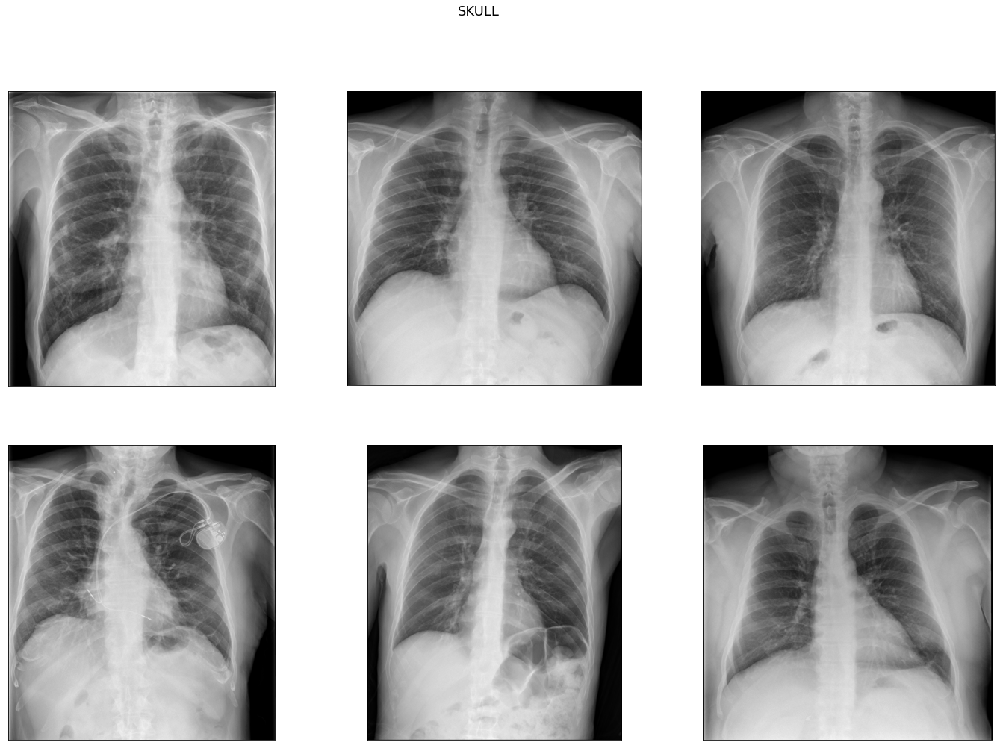

In [ ]:
body_parts = dm.loc[~dm['Body Part Examined'].isin(['CHEST', 'TORAX','THORAX', 'T?RAX',
                                                     'TÒRAX','PECHO', 'Pecho'])]
gb = body_parts.join(image_df).groupby('Body Part Examined')
for name, group in gb:
    fig = show_dicoms(group.sample(6, random_state=4), 3, 8)
    fig.suptitle(name, fontsize=18)
    plt.show()

The `ABDOMEN` images seem to contain the body's lower part too. Besides that, there does not seem to be a significant difference between the images group (in particular, we have no `SKULL`s here).


Now we can inspect the difference between images in the same study.

In [ ]:
np.random.seed(1234)
mi_study_ids = np.random.choice(multiple_images.study_id.unique(), 10)

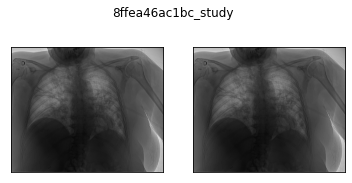

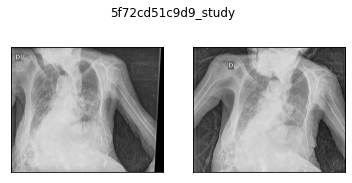

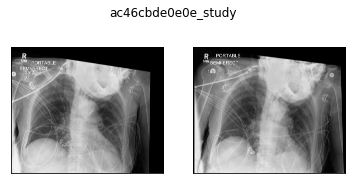

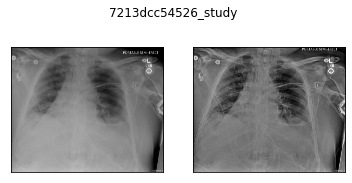

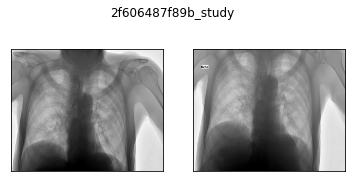

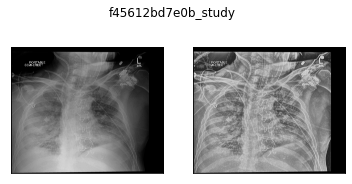

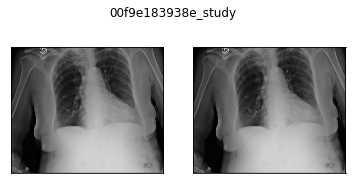

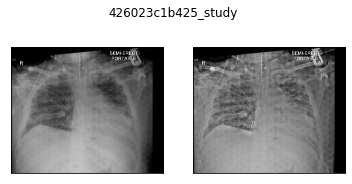

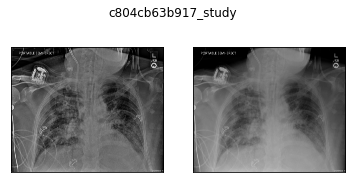

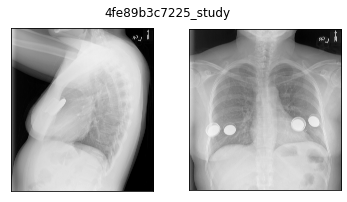

In [ ]:
for study_id in mi_study_ids:
    imgs = image_df.loc[image_df.study_id == study_id]
    fig = show_dicoms(imgs, imgs.shape[0], 3)
    fig.suptitle(study_id)

It can be seen that images in the same sometimes identical or almost identical, sometimes the only difference is in the image post-processing (croping, lighting, etc.) and in few cases the study contains an additional image from aother point of view. 

## Evaluation

The evaluation at the study level could be quite simple: we only have to check the prediction accuracy. 

But at the image level, the predictions will be bounding boxes. Probably the bounding boxes will not match exactly to the labeled ones, and we do not care if there are minor differences. So how will we decide whether our predictions are consistent with the labels or not?
Come to think of it, the most important thing here is how much our predictions area intersect with the ground truth labels. For ideal prediction, the predicted area will match the ground truth exactly. Meaning, the intersection and the area of each prediction and the ground truth are equals. In a more realistic case, our prediction isa bit smaller or larger than the ground truth, or span out in one direction and too short in another. In all these cases, the more the intersection area is large with respect to both the predicted area and the ground truth label area, the more we can regard the prediction as correct. This is the rationale behind the PASCAL VOC2010 IoU (Intersection over Union) evaluation method, which is used in this competition: a bounding box prediction is considered correct if the rate of the intersection over union of  the prediction and the ground truth is greater than $0.5$. i.e, we demand
$$IoU = \frac{A_y \cap A_\hat{y}}{A_y \cup A_\hat{y}} > 0.5$$  
Where $A_y$ is the ground truth bounding box area and $A_\hat{y}$ is the area of the predicted box.

But deciding whether a predicted bounding box matches to a target bounding box is not enough. Since there is varing number of bounding boxes in each image. So we have to find a way to evaluate how far the predicted set of bounding boxes from the targets. Of course, we could regard each of redundant bounding box as a false prediction, and than calculate the accuracy over all the predictions. But this way has a sgnificant drawbacks: In this way, must predict exactly the target labels, at 100% confidence. Unlike regular classification task, where the model gives scores for each class so we can interpret not only the chosen class, but also the probablities for all other classes, here the model cannot estimate different options. The model have to predict only the most cofident boxes. But somtimes we want to get a wider view. For example, we may want to minimize the false negative detections by take in account all the bounding boxes that may contain specific class under some confidence threshold. For this reason, VOC dedmonstrate a dedicated metric called Mean Avererage Precision, or mAP. The main idea behind this metric is to consider first each of the classes to be detected seperatle, as binray classification against all other classes. Then we have to calculate te average precision of this binary classification.
In average precision we sort the prediction by their confidence score. Now for a given recall $r$, check which confidence threshold we have to set in order to get this recall, and then we calculate the precision of the prediction above this threshold. The average precision is the average precison over the recall segment $[0, 1]$. The mean average precision then calculate as the mean of the average precision of each class.

In order to use the same evaluation method for the study label and for the image level, the competiton hosts decided to use this method also for the classification method. This means that instead of predicting one class for each study case, we have to give a score for each of classes. The main meaning of this is that the predictions of each class are not dependent.

# Training a Model

## Study Level

### Baseline model
In this project I choose fastai as the main library. Fastai is a framework built upon Pytorch and provides easy and fast way to build ANN models.

As a baseline model we will take the most simple resnet, trained as recommanded as base standard by fastai - using the largest batch size fisible. Fastai also recommended to use their LR finder to determind the learning rate, but my experiments in this dataset show that using Adam (fastai default optimizer) and one cycle policy, anything in the range $1e-2$ - $1e-3$ works well, and this is more or less the value given by the LR finder. Thus, I set the One Cycle `max_lr` parameter to $1e-3$ for all the following experiments.

For the baseline we want to keep the model and the training and prediction process fast and simple in terms of computational resources, so we will resize the images resolution to 256$\times$256.

At first, let's install the latest version of fastai.

In [ ]:
%pip install fastai --upgrade 1>/dev/null

For training a model, it's much more convient and efficient to convert the DICOM files to JPEG. This will also allow us to work on Colab kernels instead of kaggle kernel, which allow free GPU usage and more convient environment. Some kagglers already did it and created several datasets with JPEGs from different resolutions. For the training process we will use a set of dataset created by a kaggler called [Awsaf](https://www.kaggle.com/awsaf49) who created three dataset for resolutions of 256, 512, 1024.


Here I attached the colab to my google drive on order to copy my kaggle credentials and downloaded those dataset:

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

!pip uninstall kaggle -y
!pip install kaggle

!mkdir -p /root/.kaggle/
!cp /content/gdrive/MyDrive/kaggle/kaggle.json /root/.kaggle/
for size in [256, 512, 1024]:
    !kaggle datasets download -d awsaf49/siimcovid19-$size-jpg-image-dataset
    !unzip -o siimcovid19-$size-jpg-image-dataset.zip -d jpeg-$size/ 1>/dev/null

Mounted at /content/gdrive
Found existing installation: kaggle 1.5.12
Uninstalling kaggle-1.5.12:
  Successfully uninstalled kaggle-1.5.12
     |████████████████████████████████| 58 kB 4.3 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73051 sha256=e846db162749aa8f560f948c1002873a614079446ce8178339938ca028df5ba5
  Stored in directory: /root/.cache/pip/wheels/62/d6/58/5853130f941e75b2177d281eb7e44b4a98ed46dd155f556dc5
Successfully built kaggle
 92% 121M/132M [00:01<00:00, 117MB/s] 
100% 132M/132M [00:01<00:00, 122MB/s]
 95% 417M/439M [00:03<00:00, 141MB/s]
100% 439M/439M [00:03<00:00, 138MB/s]
 99% 1.46G/1.48G [00:11<00:00, 136MB/s]
100% 1.48G/1.48G [00:11<00:00, 139MB/s]


Beside the imports, we have here the `random_seed` function I took from kaggle, which sets the random seed to python random functions, numpy, torch and cuda. Using this function with constant seed is very useful for the reproducibility of thק experiments.

In [ ]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from pathlib import Path
from joblib import Parallel, delayed
from ast import literal_eval

import PIL

from tqdm.auto import tqdm
from matplotlib import pyplot as plt
import matplotlib.patches as patches


import warnings
warnings.filterwarnings("ignore", category=UserWarning)

def random_seed(seed_value):
    import random 
    random.seed(seed_value) # Python
    import numpy as np
    np.random.seed(seed_value) # cpu vars
    import torch
    torch.manual_seed(seed_value) # cpu  vars
    
    if torch.cuda.is_available(): 
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value) # gpu vars
        torch.backends.cudnn.deterministic = True  #needed
        torch.backends.cudnn.benchmark = False


From now we will use the `train.csv` file that comes with the jpeg files dataset, which maps each image id to its study id, boxes, and the classes columns for this study from the study level file. We will merge the DICOM_meta dataframe we have created in the EDA to this table, so we will have all the necessary data in one table.

In [ ]:
seed = 850

path = Path('/content/jpeg-256/')

train_df = pd.read_csv(path/'train.csv')
train_df['study_label'] = train_df[['Negative for Pneumonia', 'Typical Appearance', 'Indeterminate Appearance', 'Atypical Appearance']].idxmax(1)
train_df['image_fn'] = train_df['image_id'] +  '.jpg'

dm = pd.read_csv('/content/gdrive/MyDrive/covid19-detection/data/DICOM_metadata.csv', index_col=0)
dm.index = dm.index.str.extract('([^_]*)_')
dm.index = dm.index.map(lambda x : x[0])
train_df = train_df.merge(dm, left_on='image_id', right_index=True)
train_df.head()

,boxes,label,StudyInstanceUID,image_id,Negative for Pneumonia,Typical Appearance,Indeterminate Appearance,Atypical Appearance,filepath,study_label,image_fn,Image Type,Modality,Body Part Examined,Photometric Interpretation,Patient Sex,Imager Pixel Spacing,Rows,Columns
0,"[{'x': 789.28836, 'y': 582.43035, 'width': 102...",opacity 1 789.28836 582.43035 1815.94498 2499....,5776db0cec75,000a312787f2,0,1,0,0,/kaggle/input/siim-covid19-detection/train/577...,Typical Appearance,000a312787f2.jpg,"['ORIGINAL', 'PRIMARY']",DX,CHEST,MONOCHROME2,M,"[0.1, 0.1]",3488,4256
1,NaN,none 1 0 0 1 1,ff0879eb20ed,000c3a3f293f,1,0,0,0,/kaggle/input/siim-covid19-detection/train/ff0...,Negative for Pneumonia,000c3a3f293f.jpg,"['ORIGINAL', 'PRIMARY']",CR,CHEST,MONOCHROME2,M,"[0.15, 0.15]",2320,2832
2,"[{'x': 677.42216, 'y': 197.97662, 'width': 867...",opacity 1 677.42216 197.97662 1545.21983 1197....,9d514ce429a7,0012ff7358bc,0,1,0,0,/kaggle/input/siim-covid19-detection/train/9d5...,Typical Appearance,0012ff7358bc.jpg,"['DERIVED', 'PRIMARY']",DX,PORT CHEST,MONOCHROME2,F,"[0.139, 0.139]",2544,3056
3,"[{'x': 2729, 'y': 2181.33331, 'width': 948.000...",opacity 1 2729 2181.33331 3677.00012 2785.33331,28dddc8559b2,001398f4ff4f,0,0,0,1,/kaggle/input/siim-covid19-detection/train/28d...,Atypical Appearance,001398f4ff4f.jpg,"['DERIVED', 'PRIMARY', 'POST_PROCESSED', 'RT',...",CR,CHEST,MONOCHROME1,F,"[0.1, 0.1]",3520,4280
4,"[{'x': 623.23328, 'y': 1050, 'width': 714, 'he...",opacity 1 623.23328 1050 1337.23328 2156 opaci...,dfd9fdd85a3e,001bd15d1891,0,1,0,0,/kaggle/input/siim-covid19-detection/train/dfd...,Typical Appearance,001bd15d1891.jpg,"['ORIGINAL', 'PRIMARY']",DX,CHEST,MONOCHROME1,M,"[0.125, 0.125]",2800,3408


First we have to split our data to training and validation sets. Fastai porvides their own splitter in their dataloaders creator, but their splitter is not stratified, and that is important especialy in such imbalanced data, so we will use the sklearn splitter. Another reason to use sklearn is that we have in some cases several images in single study. These images are highly correlated and sometimes almost identical, so to prevent data leakage we want to split the data according the study id so that all the images of same study will be in the same split.

In [ ]:
from sklearn.model_selection import train_test_split
train_rows, val_rows = train_test_split(train_df.StudyInstanceUID, train_size=.8, stratify=train_df.study_label, random_state=seed)
train_df['valid'] = train_df.StudyInstanceUID.isin(val_rows)

The first thing to do is creating dataloaders to load the training and validation data into the model. For now, the only transform we want to apply on the data is resizing the images to 256$\times$256. To save time and resources, we will use here pre-resized images instead of insert the resizing into the dataloader pipeline. Since we want to use imagenet pretrained weights, we need also to normalize the data to imagenet stats, but fastai will take care of this automatilcally.

In [ ]:
from fastai.vision.all import *

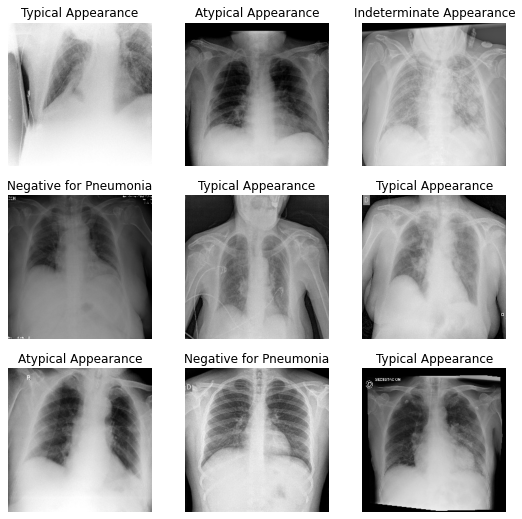

In [ ]:
dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=128, seed=seed,
                               valid_col='valid')
dls.show_batch()

Once we have the dataloaders, we can create and train the baseline model.

In [ ]:
metrics = [accuracy]

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=metrics)

Downloading: "                                                         " to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

We will run here LR finder to show that it indeed found a value in the range $(1e-2, 1e-3)$ as described above.

SuggestedLRs(valley=0.001737800776027143)

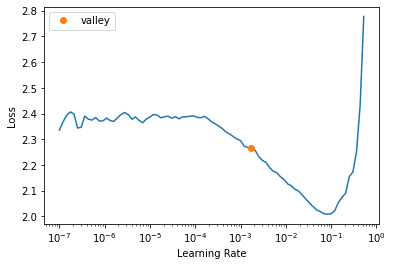

In [ ]:
random_seed(seed)
learn.lr_find()

In [ ]:
lr = 1e-3

In [ ]:
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.136939,1.627712,0.363703,00:13
1,1.839005,1.277387,0.551065,00:13
2,1.568370,1.193293,0.554004,00:13
3,1.328974,1.166894,0.556943,00:13
4,1.146452,1.170350,0.570904,00:13
5,1.003107,1.156454,0.575312,00:13
6,0.913112,1.152748,0.578251,00:13
7,0.817919,1.158333,0.581190,00:13
8,0.776223,1.159912,0.585599,00:13
9,0.751702,1.157146,0.587803,00:13


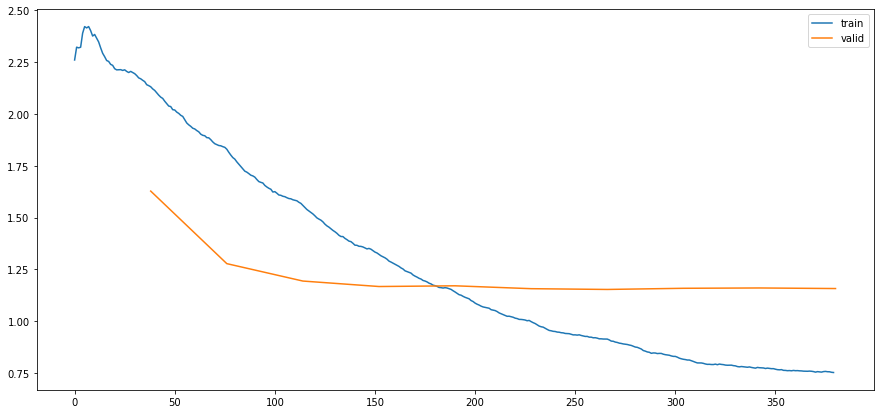

In [ ]:
learn.recorder.plot_loss(skip_start=False)

The model achive about 0.6 accuracy on the first few epochs, and then stop to progress. Looking as the train loss against the validation loss in the training log and in the above plot, we can see that the model starts to overfit from the 4-5th epoch.

### Data Augmenations

To prevent the overfitting we will apply data augmentation transforms. Fastai provides `aug_transforms` method which unite handfull of image transformations like roations, flips, zooming in and out and others. From the images printed above, we can see that some of the images are rotated by about 15 degrees, so we wil set the rotation max degrees to 15. The other defaults of the mehtod `aug_transforms` seems to be appropriate for our data.

Here the new dataloader, configured with the augmentation transforms:

/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:1023: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  /pytorch/aten/src/ATen/native/BatchLinearAlgebra.cpp:760.)
  ret = func(*args, **kwargs)


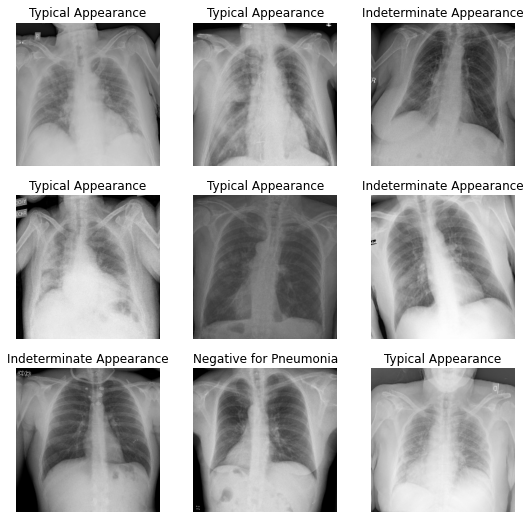

In [ ]:
dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(max_rotate=15))
dls.show_batch()

We will use now this dataloaders to retrain the model:

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=metrics)
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.172095,1.634977,0.389420,00:14
1,1.880736,1.537730,0.493755,00:14
2,1.684923,1.188444,0.566495,00:14
3,1.498345,1.184727,0.573843,00:14
4,1.359698,1.114470,0.578251,00:14
5,1.257719,1.068544,0.606172,00:14
6,1.181332,1.074996,0.596620,00:14
7,1.130962,1.051476,0.600294,00:14
8,1.100617,1.057825,0.598824,00:14
9,1.084826,1.054806,0.602498,00:14


The augmentations prevented the overfitting and the result imporved. But at the last epoch the training loss get very close to the validation loss, so that the overfitting is still one or two epochs ahead. Below the model is trained for more 3 epochs, so we can see it overfits. 

In [ ]:
learn.fit_one_cycle(3)

epoch,train_loss,valid_loss,accuracy,time
0,1.074882,1.093471,0.598090,00:14
1,1.059054,1.037730,0.610580,00:14
2,1.027459,1.033620,0.603233,00:14


We need a stronger augemtations in order to be able to train more epochs:

/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:1023: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  /pytorch/aten/src/ATen/native/BatchLinearAlgebra.cpp:760.)
  ret = func(*args, **kwargs)


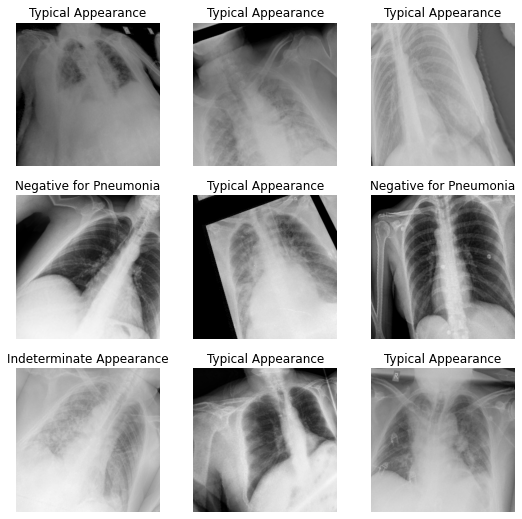

In [ ]:
dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
dls.show_batch()

Now the transforms are much stronger. Let's try this.

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=metrics)
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.279873,1.854448,0.337252,00:15
1,1.963356,1.389864,0.507715,00:15
2,1.760644,1.269570,0.557678,00:15
3,1.584370,1.156144,0.598090,00:15
4,1.448000,1.114058,0.598090,00:15
5,1.346394,1.093533,0.586334,00:15
6,1.275903,1.077571,0.594416,00:15
7,1.215048,1.052689,0.598090,00:15
8,1.188088,1.052382,0.600294,00:15
9,1.160785,1.050861,0.601029,00:15


Much better. Now we can continue the training.

In [ ]:
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.153651,1.029901,0.600294,00:15
1,1.134104,1.048217,0.601029,00:15
2,1.123916,1.013362,0.610580,00:15
3,1.102736,1.002486,0.604702,00:15
4,1.067288,0.990958,0.606172,00:15
5,1.040623,1.012678,0.602498,00:15
6,1.027421,0.977302,0.623071,00:15
7,1.012243,0.981503,0.618663,00:15
8,1.004729,0.983442,0.617193,00:15
9,0.994905,0.986293,0.618663,00:15


We achived a stable result of ~ .62 accuracy on last epochs. 

Let's now try to add different type of augmentation - mixup augmentation. In mixup augmentaion we mixing in some probablity two images from the batch. Of course, we need also to mix their labels as well - if we took .75 from negative image and .25 from typical image, we need to label the mixed image as .75 negative and .25 typical. From technical reasons, in fastai this method implemented as a callback in the Learner object.

We will also add a save model callback to save the best accurate model during this training.

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname='resnet18', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.221637,1.648123,0.347539,00:14
1,2.033317,1.310811,0.484203,00:14
2,1.797587,1.217643,0.560617,00:14
3,1.631773,1.133407,0.574578,00:14
4,1.518408,1.117549,0.579721,00:14
5,1.419377,1.069009,0.592212,00:14
6,1.337978,1.061508,0.585599,00:14
7,1.286495,1.047750,0.610580,00:14
8,1.254207,1.040178,0.610580,00:14
9,1.244091,1.039126,0.608376,00:14


Better model found at epoch 0 with accuracy value: 0.347538560628891.
Better model found at epoch 1 with accuracy value: 0.4842028021812439.
Better model found at epoch 2 with accuracy value: 0.560617208480835.
Better model found at epoch 3 with accuracy value: 0.5745775103569031.
Better model found at epoch 4 with accuracy value: 0.5797207951545715.
Better model found at epoch 5 with accuracy value: 0.5922116041183472.
Better model found at epoch 7 with accuracy value: 0.6105804443359375.


In [ ]:
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.225691,1.043782,0.606907,00:14
1,1.224334,1.050711,0.610580,00:14
2,1.214372,1.060318,0.579721,00:14
3,1.181578,1.040388,0.600294,00:14
4,1.152836,1.014057,0.625276,00:14
5,1.132918,1.014307,0.621602,00:14
6,1.121463,0.999287,0.617928,00:14
7,1.111305,0.991048,0.623806,00:14
8,1.103899,0.987156,0.627480,00:14
9,1.096164,0.988859,0.623071,00:14


Better model found at epoch 4 with accuracy value: 0.6252755522727966.
Better model found at epoch 8 with accuracy value: 0.6274797916412354.


We still far enough from overfitting, so we can continue.

In [ ]:
learn.fit_one_cycle(20, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.091953,0.991541,0.620132,00:14
1,1.098029,0.999595,0.619398,00:14
2,1.082786,0.994576,0.621602,00:14
3,1.092197,0.994829,0.623806,00:14
4,1.088647,1.035866,0.598824,00:14
5,1.087988,1.007794,0.617193,00:14
6,1.078389,0.978019,0.618663,00:14
7,1.077155,0.976289,0.623071,00:14
8,1.073659,0.987944,0.620132,00:14
9,1.064534,0.990782,0.621602,00:14


Better model found at epoch 12 with accuracy value: 0.6362968683242798.


epoch,train_loss,valid_loss,accuracy,time
0,1.091953,0.991541,0.620132,00:14
1,1.098029,0.999595,0.619398,00:14
2,1.082786,0.994576,0.621602,00:14
3,1.092197,0.994829,0.623806,00:14
4,1.088647,1.035866,0.598824,00:14
5,1.087988,1.007794,0.617193,00:14
6,1.078389,0.978019,0.618663,00:14
7,1.077155,0.976289,0.623071,00:14
8,1.073659,0.987944,0.620132,00:14
9,1.064534,0.990782,0.621602,00:14


Seems that we got the best we can achieve from this model. 

Now we have a model we can export and make a submission on kaggle for the competition. The score of the model will be less then it's accuracy, mainly because in the competition we have to predict opacities bounding boxes on the image level, and we didn't develop it yet. But the score still can be used to compare between models.

Let's load the best model and export it.

In [ ]:
learn.load('resnet18')
learn.export('resnet18.pkl')

/usr/local/lib/python3.7/dist-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


The submission of this model got score of `0.322` public leaderboard. 

This score makes sense, since about 50% of the score come from the image level, so score of 0.32 match to 0.63 accuracy of the model.

### Deeper Resnet Architectures

Let's try now deeper versions of resnet. The next resnet version on pytorch model zoo is resnet34. Using this architecture will force us to reduce the batch size, because the 128 batch size will overflow the Colab GPU memory capacity for this architecture.

In [ ]:
dls34 = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=64, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
learn34 = cnn_learner(dls34, resnet34, metrics=metrics, cbs=[MixUp()])
random_seed(seed)
learn34.fit_one_cycle(10, lr)
learn34.fit_one_cycle(10, lr)
learn34.fit_one_cycle(10, lr)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

epoch,train_loss,valid_loss,accuracy,time
0,2.234765,1.504851,0.443791,00:25
1,1.919579,1.372733,0.498898,00:25
2,1.623830,1.188850,0.560617,00:25
3,1.420471,1.089587,0.582660,00:25
4,1.277785,1.084268,0.586334,00:25
5,1.227922,1.085220,0.578986,00:25
6,1.163226,1.076400,0.598090,00:25
7,1.144382,1.058939,0.601763,00:25
8,1.124791,1.058929,0.592946,00:25
9,1.120825,1.044490,0.597355,00:25


epoch,train_loss,valid_loss,accuracy,time
0,1.132079,1.062200,0.590007,00:25
1,1.119061,1.082659,0.592212,00:25
2,1.131198,1.113467,0.565760,00:25
3,1.122201,1.122275,0.565760,00:25
4,1.094373,1.031081,0.603968,00:25
5,1.078759,1.060769,0.595885,00:25
6,1.076960,1.026844,0.603233,00:25
7,1.065849,1.019088,0.601763,00:25
8,1.058897,1.031228,0.597355,00:25
9,1.059524,1.028008,0.599559,00:25


epoch,train_loss,valid_loss,accuracy,time
0,1.060321,1.028187,0.595151,00:25
1,1.063604,1.044466,0.596620,00:25
2,1.055629,1.075485,0.587803,00:25
3,1.069100,1.013106,0.603968,00:25
4,1.056794,1.013758,0.597355,00:25
5,1.057729,1.017473,0.604702,00:25
6,1.047425,0.990069,0.611315,00:25
7,1.043572,1.028464,0.600294,00:25
8,1.031379,1.028275,0.598824,00:25
9,1.031109,1.035032,0.597355,00:25


The deeper model did worse than the simpler, maybe because the smaller batch size. I tried to train deeper versions of resnet than resnet34 with different learning rates and batch size and for different number of epochs, but all the experiments give even worth results, I cannot find any reason. 

Although not represented here, experiments with other architectures like densenet and efficientnet gave similar results to resnet18 and resnet34. On kaggle I found A training notebook for Efficientnet B7 on TPU with accuracy of about 0.65, but when I tried to replicate the training on Google Colab I found that for colab TPU I have to reduce the batch size by half, what cause drop in the accuracy again to something about 0.62-0.63 

### Higher Image Resolutions


We started with 256 image size, but maybe the model can give more accurate results with larger image size. . When increasing the resolution we again have to reduce the batch size to match the GPU mermory capacity. So we will set the bach size to 64 for 512 image size and to 16 for 1024 image size.

In [ ]:
dls512 = ImageDataLoaders.from_df(train_df, '/content/jpeg-512/train', fn_col='image_fn', label_col='study_label', bs=64, seed=seed, valid_col='valid',
                               batc_ftms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.4
                                ))
learn512 = cnn_learner(dls512, resnet18, metrics=[accuracy], cbs=[MixUp])

In [ ]:
random_seed(seed)
learn512.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.072881,1.505724,0.419544,00:50
1,1.788971,1.194337,0.570904,00:50
2,1.502423,1.119591,0.584129,00:50
3,1.307556,1.115712,0.565026,00:50
4,1.171192,1.050063,0.597355,00:50
5,1.095508,1.047778,0.601029,00:50
6,1.049296,1.032640,0.598824,00:50
7,1.018584,1.024428,0.602498,00:50
8,0.995111,1.019536,0.603968,00:50
9,0.983949,1.020884,0.606172,00:50


In [ ]:
learn_512.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,0.990704,1.017819,0.607641,00:50
1,0.992012,1.045582,0.588538,00:50
2,1.014551,1.000568,0.619398,00:50
3,1.000638,1.019743,0.614254,00:50
4,0.973878,1.034835,0.600294,00:50
5,0.952693,1.013431,0.602498,00:50
6,0.915152,1.006195,0.605437,00:50
7,0.901263,1.011025,0.615724,00:50
8,0.875014,1.005544,0.620132,00:50
9,0.871610,1.006065,0.615724,00:50


In [ ]:
dls_1024 = ImageDataLoaders.from_df(train_df, '/content/jpeg-1024/train', fn_col='image_fn', label_col='study_label', bs=16, seed=seed, valid_col='valid',
                               batc_ftms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.4
                                ))
random_seed(seed)
learn_1024 = cnn_learner(dls_1024, resnet18, metrics=[accuracy], cbs=[MixUp])
learn_1024.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.900838,1.355854,0.487877,03:22
1,1.506670,1.193257,0.560617,03:22
2,1.269001,1.109861,0.563556,03:22
3,1.140289,1.043220,0.595885,03:22


epoch,train_loss,valid_loss,accuracy,time
0,1.900838,1.355854,0.487877,03:22
1,1.506670,1.193257,0.560617,03:22
2,1.269001,1.109861,0.563556,03:22
3,1.140289,1.043220,0.595885,03:22
4,1.107860,1.054133,0.599559,03:22
5,1.049287,1.002251,0.622337,03:22
6,1.045195,0.980898,0.628949,03:22
7,1.034131,0.971386,0.630419,03:22
8,0.981983,0.976748,0.631888,03:22
9,0.961620,0.976762,0.631888,03:22


In [ ]:
learn_1024.fit_one_cycle(10, lr)

The increasing of the image resolution doesn't improve the model accuracy significantly.
We will stay with resnet18 and image size of 256

### Result Examining

Let's now examine the model results.

The accuracy is about 0.6. But we have 4 classes, so for better understanding the accuracy performance let's see the confusion matrix.

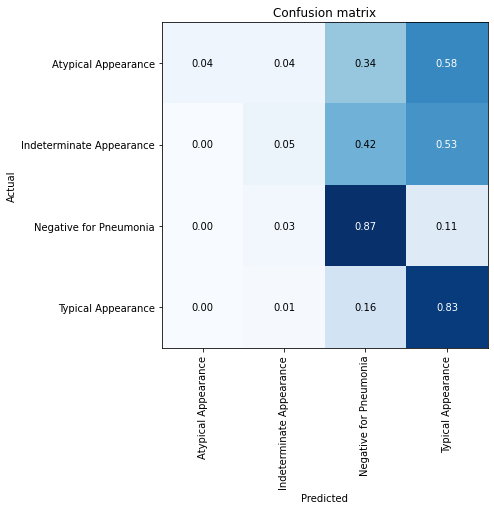

In [ ]:
learn.load('resnet18')
intrep = ClassificationInterpretation.from_learner(learn)
intrep.plot_confusion_matrix(True, figsize=(7,7))

In [ ]:
intrep.print_classification_report()

                          precision    recall  f1-score   support

     Atypical Appearance       0.80      0.04      0.08       100
Indeterminate Appearance       0.40      0.05      0.08       254
  Negative for Pneumonia       0.56      0.87      0.68       357
      Typical Appearance       0.70      0.83      0.76       650

                accuracy                           0.64      1361
               macro avg       0.61      0.45      0.40      1361
            weighted avg       0.61      0.64      0.56      1361



The model accuracy on Typical and Negative classes is quite good, but on Indeterminate and on Atypical the accuracy is very poor. The recall is very low, meaning that the model in fact cannot determine atypical and inderminate cases at all. 

Let's look at the results:

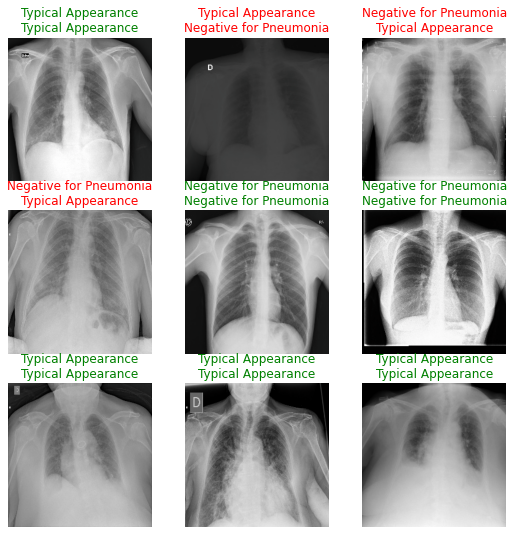

In [ ]:
learn.show_results()

These results don't mean anything to me, since I cannot read those CXRs. Ploting the opacity bounding boxes on the XRays may help to understand the results.

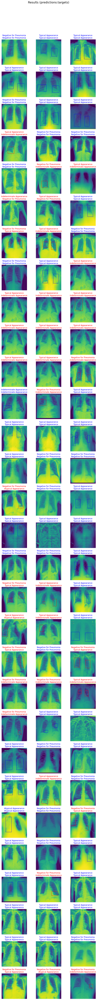

In [ ]:
results_items = train_df[train_df.valid]#dls.valid.items.sample(30)
res_dl = dls.test_dl(results_items)
_,_,preds = learn.get_preds(dl=res_dl, with_decoded=True)
fig, ctxs = plt.subplots(30, 3, figsize=(9,90))
fig.suptitle('Results (predictions:targets)', size=18)
for ax, pred, (index, item) in zip(ctxs.flatten(), preds, results_items.iterrows()):
    ax.imshow(PIL.Image.open(path/'train'/item.image_fn))
    ax.set_axis_off()
    pred_class = dls.vocab[pred]
    color = 'b' if pred_class == item.study_label else 'r'
    ax.set_title(f'{pred_class}\n{item.study_label}', fontdict=dict(color=color))

    if isinstance(item.boxes, str):
        for box in literal_eval(item.boxes):
            w_scale = 256/item.Columns
            h_scale = 256/item.Rows
            rect = patches.Rectangle((box['x']*w_scale, box['y']*h_scale), 
                                    box['width']*w_scale, box['height']*h_scale,
                                    color=color, linewidth=1, fill=False)
            ax.add_patch(rect)
# learn.show_results(dl=res_dl, ctxs=ctxs.flatten(), max_n=30)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])


Generally speaking, we can see that when the opaciy area are small or asymmetric, the model tends to missclassify the image.

To better understanding the model's desicions, I tried to use Grad-Cam method, in which we comuting the gradient of the loss w.r.t the last convolutional layer and upsampling it to the original image size to obtain a heatmap that can show us the importance of ech part of the image in the model decision. Here the gard-cam heatmaps from 5 samples for each study class, with the finding bounding boxes plotted too. The predicted classes ploted above the images, red-colored for wrong classification.

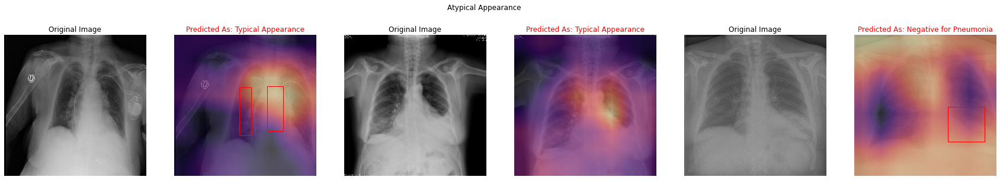

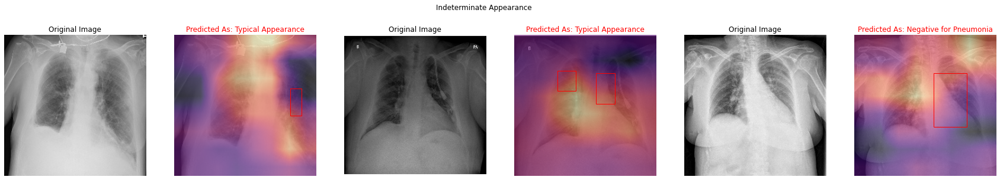

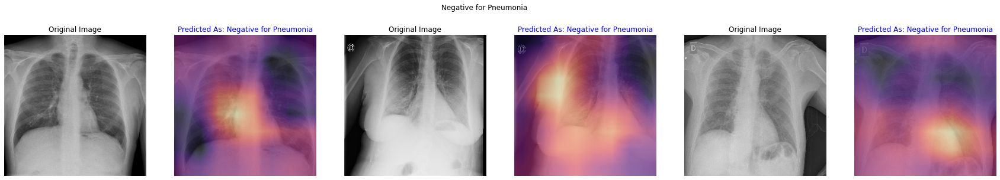

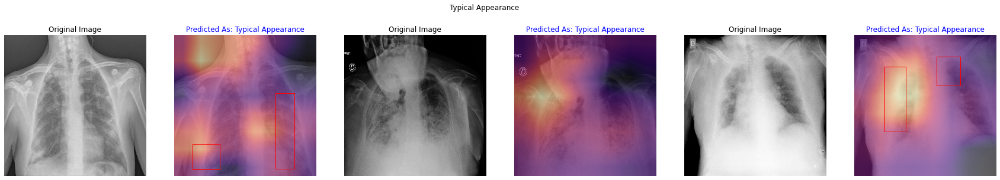

In [ ]:
class Hook():
    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_func)   
    def hook_func(self, m, i, o): self.stored = o.detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()
    
class HookBwd():
    def __init__(self, m):
        self.hook = m.register_backward_hook(self.hook_func)   
    def hook_func(self, m, gi, go): self.stored = go[0].detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()

for cls in ['Atypical Appearance', 'Indeterminate Appearance', 'Negative for Pneumonia', 'Typical Appearance']:
    samples = train_df.loc[train_df.valid & (train_df.study_label==cls)].sample(3, random_state=123)
    figure ,axes = plt.subplots(1, 6, figsize=(30,5))
    axes = axes.reshape((3,2))
    figure.suptitle(cls)
    for (idx, item), (org_ax, ax) in zip(samples.iterrows(), axes):
        img = PILImage.create(path/'train'/item.image_fn)
        org_ax.imshow(img)
        org_ax.set_title('Original Image')
        org_ax.set_axis_off()

        x, = first(dls.test_dl([img]))
        cls_idx = dls.vocab.o2i[cls]
        learn.model.to('cuda')

        with HookBwd(learn.model[0]) as hookg:
            with Hook(learn.model[0]) as hook:
                output = learn.model.eval()(x.cuda())
                act = hook.stored
                predicted_class = dls.vocab[output.detach().cpu().numpy().argmax()]
            output[0,cls_idx].backward()
            grad = hookg.stored

        w = grad[0].mean(dim=[1,2], keepdim=True)
        cam_map = (w * act[0]).sum(0)

        x_dec = TensorImage(dls.train.decode((x,))[0][0])
        x_dec.show(ctx=ax)
        color = 'b' if cls == predicted_class else 'r'
        ax.set_title('Predicted As: '+ predicted_class, color=color)
        ax.imshow(cam_map.detach().cpu(), alpha=0.6, extent=(0,224,224,0),
                    interpolation='bilinear', cmap='magma');
        if isinstance(item.boxes, str):
            for box in literal_eval(item.boxes):
                w_scale  = ax.get_xlim()[1]/item.Columns
                h_scale = ax.get_ylim()[0]/item.Rows
                rect = patches.Rectangle((box['x']*w_scale, box['y']*h_scale), 
                                        box['width']*w_scale, box['height']*h_scale,
                                        color='r', linewidth=1, fill=False)
                ax.add_patch(rect)
    plt.show()

The results are very confusing. The image's parts that are most important to the model are not related to the finding boxes, and sometimes are out of the lungs, or even out of the body at all. Maybe we can do better if we can turn the model attention to the lungs. We will return to it later.

### Dataset Balancing

Regarding the small amount of data we have from Atypical and Indeterminate class, the model poor results on these label is not a big surprise. We can use oversampling balancing method to balance the data before the training. 

In [ ]:
def balance_df(df, target_col, valid_col=None):
    df = df.copy()
    if valid_col is not None:
        df_val = df.loc[df[valid_col]]
        df = df.loc[~df[valid_col]]
    target = df[target_col]
    max_count = target.value_counts().max()
    for cls in target.unique():
        cls_df = df.loc[df[target_col] == cls]
        while (df[target_col] == cls).sum() < max_count:
            df = df.append(cls_df.sample(min(max_count - (df[target_col] == cls).sum(), cls_df.shape[0])))
    if valid_col is not None:
        df = df.append(df_val)
    return df

btrain_df = balance_df(train_df, 'study_label', 'valid')
print('Samples counts on the training set:\n')
print(btrain_df[~btrain_df.valid].study_label.value_counts())
print('\n\n\nSamples counts on the validation set:\n')
print(btrain_df.loc[btrain_df.valid].study_label.value_counts())

Samples counts on the training set:

Indeterminate Appearance    2357
Negative for Pneumonia      2357
Atypical Appearance         2357
Typical Appearance          2357
Name: study_label, dtype: int64



Samples counts on the validation set:

Typical Appearance          650
Negative for Pneumonia      357
Indeterminate Appearance    254
Atypical Appearance         100
Name: study_label, dtype: int64


In [ ]:
dlsb = ImageDataLoaders.from_df(btrain_df, path/'train', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
learnb = cnn_learner(dls, resnet18, metrics=metrics, cbs=[MixUp(), SaveModelCallback(monitor='accuracy', fname='resnet18_balanced', reset_on_fit=True)],
                                                         path='/content/gdrive/MyDrive/covid19-detection/project-models/balanced')
random_seed(seed)
learnb.fit_one_cycle(10, lr)
learnb.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.219090,1.335968,0.482733,00:25
1,1.970201,1.304144,0.464364,00:25
2,1.714511,1.233654,0.471712,00:25
3,1.516757,1.151954,0.504041,00:25
4,1.408087,1.168786,0.506245,00:25
5,1.339128,1.118309,0.554004,00:25
6,1.309822,1.145051,0.523145,00:25
7,1.288998,1.144312,0.524614,00:25
8,1.283112,1.134314,0.538575,00:25
9,1.279155,1.127064,0.542983,00:25


Better model found at epoch 0 with accuracy value: 0.48273327946662903.
Better model found at epoch 3 with accuracy value: 0.5040411353111267.
Better model found at epoch 4 with accuracy value: 0.5062454342842102.
Better model found at epoch 5 with accuracy value: 0.554004430770874.


epoch,train_loss,valid_loss,accuracy,time
0,1.306818,1.141441,0.530492,00:25
1,1.301914,1.100895,0.565026,00:25
2,1.287177,1.182743,0.505511,00:25
3,1.279284,1.103523,0.546657,00:25
4,1.258687,1.143587,0.510654,00:25
5,1.250123,1.109319,0.521675,00:25
6,1.236958,1.103620,0.536370,00:25
7,1.227438,1.102438,0.542248,00:25
8,1.218653,1.108317,0.531962,00:25
9,1.217123,1.118696,0.531227,00:25


Better model found at epoch 0 with accuracy value: 0.5304923057556152.
Better model found at epoch 1 with accuracy value: 0.5650256872177124.


The accuracy is much lower comparing the former model. Let's look at the confusion matrix:

In [ ]:
learnb.load('/content/gdrive/MyDrive/covid19-detection/project-models/balanced/models/resnet18_balanced')

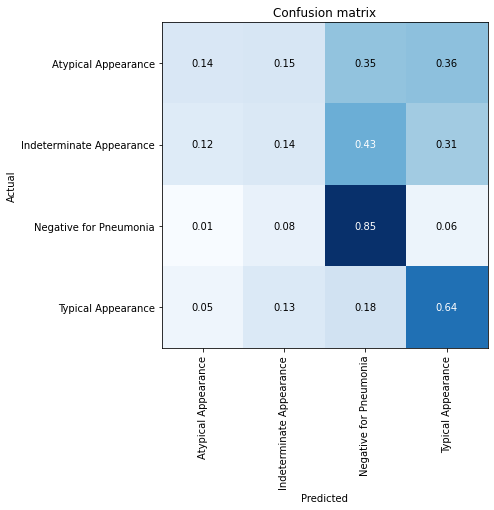

In [ ]:
intrepb = ClassificationInterpretation.from_learner(learnb)
intrepb.plot_confusion_matrix(True, figsize=(7, 7))

In [ ]:
intrep.print_classification_report()

                          precision    recall  f1-score   support

     Atypical Appearance       0.17      0.14      0.15       100
Indeterminate Appearance       0.21      0.14      0.17       254
  Negative for Pneumonia       0.54      0.85      0.66       357
      Typical Appearance       0.75      0.64      0.69       650

                accuracy                           0.57      1361
               macro avg       0.42      0.44      0.42      1361
            weighted avg       0.55      0.57      0.55      1361



Now the model is much more accurate on atypical, but it comes on expence of the typical class. Seems that the decision between typical and atypical is too hard - when the dataset didn't contain much atipycals, the model could ignore them and be accurate on the typicals. But now that the dataset contains equal number of typicals and atypicals, the model accuracy drops.

Although the total accuarcy of the balanced model, we can use in the compietions it for scoring the atypical and indertminate classes. Since the evaluation method calculates the scores for each class independetly, we will use for each class the best model for that class.

In [ ]:
learn.load('resnet18_balanced')
learn.export('resnet18_balanced.pkl')

/usr/local/lib/python3.7/dist-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


Using this model to predict atypical and indeteminate classes give a score of 0.316 on the public LB. But if this model have better accuracy on the atypical and the indeteminate classes, How using it on this classes gave worse results? The answer is, the first model was better in estimating the probablity that image is atypical than the balanced model, but it give genrally more probaility for any image to be typical. But sorting the images by their atypical porbablity prediction, there are still more real atypical on the top of the list in the regular model than the balanced model.

The reason that the regular model is better than the balanced must be related to the oversampling in some way. Maybe the balanced model overfitted on the atypical and interminated duplicated images.


### Lungs Annotation

When examining the model results, we saw that the The model had a hard time recognizing small or assymetric findings. 
How can we help the model to determind them?
We already know that these fingings found only in the lungs part of the image. If we could annotate the lungs on the images and tell the model where the lungs are, instead exploring the whole image after findings, the model will pay more attention to the important part of the image and it may improve the results.

In kaggle, we can find a [this dataset](https://www.kaggle.com/nikhilpandey360/chest-xray-masks-and-labels) which contains CXRs and lung masks. We can use it to train a lungs detetctor, and create annotations for our dataset.

Let's download the dataset from kaggle:

#### Downloading and preparing the dataset:

In [ ]:
!kaggle datasets download -d nikhilpandey360/chest-xray-masks-and-labels
!unzip -o chest-xray-masks-and-labels.zip -d cxmal-ds/ 1>/dev/null

100% 9.56G/9.58G [01:54<00:00, 95.4MB/s]
100% 9.58G/9.58G [01:55<00:00, 88.9MB/s]


Some mask are missing.
We have to filter out all the CXRs which the dataset do not contains masks label for them. Beside that, we will givethe masks equal names like the CXR files (the original names have multiple formats):

In [ ]:
CXRs_path = Path('/content/cxmal-ds/Lung Segmentation/CXR_png/')
mask_path = Path('/content/cxmal-ds/Lung Segmentation/masks/')

CXRs_files = list(CXRs_path.glob('*.png'))
mask_files = list(mask_path.glob('*.png'))

import shutil
for fn in tqdm(mask_files):
    if fn.stem.endswith('_mask'):
        shutil.move(fn, fn.parent/(fn.stem[:-len('_mask')] + '.png'))
    
mask_files = list(mask_path.glob('*.png'))
mask_stems = [fn.stem for fn in mask_files]
CXRs_files = [fn for fn in CXRs_files if fn.stem in mask_stems]

  0%|          | 0/704 [00:00<?, ?it/s]

In the original dataset the lungs mask value is 255; i.e, the mask files contains 255 in the lungs region and 0 elsewere. Fastai desires the segmentation label for one class segemtation task to be 1, so we have to fix the masks.

In [ ]:
from joblib import Parallel, delayed
def format_mask(fn):
    mask = PIL.Image.open(fn)
    mask = np.array(mask)
    mask = mask != 0
    PIL.Image.fromarray(mask, mode='L').save(fn)
Parallel(n_jobs=-1)(delayed(format_mask)(fn) for fn in tqdm(mask_files));

  0%|          | 0/704 [00:00<?, ?it/s]

Let's show the data:

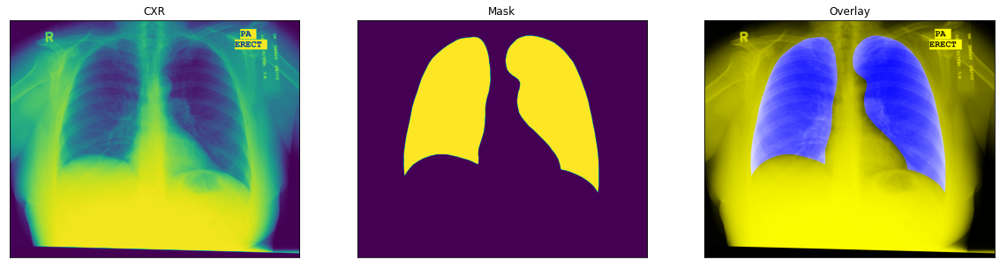

In [ ]:
i = random.randrange(len(CXRs_files))
plt.figure(figsize=(20,5))
cxr = plt.imread(CXRs_files[i])
mask = plt.imread(mask_files[i])

plt.subplot(1 , 3, 1)
plt.title('CXR')
plt.imshow(cxr)
plt.xticks([])
plt.yticks([])

plt.subplot(1 , 3, 2)
plt.title('Mask')
plt.imshow(mask)
plt.xticks([])
plt.yticks([])

plt.subplot(1 , 3, 3)
plt.title('Overlay')
plt.xticks([])
plt.yticks([])
                 
plt.imshow(np.array([cxr, cxr, mask*255]).transpose((1,2,0)))
    
plt.show()

Using this dataset we will train a lungs detector:

In [ ]:
def label_func(f): return mask_path/f.name

dls_lungs = SegmentationDataLoaders.from_label_func('/', CXRs_files, 
                                              label_func, 
                                              batch_size=32,
                                              seed=seed, 
                                              codes=['background', 'lung'], 
                                              item_tfms=Resize(256, pad_mode=PadMode.Zeros), 
                                              bacth_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.4
                                ) )

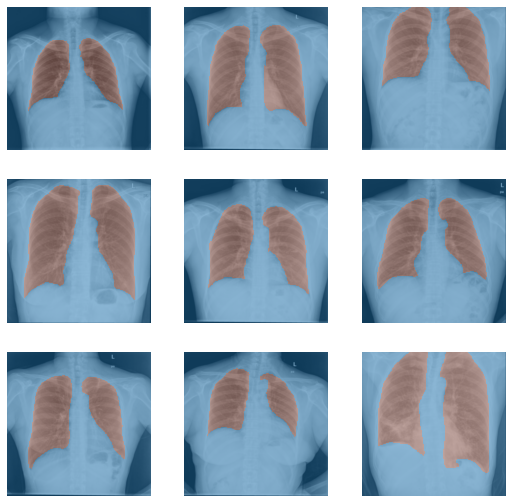

In [ ]:
dls_lungs.show_batch()

In [ ]:
lung_detector = unet_learner(dls_lungs, resnet18, metrics=[foreground_acc, Dice], cbs=[SaveModelCallback('dice')], 
                             path='/content/gdrive/MyDrive/covid19-detection/project-models/lungs-detector/resnet18')
random_seed(seed)
lung_detector.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,foreground_acc,dice,time
0,0.303297,0.164016,0.888558,0.913564,01:02
1,0.188742,0.090731,0.952972,0.947277,01:02
2,0.132844,0.065343,0.948718,0.956697,01:02
3,0.103328,0.058421,0.955897,0.960045,01:01
4,0.084565,0.057908,0.943713,0.960400,01:01
5,0.071709,0.056635,0.948708,0.961429,01:01
6,0.062960,0.057941,0.957891,0.960615,01:03
7,0.055589,0.060662,0.952709,0.962185,01:00
8,0.049958,0.060498,0.956056,0.961841,01:02
9,0.046046,0.061221,0.953470,0.962214,01:02


Better model found at epoch 0 with dice value: 0.9135644814803429.
Better model found at epoch 1 with dice value: 0.9472769527630406.
Better model found at epoch 2 with dice value: 0.9566971125950945.
Better model found at epoch 3 with dice value: 0.9600451633801982.
Better model found at epoch 4 with dice value: 0.9603999159352814.
Better model found at epoch 5 with dice value: 0.9614294932710088.
Better model found at epoch 7 with dice value: 0.9621849991371552.
Better model found at epoch 9 with dice value: 0.9622136592373838.


In [ ]:
lung_detector = unet_learner(dls_lungs, resnet18, metrics=[foreground_acc, Dice], 
                             path='/content/gdrive/MyDrive/covid19-detection/project-models/lungs-detector/resnet18')

lung_detector.load('model')

In [ ]:
lung_detector.export('resnet18_lung_detector')

Let's examine the model result on the main dataset:

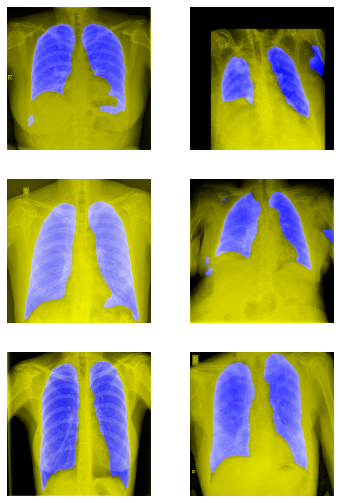

In [ ]:
def create_overlay(img, mask):
    img = PIL.Image.open(img)
    img = np.array(img)
    mask = mask.numpy()
    img = np.stack([img, img, mask*img.max()]).transpose((1,2,0))
    return img
tdl = lung_detector.dls.test_dl(get_image_files('/content/jpeg-256/train'))
items = tdl.items[:tdl.bs]
b = tdl.one_batch()
imgs, preds, _, masks = lung_detector.get_preds(dl=[b], with_input=True, with_decoded=True)
show_images([ create_overlay(fn, m) for fn ,m in zip(items[:6], masks[:6])], 3, 2)

Excellent. With this model we will create a new dateset of lungs-annotated CXRs.

In [ ]:
ann_cxr_path = Path('/content/ann_cxr')
ann_cxr_path.mkdir(exist_ok=True)

def save_annotated_image(fn, mask):
    img = np.array(PIL.Image.open(fn))
    mask *= 255
    
    img = np.stack([img, img, mask]).transpose([1,2,0]).astype(np.uint8)
    # print(img.dtype)
    PIL.Image.fromarray(img).save(ann_cxr_path/fn.name)

files = get_image_files('/content/jpeg-256/train')
tdl = lung_detector.dls.test_dl(files)
for i, b in enumerate(tqdm(tdl)):
    preds, _, masks = lung_detector.get_preds(dl=[b], with_decoded=True)
    # [save_annotated_image(fn, img, mask) for fn, img, mask in tqdm(zip(files, images, masks), total=len(files))]
    Parallel(n_jobs=-1)(delayed(save_annotated_image)(fn, mask) for fn, mask in zip(files[i*tdl.bs:(i+1)*tdl.bs], masks))

  0%|          | 0/198 [00:00<?, ?it/s]

In [ ]:
!zip -r lung_ann.zip /content/ann_cxr  1>/dev/null
!cp lung_ann.zip /content/gdrive/MyDrive/covid19-detection/

Now let's train a model using the lung annotated dataset:

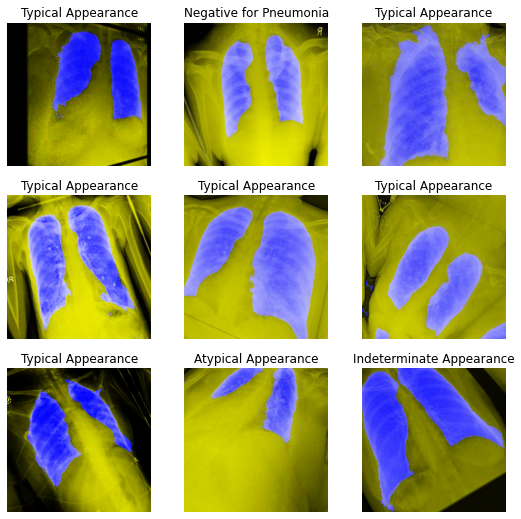

In [ ]:
dls = ImageDataLoaders.from_df(train_df, ann_cxr_path, fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
dls.show_batch()

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname='resnet18_lungs_ann', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,2.267499,1.435779,0.401176,00:15
1,2.001173,1.295355,0.487142,00:15
2,1.805714,1.129401,0.562087,00:15
3,1.619403,1.079148,0.587068,00:15
4,1.480217,1.062512,0.593681,00:15
5,1.383800,1.018543,0.609111,00:15
6,1.321221,1.020916,0.603233,00:15
7,1.280113,1.014218,0.603968,00:15
8,1.242893,1.012466,0.601029,00:15
9,1.222161,1.012224,0.599559,00:15


Better model found at epoch 0 with accuracy value: 0.4011756181716919.
Better model found at epoch 1 with accuracy value: 0.48714181780815125.
Better model found at epoch 2 with accuracy value: 0.5620867013931274.
Better model found at epoch 3 with accuracy value: 0.5870683193206787.
Better model found at epoch 4 with accuracy value: 0.5936810970306396.
Better model found at epoch 5 with accuracy value: 0.609110951423645.


In [ ]:
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.263959,1.010589,0.606907,00:15
1,1.249599,1.040149,0.591477,00:15
2,1.223314,0.994722,0.608376,00:15
3,1.198254,0.990495,0.616458,00:15
4,1.172536,0.996548,0.617193,00:15
5,1.137991,1.001128,0.617193,00:15


Better model found at epoch 3 with accuracy value: 0.6164584755897522.
Better model found at epoch 4 with accuracy value: 0.6171932220458984.


epoch,train_loss,valid_loss,accuracy,time
0,1.263959,1.010589,0.606907,00:15
1,1.249599,1.040149,0.591477,00:15
2,1.223314,0.994722,0.608376,00:15
3,1.198254,0.990495,0.616458,00:15
4,1.172536,0.996548,0.617193,00:15
5,1.137991,1.001128,0.617193,00:15
6,1.123813,0.997503,0.613519,00:15
7,1.117974,0.982794,0.621602,00:15
8,1.107139,0.980644,0.621602,00:15
9,1.109801,0.986673,0.622337,00:15


Better model found at epoch 7 with accuracy value: 0.6216017603874207.
Better model found at epoch 9 with accuracy value: 0.6223365068435669.


In [ ]:
learn.fit_one_cycle(20, lr)

epoch,train_loss,valid_loss,accuracy,time
0,1.111008,0.977138,0.621602,00:15
1,1.103754,0.972803,0.627480,00:15
2,1.103430,0.973667,0.621602,00:15
3,1.099101,0.994444,0.620132,00:15
4,1.090209,0.988612,0.619398,00:15


Better model found at epoch 1 with accuracy value: 0.6274797916412354.


epoch,train_loss,valid_loss,accuracy,time
0,1.111008,0.977138,0.621602,00:15
1,1.103754,0.972803,0.627480,00:15
2,1.103430,0.973667,0.621602,00:15
3,1.099101,0.994444,0.620132,00:15
4,1.090209,0.988612,0.619398,00:15
5,1.088827,0.996453,0.613519,00:15
6,1.085216,0.960095,0.630419,00:15
7,1.078139,0.950651,0.628949,00:15
8,1.072358,0.962799,0.626745,00:15
9,1.068268,0.953659,0.628215,00:15


Better model found at epoch 6 with accuracy value: 0.6304188370704651.
Better model found at epoch 11 with accuracy value: 0.6340925693511963.
Better model found at epoch 12 with accuracy value: 0.6451138854026794.
Better model found at epoch 14 with accuracy value: 0.6473181247711182.


The results are slightly better, but the lungs annotation didn't improve the model accuracy very much. I guess that the reason is that the distinction between the classes is the existence of finding in the lungs and their type, so during the trainig the model could gain the knowledge of the lungs region in the image and learn how to recognize the lungs by itself, when learning the difference between the classes. The noise in this case is relatively small so the model do not gain much information from the lungs annotation.

Anyway, let's export the last model.


In [ ]:
learn.load('resnet18_lungs_ann')
learn.export('resnet18_lungs_ann.pkl')

On kaggle public leaderboard, segemting the lungs with the lungs detector then using the last model achive idencitcal results to the regular model - 0.322.

Let's try to use again Grad Cam to see if this model pay more attention to the findings.

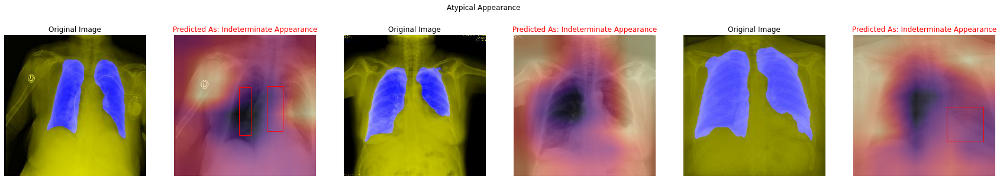

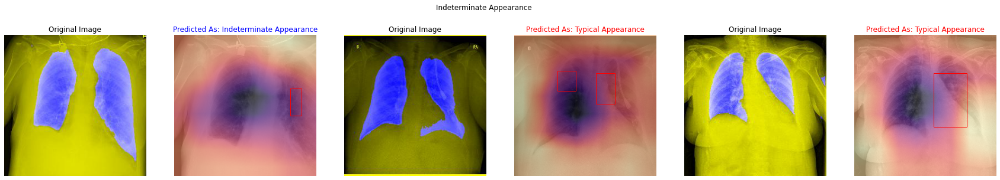

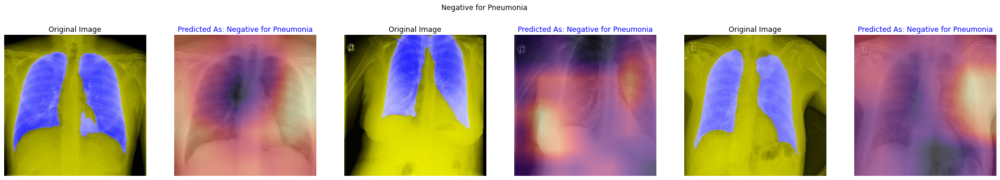

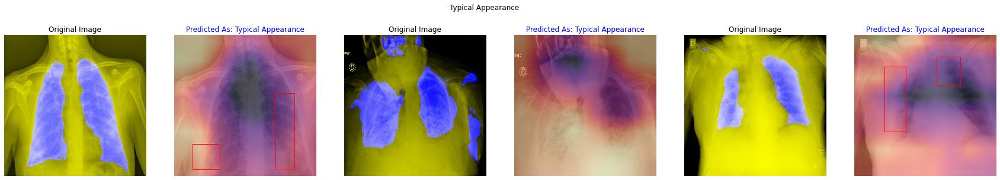

In [ ]:
class Hook():
    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_func)   
    def hook_func(self, m, i, o): self.stored = o.detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()
    
class HookBwd():
    def __init__(self, m):
        self.hook = m.register_backward_hook(self.hook_func)   
    def hook_func(self, m, gi, go): self.stored = go[0].detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()

for cls in ['Atypical Appearance', 'Indeterminate Appearance', 'Negative for Pneumonia', 'Typical Appearance']:
    samples = train_df.loc[train_df.valid & (train_df.study_label==cls)].sample(3, random_state=123)
    figure ,axes = plt.subplots(1, 6, figsize=(30,5))
    axes = axes.reshape((3,2))
    figure.suptitle(cls)
    for (idx, item), (org_ax, ax) in zip(samples.iterrows(), axes):
        img = PILImage.create(ann_cxr_path/item.image_fn)
        org_ax.imshow(img)
        org_ax.set_title('Original Image')
        org_ax.set_axis_off()

        img = PILImage.create(path/'train'/item.image_fn)
        x, = first(dls.test_dl([img]))
        cls_idx = dls.vocab.o2i[cls]
        learn.model.to('cuda')

        with HookBwd(learn.model[0]) as hookg:
            with Hook(learn.model[0]) as hook:
                output = learn.model.eval()(x.cuda())
                act = hook.stored
                predicted_class = dls.vocab[output.detach().cpu().numpy().argmax()]
            output[0,cls_idx].backward()
            grad = hookg.stored

        w = grad[0].mean(dim=[1,2], keepdim=True)
        cam_map = (w * act[0]).sum(0)

        x_dec = TensorImage(dls.train.decode((x,))[0][0])
        x_dec.show(ctx=ax)
        color = 'b' if cls == predicted_class else 'r'
        ax.set_title('Predicted As: '+ predicted_class, color=color)
        ax.imshow(cam_map.detach().cpu(), alpha=0.6, extent=(0,224,224,0),
                    interpolation='bilinear', cmap='magma');
        if isinstance(item.boxes, str):
            for box in literal_eval(item.boxes):
                w_scale  = ax.get_xlim()[1]/item.Columns
                h_scale = ax.get_ylim()[0]/item.Rows
                rect = patches.Rectangle((box['x']*w_scale, box['y']*h_scale), 
                                        box['width']*w_scale, box['height']*h_scale,
                                        color='r', linewidth=1, fill=False)
                ax.add_patch(rect)
    plt.show()

The model is still looking out of the lungs area - sometimes at all the image except for the lung area. I cannot explain these results.

### Binary Models

We saw earlier that the evaluation method calculates the average precision score for each class independently. This led me to try to train a different model for each of the classes. By training the binary models, we reduce the problem for each class to a simpler problem in which we may get better accuracy on each class indepentently

To evaluate the binary models we will add precision to the metrics, since our main interste here is to improve the presicion of the binary model w.r.t the selected class.

Let's try to train a binary model for the most confused class - atypical.

In [ ]:
atypical_dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='Atypical Appearance', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))

learn = cnn_learner(atypical_dls, resnet18, metrics=[accuracy, Precision()], cbs=[MixUp(), SaveModelCallback('accuracy', fname='resnet18_atypical', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
learn.load('resnet18_atypical')

/usr/local/lib/python3.7/dist-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


##### Atypical Binary Model Training

In [ ]:
atypical_dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='Atypical Appearance', bs=128, seed=seed, valid_col='valid',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))

learn = cnn_learner(atypical_dls, resnet18, metrics=[accuracy, Precision()], cbs=[MixUp(), SaveModelCallback('accuracy', fname='resnet18_atypical', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,precision_score,time
0,1.268427,1.512867,0.255694,0.080037,00:15
1,1.051898,0.716580,0.584864,0.091388,00:15
2,0.819488,0.417166,0.846436,0.083969,00:15
3,0.638893,0.329314,0.900073,0.050000,00:15
4,0.510268,0.309125,0.916973,0.000000,00:15
5,0.433980,0.283711,0.926525,0.000000,00:15
6,0.395441,0.273009,0.926525,0.000000,00:15
7,0.372230,0.277723,0.926525,0.000000,00:15
8,0.354502,0.272780,0.926525,0.000000,00:15
9,0.344974,0.272024,0.926525,0.000000,00:15


Better model found at epoch 0 with accuracy value: 0.25569432973861694.
Better model found at epoch 1 with accuracy value: 0.58486407995224.
Better model found at epoch 2 with accuracy value: 0.8464364409446716.
Better model found at epoch 3 with accuracy value: 0.9000734686851501.
Better model found at epoch 4 with accuracy value: 0.916972815990448.
Better model found at epoch 5 with accuracy value: 0.9265246391296387.


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


The model found that the better it can do it to predict all the classes as non-atypical... 0.92 accuracy, 0 precision...

We have to change the loss function to focal loss. In focal loss the most hard classes got more weight in the loss function, such that the model try harder to improve it's precision on those classes. We will set the gamma parameter to some high value, because the atypical seems to be very hard to detect.

In [ ]:
learn = cnn_learner(atypical_dls, resnet18, metrics=[accuracy, Precision(), Recall()], cbs=[SaveModelCallback('precision_score', fname='resnet18_atypical', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/', loss_func=FocalLossFlat(gamma=5))
random_seed(seed)
learn.fit_one_cycle(10, lr)

epoch,train_loss,valid_loss,accuracy,precision_score,recall_score,time
0,0.685791,0.104075,0.744306,0.063380,0.180000,00:15
1,0.508262,0.088695,0.706833,0.074074,0.260000,00:15
2,0.338057,0.052572,0.879500,0.100000,0.080000,00:15
3,0.221858,0.030815,0.797208,0.100000,0.220000,00:15
4,0.152842,0.030815,0.889787,0.109375,0.070000,00:15
5,0.104253,0.025201,0.912564,0.086957,0.020000,00:15
6,0.077236,0.021808,0.919177,0.083333,0.010000,00:15
7,0.058763,0.024777,0.922851,0.000000,0.000000,00:15
8,0.049508,0.020521,0.922851,0.142857,0.010000,00:15
9,0.043574,0.020294,0.921381,0.111111,0.010000,00:15


Better model found at epoch 0 with precision_score value: 0.06338028169014084.
Better model found at epoch 1 with precision_score value: 0.07407407407407407.
Better model found at epoch 2 with precision_score value: 0.1.
Better model found at epoch 4 with precision_score value: 0.109375.
Better model found at epoch 8 with precision_score value: 0.14285714285714285.


In [ ]:
intrep = ClassificationInterpretation.from_learner(learn)
intrep.print_classification_report()

              precision    recall  f1-score   support

           0       0.93      1.00      0.96      1261
           1       0.14      0.01      0.02       100

    accuracy                           0.92      1361
   macro avg       0.53      0.50      0.49      1361
weighted avg       0.87      0.92      0.89      1361



The precision and recall of class 1 (atypical class) are much worse than the four-class model. Although didn't represented here, I got similar results for all the classes. These results surprised me. The task of the binary model is more exact than the four-class model and I expected the model to specialize to its binary task and to be more accurate on this class only. It turns out that additional data that the regular model provided with about how to classify the non-atypical cases give the model more knowledge on the problem and help it improve its accuracy on the atypical cases too. 

### Model ensembling

In [ ]:
!unzip /content/gdrive/MyDrive/covid19-detection/lung_ann.zip -d /content/lung_ann

Until now we compared several models and training method, trained always on the same training set and evaluated on the same validation set. Now when we have two winning model and a training scheme, we want to use the whole data we have for training. To do so we will use 5-Folds method, in which we split our data set to 5 distinct folds, and train 5 models - each one is trained on 4 different folds while the remaining set will serve us as a validation set in order to save the best model during the training. At inference time, we will average the predictions of all the five models as the final prediction. 

By doing so, we are not just taking advantage of all the data we have, but add regularization to to model by averaging several models. 

In [ ]:
from sklearn.model_selection import StratifiedKFold
nfolds = 5
skf = StratifiedKFold(nfolds, shuffle=True, random_state=seed)
for i, (train_idx, val_idx) in enumerate(skf.split(train_df, train_df.study_label)):
    train_df.loc[val_idx , 'val_fold'] = i

#### Resnet18 5-folds

In [ ]:
for fold in range(nfolds):
    print(f'Fold {fold}')
    train_df['current_val_fold'] = train_df.val_fold == fold
    dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='current_val_fold',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
    learn = cnn_learner(dls, resnet18, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname=f'resnet18_fold_{fold}', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
    random_seed(seed)
    print('Training...')
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(20, lr)

    learn.load(f'resnet18_fold_{fold}') #load best model
    learn.export(f'resnet18_fold_{fold}.pkl')
    print('Done.')

Fold 0
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.234610,1.492498,0.393844,00:14
1,1.999853,1.313826,0.516180,00:14
2,1.817956,1.222785,0.550118,00:14
3,1.631885,1.113771,0.585635,00:14
4,1.476509,1.101243,0.591949,00:14
5,1.385140,1.059921,0.587214,00:14
6,1.309986,1.047763,0.598264,00:14
7,1.267001,1.038614,0.595896,00:14
8,1.228759,1.040258,0.599053,00:14
9,1.215098,1.039436,0.600631,00:14


Better model found at epoch 0 with accuracy value: 0.39384374022483826.
Better model found at epoch 1 with accuracy value: 0.5161799788475037.
Better model found at epoch 2 with accuracy value: 0.5501183867454529.
Better model found at epoch 3 with accuracy value: 0.5856353640556335.
Better model found at epoch 4 with accuracy value: 0.591949462890625.
Better model found at epoch 6 with accuracy value: 0.5982636213302612.
Better model found at epoch 8 with accuracy value: 0.599052906036377.
Better model found at epoch 9 with accuracy value: 0.6006314158439636.


epoch,train_loss,valid_loss,accuracy,time
0,1.194779,1.034400,0.597474,00:14
1,1.199681,1.043077,0.607735,00:14
2,1.187455,1.042423,0.598264,00:14
3,1.160036,1.016269,0.615627,00:14
4,1.143094,1.020813,0.605367,00:14
5,1.126428,1.015589,0.606946,00:14
6,1.111182,1.003368,0.610892,00:14
7,1.099076,0.992690,0.610892,00:14
8,1.091586,0.992776,0.613260,00:14
9,1.090414,0.992746,0.613260,00:14


Better model found at epoch 1 with accuracy value: 0.6077347993850708.
Better model found at epoch 3 with accuracy value: 0.6156274676322937.


epoch,train_loss,valid_loss,accuracy,time
0,1.113723,1.010798,0.614838,00:14
1,1.117286,1.001969,0.614838,00:14
2,1.116084,1.006922,0.611681,00:14
3,1.106738,1.000605,0.602999,00:14
4,1.094404,0.995711,0.605367,00:14
5,1.091563,0.999526,0.607735,00:14
6,1.085855,1.021288,0.606946,00:14
7,1.077358,1.003165,0.609313,00:14
8,1.075005,1.004632,0.605367,00:14
9,1.070916,0.995446,0.612470,00:14


Better model found at epoch 15 with accuracy value: 0.6164167523384094.
Done.
Fold 1
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.205660,1.665430,0.340963,00:14
1,1.959726,1.369153,0.520916,00:14
2,1.765720,1.271408,0.505920,00:14
3,1.597780,1.189326,0.567482,00:14
4,1.480354,1.095861,0.573007,00:14
5,1.385397,1.099242,0.585635,00:14
6,1.307071,1.074525,0.597474,00:14
7,1.261139,1.072500,0.609313,00:14
8,1.232931,1.061616,0.610892,00:14
9,1.214369,1.060513,0.611681,00:14


Better model found at epoch 0 with accuracy value: 0.3409629166126251.
Better model found at epoch 1 with accuracy value: 0.5209155678749084.
Better model found at epoch 3 with accuracy value: 0.5674822330474854.
Better model found at epoch 4 with accuracy value: 0.5730071067810059.
Better model found at epoch 5 with accuracy value: 0.5856353640556335.
Better model found at epoch 6 with accuracy value: 0.5974743366241455.
Better model found at epoch 7 with accuracy value: 0.6093133091926575.
Better model found at epoch 8 with accuracy value: 0.6108918786048889.
Better model found at epoch 9 with accuracy value: 0.6116811633110046.


epoch,train_loss,valid_loss,accuracy,time
0,1.210015,1.055136,0.611681,00:14
1,1.198159,1.058567,0.604578,00:14
2,1.190304,1.025291,0.607735,00:14
3,1.162313,1.026744,0.602999,00:14
4,1.143989,1.027231,0.610892,00:14
5,1.129938,1.030792,0.605367,00:14
6,1.112807,1.013807,0.612470,00:14
7,1.102528,1.019167,0.616417,00:14
8,1.094865,1.012341,0.620363,00:14
9,1.088419,1.012986,0.618785,00:14


Better model found at epoch 6 with accuracy value: 0.6124703884124756.
Better model found at epoch 7 with accuracy value: 0.6164167523384094.
Better model found at epoch 8 with accuracy value: 0.6203630566596985.


epoch,train_loss,valid_loss,accuracy,time
0,1.074637,1.018257,0.617995,00:14
1,1.075830,1.007031,0.621152,00:14
2,1.083995,1.018080,0.611681,00:14
3,1.089273,1.006284,0.625888,00:14
4,1.082401,0.990304,0.625888,00:14
5,1.078249,0.995740,0.630624,00:14
6,1.074810,0.999103,0.632991,00:14
7,1.071434,1.030226,0.621152,00:14
8,1.063403,1.011322,0.628256,00:14
9,1.060281,1.003780,0.629834,00:14


Better model found at epoch 1 with accuracy value: 0.6211523413658142.
Better model found at epoch 3 with accuracy value: 0.625887930393219.
Better model found at epoch 5 with accuracy value: 0.6306235194206238.
Better model found at epoch 6 with accuracy value: 0.6329913139343262.
Better model found at epoch 17 with accuracy value: 0.6353591084480286.
Done.
Fold 2
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.220901,1.729824,0.322021,00:14
1,2.002295,1.309641,0.505130,00:14
2,1.797344,1.204352,0.530387,00:14
3,1.624646,1.148906,0.557222,00:14
4,1.478006,1.160477,0.544594,00:15
5,1.372335,1.044647,0.600631,00:14
6,1.317967,1.042510,0.614049,00:15
7,1.274113,1.020103,0.611681,00:15
8,1.248244,1.017023,0.610892,00:14
9,1.229082,1.013723,0.610892,00:14


Better model found at epoch 0 with accuracy value: 0.3220205307006836.
Better model found at epoch 1 with accuracy value: 0.5051302313804626.
Better model found at epoch 2 with accuracy value: 0.530386745929718.
Better model found at epoch 3 with accuracy value: 0.5572217702865601.
Better model found at epoch 5 with accuracy value: 0.6006314158439636.
Better model found at epoch 6 with accuracy value: 0.614048957824707.


epoch,train_loss,valid_loss,accuracy,time
0,1.241012,1.024024,0.614049,00:14
1,1.222664,1.027017,0.610103,00:14


epoch,train_loss,valid_loss,accuracy,time
0,1.241012,1.024024,0.614049,00:14
1,1.222664,1.027017,0.610103,00:14
2,1.204307,1.045847,0.611681,00:14
3,1.178959,1.019698,0.606946,00:14
4,1.153331,1.024178,0.606156,00:14
5,1.133720,0.989195,0.622731,00:14
6,1.115040,0.978886,0.624309,00:14
7,1.097917,0.983074,0.615627,00:14
8,1.096667,0.985469,0.614049,00:14
9,1.089024,0.984056,0.614049,00:14


Better model found at epoch 5 with accuracy value: 0.6227308511734009.
Better model found at epoch 6 with accuracy value: 0.6243094205856323.


epoch,train_loss,valid_loss,accuracy,time
0,1.099421,0.973622,0.623520,00:14
1,1.100617,0.981520,0.619574,00:14
2,1.099980,0.972365,0.629834,00:14
3,1.097065,1.004939,0.610892,00:14
4,1.089672,1.012287,0.613260,00:14
5,1.085104,0.984831,0.623520,00:14
6,1.083457,0.987793,0.613260,00:14
7,1.072513,1.009532,0.607735,00:14
8,1.068079,0.992402,0.614049,00:14
9,1.059108,0.993120,0.610892,00:14


Better model found at epoch 2 with accuracy value: 0.6298342347145081.
Done.
Fold 3
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.202187,1.708136,0.307814,00:14
1,2.010480,1.362801,0.502762,00:14
2,1.794490,1.219032,0.542226,00:14
3,1.625865,1.128798,0.572218,00:14
4,1.487641,1.081557,0.575375,00:14
5,1.384580,1.050052,0.593528,00:14
6,1.309013,1.048114,0.602999,00:14
7,1.260476,1.031599,0.609313,00:14
8,1.237823,1.031589,0.614049,00:14
9,1.217913,1.028020,0.611681,00:14


Better model found at epoch 0 with accuracy value: 0.30781373381614685.
Better model found at epoch 1 with accuracy value: 0.5027624368667603.
Better model found at epoch 2 with accuracy value: 0.54222571849823.
Better model found at epoch 3 with accuracy value: 0.5722178220748901.
Better model found at epoch 4 with accuracy value: 0.5753749012947083.
Better model found at epoch 5 with accuracy value: 0.5935280323028564.
Better model found at epoch 6 with accuracy value: 0.602999210357666.
Better model found at epoch 7 with accuracy value: 0.6093133091926575.
Better model found at epoch 8 with accuracy value: 0.614048957824707.


epoch,train_loss,valid_loss,accuracy,time
0,1.202927,1.020557,0.613260,00:14
1,1.195205,1.043596,0.604578,00:14
2,1.185044,1.044132,0.592739,00:14
3,1.159005,1.014418,0.610103,00:14
4,1.141352,1.010734,0.618785,00:14
5,1.133509,1.001663,0.617206,00:14
6,1.113134,0.987656,0.622731,00:14
7,1.098867,0.985414,0.619574,00:14
8,1.094039,0.981885,0.625099,00:14
9,1.092553,0.982818,0.624309,00:14


Better model found at epoch 4 with accuracy value: 0.6187845468521118.
Better model found at epoch 6 with accuracy value: 0.6227308511734009.
Better model found at epoch 8 with accuracy value: 0.6250986456871033.


epoch,train_loss,valid_loss,accuracy,time
0,1.088770,0.983164,0.621942,00:14
1,1.080046,0.981290,0.621152,00:14
2,1.090278,0.995549,0.614838,00:14
3,1.093406,1.004714,0.613260,00:14
4,1.091238,1.001562,0.610892,00:14
5,1.083788,0.986191,0.625888,00:14
6,1.077744,0.977527,0.619574,00:14
7,1.074677,0.994902,0.612470,00:14
8,1.073335,0.982139,0.623520,00:14
9,1.069544,0.973899,0.620363,00:14


Better model found at epoch 5 with accuracy value: 0.625887930393219.
Better model found at epoch 11 with accuracy value: 0.6274664402008057.
Better model found at epoch 15 with accuracy value: 0.6329913139343262.
Done.
Fold 4
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.246577,1.757234,0.329384,00:14
1,1.985038,1.379500,0.499210,00:14
2,1.775595,1.248947,0.541864,00:14
3,1.610152,1.133465,0.575829,00:14
4,1.478290,1.107720,0.593997,00:14
5,1.382506,1.078136,0.607425,00:14
6,1.317817,1.047092,0.601106,00:14
7,1.272947,1.037033,0.612954,00:14
8,1.244536,1.030353,0.614534,00:14
9,1.213058,1.030292,0.608215,00:14


Better model found at epoch 0 with accuracy value: 0.32938387989997864.
Better model found at epoch 1 with accuracy value: 0.4992101192474365.
Better model found at epoch 2 with accuracy value: 0.5418641567230225.
Better model found at epoch 3 with accuracy value: 0.5758293867111206.
Better model found at epoch 4 with accuracy value: 0.5939968228340149.
Better model found at epoch 5 with accuracy value: 0.6074249744415283.
Better model found at epoch 7 with accuracy value: 0.6129541993141174.
Better model found at epoch 8 with accuracy value: 0.6145339608192444.


epoch,train_loss,valid_loss,accuracy,time
0,1.220735,1.019733,0.617694,00:14
1,1.207228,1.032834,0.618483,00:14
2,1.186590,1.021601,0.616904,00:14
3,1.166744,0.988091,0.631122,00:14
4,1.149615,1.008999,0.620063,00:14
5,1.126041,0.987518,0.628752,00:14
6,1.111983,0.978616,0.624013,00:14
7,1.100897,0.973983,0.632701,00:14
8,1.095111,0.973408,0.635071,00:14
9,1.094721,0.974186,0.632701,00:14


Better model found at epoch 0 with accuracy value: 0.6176935434341431.
Better model found at epoch 1 with accuracy value: 0.6184834241867065.
Better model found at epoch 3 with accuracy value: 0.6311216354370117.
Better model found at epoch 7 with accuracy value: 0.6327013969421387.
Better model found at epoch 8 with accuracy value: 0.6350710988044739.


epoch,train_loss,valid_loss,accuracy,time
0,1.079432,0.973780,0.635071,00:14
1,1.075992,0.967503,0.635861,00:14
2,1.081582,0.969732,0.634281,00:14
3,1.083442,0.966936,0.634281,00:14
4,1.083476,0.972557,0.626382,00:14
5,1.079381,1.001693,0.614534,00:14
6,1.084411,1.004687,0.612954,00:14
7,1.074714,0.953614,0.639810,00:14
8,1.068605,0.960483,0.634281,00:14
9,1.065629,0.958600,0.640600,00:14


Better model found at epoch 1 with accuracy value: 0.6358609795570374.
Better model found at epoch 7 with accuracy value: 0.6398104429244995.
Better model found at epoch 9 with accuracy value: 0.640600323677063.
Better model found at epoch 14 with accuracy value: 0.6421800851821899.
Done.


#### Resnet34 5-folds

In [ ]:
for fold in range(nfolds):
    print(f'Fold {fold}')
    train_df['current_val_fold'] = train_df.val_fold == fold
    dls = ImageDataLoaders.from_df(train_df, path/'train', fn_col='image_fn', label_col='study_label', bs=64, seed=seed, valid_col='current_val_fold',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
    learn = cnn_learner(dls, resnet34, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname=f'resnet34_fold_{fold}', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
    random_seed(seed)
    print('Training...')
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(20, lr)

    learn.load(f'resnet34_fold_{fold}') # load best model
    learn.export(f'resnet34_fold_{fold}.pkl')
    print('Done.')

Fold 0
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.198955,1.455005,0.468824,00:25
1,1.898526,1.375287,0.528808,00:25
2,1.605244,1.203083,0.553275,00:25
3,1.408272,1.134905,0.558011,00:25
4,1.272342,1.067355,0.577743,00:25
5,1.198823,1.045238,0.596685,00:25
6,1.163339,1.041618,0.606156,00:25
7,1.138712,1.020982,0.602999,00:25
8,1.132937,1.030093,0.600631,00:25
9,1.121814,1.027627,0.595896,00:25


Better model found at epoch 0 with accuracy value: 0.46882399916648865.
Better model found at epoch 1 with accuracy value: 0.5288082361221313.
Better model found at epoch 2 with accuracy value: 0.553275465965271.
Better model found at epoch 3 with accuracy value: 0.5580110549926758.
Better model found at epoch 4 with accuracy value: 0.5777426958084106.
Better model found at epoch 5 with accuracy value: 0.5966851115226746.
Better model found at epoch 6 with accuracy value: 0.6061562895774841.


epoch,train_loss,valid_loss,accuracy,time
0,1.122382,1.045630,0.600631,00:25
1,1.134466,1.066402,0.598264,00:25
2,1.123392,1.036959,0.612470,00:25
3,1.116510,1.017898,0.606156,00:25
4,1.102789,1.008266,0.602210,00:25
5,1.089351,1.003396,0.599842,00:25
6,1.070792,0.991155,0.618785,00:25
7,1.064025,0.979076,0.620363,00:25
8,1.057279,0.983694,0.621152,00:25
9,1.059520,0.985880,0.617206,00:25


Better model found at epoch 2 with accuracy value: 0.6124703884124756.
Better model found at epoch 6 with accuracy value: 0.6187845468521118.
Better model found at epoch 7 with accuracy value: 0.6203630566596985.
Better model found at epoch 8 with accuracy value: 0.6211523413658142.


epoch,train_loss,valid_loss,accuracy,time
0,1.068274,0.976097,0.620363,00:25
1,1.056215,0.982830,0.617206,00:25
2,1.053725,0.982623,0.621152,00:25
3,1.062020,0.985856,0.620363,00:25
4,1.058906,0.985248,0.608524,00:25
5,1.060967,1.010143,0.610892,00:25
6,1.063434,1.006849,0.607735,00:25
7,1.062042,0.981906,0.619574,00:25
8,1.042451,0.988982,0.614049,00:25
9,1.045743,0.987031,0.610892,00:25


Better model found at epoch 17 with accuracy value: 0.6282557249069214.
Done.
Fold 1
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.235517,1.589072,0.371744,00:25
1,1.911293,1.311483,0.479084,00:25
2,1.630861,1.218601,0.529597,00:25
3,1.434478,1.140904,0.547751,00:25
4,1.307059,1.072369,0.588003,00:25
5,1.234429,1.050139,0.585635,00:25
6,1.185345,1.052819,0.596685,00:25
7,1.156201,1.033458,0.605367,00:25
8,1.148974,1.033625,0.604578,00:25
9,1.131557,1.026955,0.610103,00:25


Better model found at epoch 0 with accuracy value: 0.3717442750930786.
Better model found at epoch 1 with accuracy value: 0.47908446192741394.
Better model found at epoch 2 with accuracy value: 0.5295974612236023.
Better model found at epoch 3 with accuracy value: 0.5477505922317505.
Better model found at epoch 4 with accuracy value: 0.5880031585693359.
Better model found at epoch 6 with accuracy value: 0.5966851115226746.
Better model found at epoch 7 with accuracy value: 0.6053670048713684.
Better model found at epoch 9 with accuracy value: 0.6101025938987732.


epoch,train_loss,valid_loss,accuracy,time
0,1.132458,1.029743,0.618785,00:25
1,1.131279,1.077724,0.583268,00:25
2,1.121359,1.055449,0.602999,00:25
3,1.107346,1.010855,0.620363,00:25
4,1.103917,0.993638,0.622731,00:25
5,1.082556,1.018399,0.610892,00:25
6,1.073016,1.007766,0.625099,00:25
7,1.066606,0.996029,0.623520,00:25
8,1.057854,1.003608,0.619574,00:25
9,1.056804,1.000958,0.620363,00:25


Better model found at epoch 0 with accuracy value: 0.6187845468521118.
Better model found at epoch 3 with accuracy value: 0.6203630566596985.
Better model found at epoch 4 with accuracy value: 0.6227308511734009.
Better model found at epoch 6 with accuracy value: 0.6250986456871033.


epoch,train_loss,valid_loss,accuracy,time
0,1.060153,1.012557,0.617206,00:25
1,1.053751,0.998020,0.620363,00:25
2,1.066361,1.014656,0.614049,00:25
3,1.068550,1.023431,0.623520,00:25
4,1.069223,1.032246,0.604578,00:25
5,1.065220,0.997670,0.620363,00:25
6,1.055947,0.994146,0.606946,00:25
7,1.055414,1.031096,0.608524,00:25
8,1.050494,1.011551,0.616417,00:25
9,1.057959,0.997896,0.621152,00:25


Better model found at epoch 12 with accuracy value: 0.6314128041267395.
Better model found at epoch 13 with accuracy value: 0.6322020292282104.
Better model found at epoch 17 with accuracy value: 0.6337805986404419.
Done.
Fold 2
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.192167,1.607802,0.372534,00:25
1,1.918491,1.264872,0.509866,00:25
2,1.655571,1.161155,0.576164,00:25
3,1.459640,1.061519,0.566693,00:25
4,1.319673,1.030691,0.594317,00:25
5,1.229283,0.992595,0.625888,00:25
6,1.183756,1.008226,0.608524,00:25
7,1.159053,1.005332,0.607735,00:25
8,1.143366,0.990223,0.611681,00:25
9,1.122591,0.991095,0.615627,00:25


Better model found at epoch 0 with accuracy value: 0.37253352999687195.
Better model found at epoch 1 with accuracy value: 0.5098658204078674.
Better model found at epoch 2 with accuracy value: 0.576164186000824.
Better model found at epoch 4 with accuracy value: 0.5943172574043274.
Better model found at epoch 5 with accuracy value: 0.625887930393219.


epoch,train_loss,valid_loss,accuracy,time
0,1.183132,1.005112,0.617206,00:25
1,1.159525,1.046798,0.583268,00:25
2,1.156878,0.998382,0.610892,00:25
3,1.123664,1.032303,0.594317,00:25
4,1.102900,1.014537,0.596685,00:25
5,1.086533,1.017691,0.598264,00:25
6,1.069825,1.040683,0.589582,00:25
7,1.069034,1.012620,0.598264,00:25
8,1.059913,1.018457,0.595107,00:25
9,1.047088,1.001337,0.603788,00:25


epoch,train_loss,valid_loss,accuracy,time
0,1.190281,1.001714,0.616417,00:25
1,1.157022,1.013584,0.613260,00:25
2,1.149163,1.018391,0.593528,00:25
3,1.132601,1.027458,0.591949,00:25
4,1.123236,1.047384,0.591949,00:25
5,1.105491,0.991891,0.614049,00:25
6,1.095494,0.981582,0.609313,00:25
7,1.086692,0.985812,0.629834,00:25
8,1.082400,1.004746,0.596685,00:25
9,1.065536,0.980301,0.620363,00:25


Better model found at epoch 7 with accuracy value: 0.6298342347145081.
Done.
Fold 3
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.199070,1.601464,0.385951,00:25
1,1.907139,1.516839,0.393054,00:25
2,1.636967,1.224306,0.546172,00:25
3,1.442896,1.086439,0.572218,00:25
4,1.306612,1.068865,0.594317,00:25
5,1.244442,1.048904,0.592739,00:25
6,1.173175,1.035960,0.617995,00:25
7,1.161078,1.016915,0.621152,00:25
8,1.135560,1.031766,0.614838,00:25
9,1.135011,1.013242,0.619574,00:25


Better model found at epoch 0 with accuracy value: 0.38595107197761536.
Better model found at epoch 1 with accuracy value: 0.39305445551872253.
Better model found at epoch 2 with accuracy value: 0.5461720824241638.
Better model found at epoch 3 with accuracy value: 0.5722178220748901.
Better model found at epoch 4 with accuracy value: 0.5943172574043274.
Better model found at epoch 6 with accuracy value: 0.6179952621459961.
Better model found at epoch 7 with accuracy value: 0.6211523413658142.


epoch,train_loss,valid_loss,accuracy,time
0,1.144372,1.024360,0.620363,00:25
1,1.126831,1.015553,0.627466,00:25


Better model found at epoch 1 with accuracy value: 0.6274664402008057.


epoch,train_loss,valid_loss,accuracy,time
0,1.144372,1.024360,0.620363,00:25
1,1.126831,1.015553,0.627466,00:25
2,1.118229,1.110919,0.576953,00:25
3,1.110242,1.023886,0.602999,00:25
4,1.102328,1.014616,0.606946,00:25
5,1.083611,0.991508,0.614838,00:25
6,1.084063,0.981845,0.614049,00:25
7,1.068733,0.982798,0.609313,00:25
8,1.052268,0.980851,0.611681,00:25
9,1.061891,0.987935,0.610892,00:25


epoch,train_loss,valid_loss,accuracy,time
0,1.124089,1.009481,0.624309,00:25
1,1.119977,1.015595,0.617995,00:25
2,1.103107,0.999917,0.611681,00:25
3,1.105830,1.008078,0.621152,00:25
4,1.104212,0.985159,0.623520,00:25
5,1.089156,0.985600,0.621152,00:25
6,1.085182,1.012687,0.603788,00:25
7,1.078272,1.003837,0.614838,00:25
8,1.058939,1.005220,0.614838,00:25
9,1.064392,0.974047,0.621152,00:25


Better model found at epoch 10 with accuracy value: 0.6298342347145081.
Done.
Fold 4
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.256476,1.512802,0.389415,00:25
1,1.904163,1.325793,0.492101,00:25
2,1.636944,1.250400,0.529226,00:25
3,1.430055,1.145097,0.543444,00:25
4,1.293298,1.075116,0.578199,00:25
5,1.217415,1.078131,0.571090,00:25
6,1.174639,1.043897,0.581359,00:25
7,1.155476,1.040792,0.590047,00:25
8,1.140831,1.024644,0.601106,00:25
9,1.116905,1.025880,0.602686,00:25


Better model found at epoch 0 with accuracy value: 0.3894154727458954.
Better model found at epoch 1 with accuracy value: 0.49210110306739807.
Better model found at epoch 2 with accuracy value: 0.5292258858680725.
Better model found at epoch 3 with accuracy value: 0.5434439182281494.
Better model found at epoch 4 with accuracy value: 0.578199028968811.
Better model found at epoch 6 with accuracy value: 0.5813586115837097.
Better model found at epoch 7 with accuracy value: 0.5900474190711975.
Better model found at epoch 8 with accuracy value: 0.6011058688163757.
Better model found at epoch 9 with accuracy value: 0.6026856303215027.


epoch,train_loss,valid_loss,accuracy,time
0,1.137233,1.027365,0.607425,00:25
1,1.122276,1.044981,0.596367,00:25
2,1.120769,1.083054,0.597156,00:25
3,1.112354,1.011656,0.612954,00:25
4,1.109588,0.982951,0.627962,00:25
5,1.077719,1.006319,0.611374,00:25
6,1.078218,0.970834,0.627962,00:25
7,1.061615,0.977131,0.627962,00:25
8,1.053669,0.971338,0.627962,00:25
9,1.049749,0.983110,0.626382,00:25


Better model found at epoch 0 with accuracy value: 0.6074249744415283.
Better model found at epoch 3 with accuracy value: 0.6129541993141174.
Better model found at epoch 4 with accuracy value: 0.6279621124267578.


epoch,train_loss,valid_loss,accuracy,time
0,1.080091,0.998627,0.614534,00:25
1,1.064752,0.986786,0.624013,00:25
2,1.064941,1.017184,0.602686,00:25
3,1.066792,0.987229,0.610584,00:25
4,1.070226,1.006477,0.623223,00:25
5,1.066195,1.041618,0.606635,00:25
6,1.058264,1.013997,0.609795,00:25
7,1.071260,1.040552,0.601106,00:25
8,1.062253,1.054215,0.597156,00:25
9,1.064196,1.010514,0.604265,00:25


Better model found at epoch 10 with accuracy value: 0.6429699659347534.
Done.


Using the ensemble of all these models is a significant imporvement - it's got score of 0.342 in the public leaderboard.
Let's try to add the lung annotated version of these model to the pot.

Resnet18 Lung Annotated 5-folds

In [ ]:
for fold in range(nfolds):
    print(f'Fold {fold}')
    train_df['current_val_fold'] = train_df.val_fold == fold
    dls = ImageDataLoaders.from_df(train_df, '/content/lung_ann/content/ann_cxr/', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='current_val_fold',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
    learn = cnn_learner(dls, resnet18, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname=f'resnet18_ann_fold_{fold}', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
    random_seed(seed)
    print('Training...')
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(20, lr)

    learn.load(f'resnet18_ann_fold_{fold}') #load best model
    learn.export(f'resnet18_ann_fold_{fold}.pkl')
    print('Done.')

Fold 0
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.237028,1.457613,0.423047,00:15
1,2.005970,1.287756,0.499605,00:15
2,1.790800,1.150744,0.575375,00:14
3,1.600239,1.079062,0.586425,00:15
4,1.470649,1.096299,0.586425,00:14
5,1.369671,1.056554,0.599842,00:14
6,1.305756,1.050366,0.597474,00:14
7,1.260641,1.041989,0.596685,00:14
8,1.230181,1.040788,0.596685,00:14
9,1.214047,1.042391,0.595896,00:15


Better model found at epoch 0 with accuracy value: 0.4230465590953827.
Better model found at epoch 1 with accuracy value: 0.49960535764694214.
Better model found at epoch 2 with accuracy value: 0.5753749012947083.
Better model found at epoch 3 with accuracy value: 0.5864246487617493.
Better model found at epoch 5 with accuracy value: 0.5998421311378479.


epoch,train_loss,valid_loss,accuracy,time
0,1.247398,1.048126,0.598264,00:15
1,1.241044,1.070703,0.595107,00:15
2,1.224881,1.033238,0.591949,00:15
3,1.189975,1.024038,0.595107,00:15
4,1.159704,1.021845,0.602210,00:14
5,1.143724,1.009636,0.604578,00:15
6,1.121943,1.002951,0.607735,00:14
7,1.112716,0.998557,0.607735,00:15
8,1.095938,0.997393,0.609313,00:14
9,1.095875,0.996677,0.610892,00:14


Better model found at epoch 4 with accuracy value: 0.6022099256515503.
Better model found at epoch 5 with accuracy value: 0.6045777201652527.
Better model found at epoch 6 with accuracy value: 0.6077347993850708.
Better model found at epoch 8 with accuracy value: 0.6093133091926575.
Better model found at epoch 9 with accuracy value: 0.6108918786048889.


epoch,train_loss,valid_loss,accuracy,time
0,1.088843,0.991313,0.612470,00:15
1,1.094248,0.994824,0.611681,00:14
2,1.088900,0.994727,0.613260,00:15
3,1.088587,0.985635,0.614838,00:15
4,1.083624,1.000710,0.612470,00:14
5,1.081958,0.996613,0.620363,00:14
6,1.076530,0.996029,0.619574,00:14
7,1.069690,0.981255,0.617206,00:14
8,1.064353,0.975639,0.617995,00:14
9,1.067019,0.981098,0.612470,00:14


Better model found at epoch 0 with accuracy value: 0.6124703884124756.
Better model found at epoch 2 with accuracy value: 0.6132596731185913.
Better model found at epoch 3 with accuracy value: 0.614838182926178.
Better model found at epoch 5 with accuracy value: 0.6203630566596985.
Better model found at epoch 10 with accuracy value: 0.6211523413658142.
Better model found at epoch 11 with accuracy value: 0.6250986456871033.
Better model found at epoch 13 with accuracy value: 0.625887930393219.
Better model found at epoch 15 with accuracy value: 0.6274664402008057.
Better model found at epoch 18 with accuracy value: 0.6290450096130371.
Done.
Fold 1
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.239647,1.523592,0.401736,00:14
1,1.983648,1.278028,0.498027,00:14
2,1.765474,1.134132,0.548540,00:15
3,1.611617,1.121699,0.554065,00:15
4,1.484394,1.089022,0.584846,00:15
5,1.378294,1.049262,0.595107,00:14
6,1.304728,1.044652,0.593528,00:14
7,1.268483,1.033315,0.595107,00:14
8,1.235919,1.037927,0.590371,00:15
9,1.218186,1.038241,0.592739,00:14


Better model found at epoch 0 with accuracy value: 0.40173637866973877.
Better model found at epoch 1 with accuracy value: 0.49802684783935547.
Better model found at epoch 2 with accuracy value: 0.5485398769378662.
Better model found at epoch 3 with accuracy value: 0.5540646910667419.
Better model found at epoch 4 with accuracy value: 0.5848460793495178.
Better model found at epoch 5 with accuracy value: 0.5951065421104431.


epoch,train_loss,valid_loss,accuracy,time
0,1.265217,1.038098,0.600631,00:14
1,1.240889,1.053972,0.600631,00:14
2,1.209629,1.028423,0.613260,00:14
3,1.188690,1.022250,0.606156,00:15
4,1.171322,1.014402,0.616417,00:15
5,1.135420,0.994483,0.617995,00:15
6,1.121972,1.004164,0.625099,00:14
7,1.108761,0.999677,0.623520,00:15
8,1.102089,1.000486,0.623520,00:15
9,1.096284,0.995399,0.625099,00:14


Better model found at epoch 0 with accuracy value: 0.6006314158439636.
Better model found at epoch 2 with accuracy value: 0.6132596731185913.
Better model found at epoch 4 with accuracy value: 0.6164167523384094.
Better model found at epoch 5 with accuracy value: 0.6179952621459961.
Better model found at epoch 6 with accuracy value: 0.6250986456871033.


epoch,train_loss,valid_loss,accuracy,time
0,1.100730,1.002515,0.621152,00:15
1,1.101057,0.994272,0.625099,00:14
2,1.096202,0.988600,0.619574,00:14
3,1.093533,0.995527,0.622731,00:14
4,1.093181,1.005092,0.625099,00:14
5,1.087276,0.994782,0.625888,00:15
6,1.079061,0.967128,0.632991,00:15
7,1.070479,0.977005,0.633781,00:15
8,1.070608,0.993144,0.624309,00:14
9,1.064490,0.977914,0.632202,00:14


Better model found at epoch 5 with accuracy value: 0.625887930393219.
Better model found at epoch 6 with accuracy value: 0.6329913139343262.
Better model found at epoch 7 with accuracy value: 0.6337805986404419.
Better model found at epoch 10 with accuracy value: 0.6353591084480286.
Better model found at epoch 12 with accuracy value: 0.6408839821815491.
Better model found at epoch 18 with accuracy value: 0.6416732668876648.
Done.
Fold 2
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.259536,1.422615,0.455406,00:14
1,2.011620,1.265033,0.523283,00:15
2,1.802588,1.142860,0.561957,00:15
3,1.615768,1.086178,0.584846,00:14
4,1.473160,1.061084,0.588792,00:15
5,1.382665,1.043801,0.581689,00:14
6,1.315352,1.018217,0.602210,00:14
7,1.270930,1.009172,0.604578,00:14
8,1.232624,1.006826,0.607735,00:14
9,1.214664,1.005999,0.607735,00:14


Better model found at epoch 0 with accuracy value: 0.45540645718574524.
Better model found at epoch 1 with accuracy value: 0.5232833623886108.
Better model found at epoch 2 with accuracy value: 0.5619573593139648.
Better model found at epoch 3 with accuracy value: 0.5848460793495178.
Better model found at epoch 4 with accuracy value: 0.5887924432754517.
Better model found at epoch 6 with accuracy value: 0.6022099256515503.
Better model found at epoch 7 with accuracy value: 0.6045777201652527.
Better model found at epoch 8 with accuracy value: 0.6077347993850708.


epoch,train_loss,valid_loss,accuracy,time
0,1.219483,0.999777,0.612470,00:14
1,1.200422,1.026304,0.588003,00:15
2,1.189951,0.999949,0.612470,00:14
3,1.163698,0.985818,0.617995,00:14
4,1.142187,0.975809,0.623520,00:14
5,1.119571,0.981066,0.620363,00:14
6,1.102327,0.972258,0.625888,00:14
7,1.098383,0.970311,0.625099,00:14
8,1.086761,0.970965,0.624309,00:14
9,1.090981,0.968915,0.626677,00:15


Better model found at epoch 0 with accuracy value: 0.6124703884124756.
Better model found at epoch 3 with accuracy value: 0.6179952621459961.
Better model found at epoch 4 with accuracy value: 0.6235201358795166.
Better model found at epoch 6 with accuracy value: 0.625887930393219.
Better model found at epoch 9 with accuracy value: 0.6266772150993347.


epoch,train_loss,valid_loss,accuracy,time
0,1.087717,0.967165,0.626677,00:15
1,1.078591,0.973615,0.624309,00:14
2,1.082432,0.963878,0.629834,00:14
3,1.083198,0.977569,0.611681,00:15
4,1.087385,0.963257,0.632991,00:14
5,1.082487,0.975096,0.625099,00:14
6,1.078947,0.970891,0.622731,00:15
7,1.071663,0.982088,0.625099,00:14
8,1.069831,0.963982,0.630624,00:14
9,1.068072,0.953159,0.625888,00:14


Better model found at epoch 2 with accuracy value: 0.6298342347145081.
Better model found at epoch 4 with accuracy value: 0.6329913139343262.
Better model found at epoch 11 with accuracy value: 0.6345698237419128.
Better model found at epoch 14 with accuracy value: 0.6385161876678467.
Done.
Fold 3
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.262327,1.412552,0.456985,00:15
1,2.004897,1.206750,0.537490,00:14
2,1.799374,1.192209,0.517758,00:15
3,1.620904,1.061047,0.587214,00:14
4,1.492836,1.035690,0.607735,00:14
5,1.391925,1.047489,0.591949,00:15
6,1.324623,1.003708,0.607735,00:14
7,1.278229,1.001693,0.610892,00:14
8,1.233637,1.002645,0.608524,00:14
9,1.219073,1.002982,0.609313,00:14


Better model found at epoch 0 with accuracy value: 0.4569849967956543.
Better model found at epoch 1 with accuracy value: 0.5374901294708252.
Better model found at epoch 3 with accuracy value: 0.5872138738632202.
Better model found at epoch 4 with accuracy value: 0.6077347993850708.
Better model found at epoch 7 with accuracy value: 0.6108918786048889.


epoch,train_loss,valid_loss,accuracy,time
0,1.212861,1.000544,0.611681,00:14
1,1.204065,1.009491,0.622731,00:15
2,1.196712,0.985777,0.626677,00:15
3,1.172543,1.006143,0.612470,00:14
4,1.156599,0.977756,0.619574,00:15
5,1.135836,0.979242,0.624309,00:15
6,1.114483,0.970968,0.621152,00:15
7,1.107795,0.970012,0.621942,00:14
8,1.104261,0.968516,0.622731,00:14
9,1.100477,0.971237,0.622731,00:14


Better model found at epoch 0 with accuracy value: 0.6116811633110046.
Better model found at epoch 1 with accuracy value: 0.6227308511734009.
Better model found at epoch 2 with accuracy value: 0.6266772150993347.


epoch,train_loss,valid_loss,accuracy,time
0,1.159183,0.985522,0.622731,00:14
1,1.149433,0.980990,0.629045,00:15
2,1.135430,0.983119,0.621152,00:15
3,1.133054,0.992202,0.608524,00:14
4,1.120037,0.985035,0.621942,00:14
5,1.107844,0.970617,0.629045,00:14
6,1.109687,0.959678,0.638516,00:15
7,1.096424,0.948783,0.630624,00:14
8,1.089560,0.969129,0.632991,00:15
9,1.085088,0.956780,0.626677,00:14


Better model found at epoch 1 with accuracy value: 0.6290450096130371.
Better model found at epoch 6 with accuracy value: 0.6385161876678467.
Better model found at epoch 14 with accuracy value: 0.6408839821815491.
Done.
Fold 4
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.244611,1.528653,0.412322,00:15
1,2.000252,1.311453,0.494471,00:15
2,1.788661,1.132851,0.561611,00:14
3,1.622675,1.091156,0.597156,00:14
4,1.486402,1.079034,0.589257,00:15
5,1.390672,1.054176,0.599526,00:14
6,1.310692,1.026871,0.614534,00:14
7,1.266693,1.023468,0.614534,00:15
8,1.240914,1.016933,0.615324,00:14
9,1.223765,1.016068,0.614534,00:15


Better model found at epoch 0 with accuracy value: 0.4123222827911377.
Better model found at epoch 1 with accuracy value: 0.4944707751274109.
Better model found at epoch 2 with accuracy value: 0.5616113543510437.
Better model found at epoch 3 with accuracy value: 0.5971564054489136.
Better model found at epoch 5 with accuracy value: 0.599526047706604.
Better model found at epoch 6 with accuracy value: 0.6145339608192444.
Better model found at epoch 8 with accuracy value: 0.6153238415718079.


epoch,train_loss,valid_loss,accuracy,time
0,1.209523,1.009892,0.616904,00:15
1,1.204532,1.002420,0.615324,00:15
2,1.191105,0.982931,0.620063,00:15
3,1.160640,0.990418,0.624803,00:15
4,1.141727,0.973118,0.631122,00:15
5,1.121299,0.964844,0.635071,00:14
6,1.111813,0.958326,0.632701,00:15
7,1.098314,0.956512,0.627962,00:15
8,1.098397,0.957661,0.630332,00:15
9,1.090573,0.955346,0.628752,00:15


Better model found at epoch 0 with accuracy value: 0.6169036626815796.
Better model found at epoch 2 with accuracy value: 0.6200631856918335.
Better model found at epoch 3 with accuracy value: 0.6248025298118591.
Better model found at epoch 4 with accuracy value: 0.6311216354370117.
Better model found at epoch 5 with accuracy value: 0.6350710988044739.


epoch,train_loss,valid_loss,accuracy,time
0,1.118069,0.960477,0.635071,00:15
1,1.108627,0.957682,0.635071,00:14
2,1.097505,0.956380,0.634281,00:14
3,1.095148,0.955877,0.635071,00:15
4,1.090379,0.966775,0.628752,00:15
5,1.088189,0.959265,0.633491,00:15
6,1.087619,0.952812,0.630332,00:15
7,1.079178,0.951993,0.624803,00:15
8,1.075722,0.925925,0.645340,00:15
9,1.067746,0.949280,0.629542,00:15


Better model found at epoch 8 with accuracy value: 0.6453396677970886.


epoch,train_loss,valid_loss,accuracy,time
0,1.118069,0.960477,0.635071,00:15
1,1.108627,0.957682,0.635071,00:14
2,1.097505,0.956380,0.634281,00:14
3,1.095148,0.955877,0.635071,00:15
4,1.090379,0.966775,0.628752,00:15
5,1.088189,0.959265,0.633491,00:15
6,1.087619,0.952812,0.630332,00:15
7,1.079178,0.951993,0.624803,00:15
8,1.075722,0.925925,0.645340,00:15
9,1.067746,0.949280,0.629542,00:15


Better model found at epoch 11 with accuracy value: 0.6469194293022156.
Done.


#### Resnet34 Lung Annotated 5-folds

In [ ]:
for fold in range(nfolds):
    print(f'Fold {fold}')
    train_df['current_val_fold'] = train_df.val_fold == fold
    dls = ImageDataLoaders.from_df(train_df, '/content/lung_ann/content/ann_cxr/', fn_col='image_fn', label_col='study_label', bs=128, seed=seed, valid_col='current_val_fold',
                               batch_tfms=aug_transforms(
                                    mult=1.3,
                                    max_rotate=25,
                                    min_zoom=.9,
                                    max_zoom=1.3,
                                    max_lighting=.4,
                                    max_warp=.3
                                ))
    learn = cnn_learner(dls, resnet34, metrics=metrics, cbs=[MixUp(), SaveModelCallback('accuracy', fname=f'resnet34_ann_fold_{fold}', reset_on_fit=False)], 
                    path='/content/gdrive/MyDrive/covid19-detection/project-models/')
    random_seed(seed)
    print('Training...')
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(10, lr)
    learn.fit_one_cycle(20, lr)

    learn.load(f'resnet34_ann_fold_{fold}') #load best model
    learn.export(f'resnet34_ann_fold_{fold}.pkl')
    print('Done.')

Fold 0
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.255134,1.369144,0.455406,00:24
1,2.042156,1.235394,0.535122,00:24
2,1.812929,1.134472,0.584057,00:24
3,1.636160,1.104401,0.596685,00:24
4,1.498461,1.084943,0.595896,00:24
5,1.393923,1.041812,0.597474,00:24
6,1.327748,1.035429,0.604578,00:24
7,1.286115,1.026783,0.599053,00:24
8,1.249744,1.026357,0.601421,00:24
9,1.224982,1.025222,0.605367,00:24


Better model found at epoch 0 with accuracy value: 0.45540645718574524.
Better model found at epoch 1 with accuracy value: 0.5351223349571228.
Better model found at epoch 2 with accuracy value: 0.5840568542480469.
Better model found at epoch 3 with accuracy value: 0.5966851115226746.
Better model found at epoch 5 with accuracy value: 0.5974743366241455.
Better model found at epoch 6 with accuracy value: 0.6045777201652527.
Better model found at epoch 9 with accuracy value: 0.6053670048713684.


epoch,train_loss,valid_loss,accuracy,time
0,1.208238,1.023672,0.602999,00:24
1,1.211033,1.075028,0.596685,00:24
2,1.194134,1.030027,0.607735,00:24
3,1.166628,1.010624,0.604578,00:24
4,1.143425,1.007962,0.607735,00:24
5,1.128841,0.998547,0.609313,00:24
6,1.112710,0.994732,0.606156,00:24
7,1.103441,0.991234,0.604578,00:24
8,1.090623,0.986268,0.607735,00:24
9,1.084118,0.986558,0.606946,00:24


Better model found at epoch 2 with accuracy value: 0.6077347993850708.
Better model found at epoch 5 with accuracy value: 0.6093133091926575.


epoch,train_loss,valid_loss,accuracy,time
0,1.096640,0.990299,0.614049,00:24
1,1.093376,0.992216,0.607735,00:24
2,1.089498,0.981720,0.609313,00:24
3,1.087825,0.986179,0.617206,00:24
4,1.085086,0.988908,0.609313,00:24
5,1.079509,0.997544,0.612470,00:24
6,1.075347,0.987415,0.617206,00:24
7,1.065614,0.967906,0.617206,00:24
8,1.062245,0.968866,0.627466,00:24
9,1.055328,0.977457,0.621152,00:24


Better model found at epoch 0 with accuracy value: 0.614048957824707.
Better model found at epoch 3 with accuracy value: 0.6172059774398804.
Better model found at epoch 8 with accuracy value: 0.6274664402008057.
Better model found at epoch 11 with accuracy value: 0.6306235194206238.
Better model found at epoch 14 with accuracy value: 0.6314128041267395.
Better model found at epoch 15 with accuracy value: 0.6329913139343262.
Done.
Fold 1
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.224711,1.557302,0.411997,00:24
1,2.005794,1.249574,0.519337,00:24
2,1.779810,1.200522,0.535122,00:24
3,1.619759,1.148483,0.547751,00:24
4,1.499091,1.097073,0.570639,00:24
5,1.395772,1.070730,0.591160,00:24
6,1.327868,1.061864,0.580900,00:24
7,1.276394,1.042853,0.594317,00:24
8,1.241380,1.039880,0.596685,00:24
9,1.228804,1.038988,0.592739,00:24


Better model found at epoch 0 with accuracy value: 0.41199684143066406.
Better model found at epoch 1 with accuracy value: 0.519336998462677.
Better model found at epoch 2 with accuracy value: 0.5351223349571228.
Better model found at epoch 3 with accuracy value: 0.5477505922317505.
Better model found at epoch 4 with accuracy value: 0.5706393122673035.
Better model found at epoch 5 with accuracy value: 0.591160237789154.
Better model found at epoch 7 with accuracy value: 0.5943172574043274.
Better model found at epoch 8 with accuracy value: 0.5966851115226746.


epoch,train_loss,valid_loss,accuracy,time
0,1.209337,1.036028,0.599053,00:24
1,1.204559,1.027038,0.607735,00:24
2,1.181852,1.032433,0.595896,00:24
3,1.164912,1.028123,0.610103,00:24
4,1.146108,1.007662,0.623520,00:24
5,1.130537,0.999928,0.621942,00:24
6,1.109624,1.010771,0.611681,00:24
7,1.097322,0.997270,0.614049,00:24
8,1.097464,0.997544,0.614838,00:24
9,1.091984,0.995783,0.615627,00:24


Better model found at epoch 0 with accuracy value: 0.599052906036377.
Better model found at epoch 1 with accuracy value: 0.6077347993850708.
Better model found at epoch 3 with accuracy value: 0.6101025938987732.
Better model found at epoch 4 with accuracy value: 0.6235201358795166.


epoch,train_loss,valid_loss,accuracy,time
0,1.110538,1.010969,0.617206,00:24
1,1.110837,0.999319,0.625099,00:24
2,1.109388,0.998921,0.618785,00:24
3,1.100695,1.002027,0.620363,00:24
4,1.104554,1.017453,0.612470,00:24
5,1.092685,1.005584,0.620363,00:24
6,1.085164,0.984015,0.620363,00:24
7,1.072577,0.985938,0.617995,00:24
8,1.073172,0.988001,0.621152,00:24
9,1.065924,0.962552,0.625099,00:24


Better model found at epoch 1 with accuracy value: 0.6250986456871033.
Better model found at epoch 11 with accuracy value: 0.6290450096130371.
Better model found at epoch 12 with accuracy value: 0.6361483931541443.
Done.
Fold 2
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.237650,1.520169,0.404104,00:24
1,2.025900,1.267882,0.492502,00:24
2,1.814039,1.156065,0.537490,00:24
3,1.631270,1.107417,0.573796,00:24
4,1.482392,1.072049,0.588003,00:24
5,1.387941,1.048244,0.587214,00:24
6,1.318254,1.035094,0.598264,00:24
7,1.281294,1.029503,0.606156,00:24
8,1.239734,1.025099,0.602999,00:24
9,1.226306,1.023594,0.602999,00:24


Better model found at epoch 0 with accuracy value: 0.40410417318344116.
Better model found at epoch 1 with accuracy value: 0.49250197410583496.
Better model found at epoch 2 with accuracy value: 0.5374901294708252.
Better model found at epoch 3 with accuracy value: 0.5737963914871216.
Better model found at epoch 4 with accuracy value: 0.5880031585693359.
Better model found at epoch 6 with accuracy value: 0.5982636213302612.
Better model found at epoch 7 with accuracy value: 0.6061562895774841.


epoch,train_loss,valid_loss,accuracy,time
0,1.233513,1.019410,0.605367,00:24
1,1.212643,1.025844,0.599053,00:24
2,1.189801,1.018473,0.617995,00:24
3,1.164950,1.003453,0.615627,00:24
4,1.144682,0.995235,0.623520,00:24
5,1.121766,0.990279,0.622731,00:24
6,1.103820,0.985983,0.618785,00:24
7,1.102669,0.979592,0.621942,00:24
8,1.085981,0.980048,0.615627,00:24
9,1.081677,0.978023,0.621152,00:24


Better model found at epoch 2 with accuracy value: 0.6179952621459961.
Better model found at epoch 4 with accuracy value: 0.6235201358795166.


epoch,train_loss,valid_loss,accuracy,time
0,1.113441,0.992174,0.622731,00:24
1,1.101354,0.991977,0.621942,00:24
2,1.103836,0.996055,0.619574,00:24
3,1.102502,0.992902,0.619574,00:24
4,1.099338,0.993709,0.621152,00:24
5,1.092476,0.989530,0.625888,00:24
6,1.086609,0.978957,0.622731,00:24
7,1.080230,0.986261,0.622731,00:24
8,1.077052,0.981445,0.627466,00:24
9,1.070122,0.968279,0.626677,00:24


Better model found at epoch 5 with accuracy value: 0.625887930393219.
Better model found at epoch 8 with accuracy value: 0.6274664402008057.
Better model found at epoch 10 with accuracy value: 0.6314128041267395.
Better model found at epoch 15 with accuracy value: 0.6337805986404419.
Better model found at epoch 16 with accuracy value: 0.6345698237419128.
Done.
Fold 3
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.213700,1.437796,0.429361,00:24
1,2.004562,1.177346,0.531965,00:24
2,1.797008,1.150558,0.558800,00:24
3,1.631078,1.094148,0.577743,00:24
4,1.498086,1.040842,0.591160,00:24
5,1.396913,1.050512,0.587214,00:24
6,1.316317,1.006949,0.610103,00:24
7,1.280120,0.998892,0.612470,00:24
8,1.249417,1.000149,0.615627,00:24
9,1.237198,0.999567,0.617995,00:24


Better model found at epoch 0 with accuracy value: 0.42936068773269653.
Better model found at epoch 1 with accuracy value: 0.5319652557373047.
Better model found at epoch 2 with accuracy value: 0.5588003396987915.
Better model found at epoch 3 with accuracy value: 0.5777426958084106.
Better model found at epoch 4 with accuracy value: 0.591160237789154.
Better model found at epoch 6 with accuracy value: 0.6101025938987732.
Better model found at epoch 7 with accuracy value: 0.6124703884124756.
Better model found at epoch 8 with accuracy value: 0.6156274676322937.
Better model found at epoch 9 with accuracy value: 0.6179952621459961.


epoch,train_loss,valid_loss,accuracy,time
0,1.220938,0.995555,0.613260,00:24
1,1.201253,0.990843,0.610892,00:24
2,1.190812,0.996631,0.614838,00:24
3,1.161362,0.991885,0.614838,00:24
4,1.151440,0.972386,0.620363,00:24
5,1.131907,0.972573,0.610892,00:24
6,1.107726,0.965468,0.624309,00:24
7,1.100827,0.962169,0.620363,00:24
8,1.093484,0.958866,0.620363,00:24
9,1.089020,0.963642,0.620363,00:24


Better model found at epoch 4 with accuracy value: 0.6203630566596985.
Better model found at epoch 6 with accuracy value: 0.6243094205856323.


epoch,train_loss,valid_loss,accuracy,time
0,1.100032,0.967131,0.619574,00:24
1,1.095684,0.959103,0.619574,00:24
2,1.087572,0.958417,0.615627,00:24
3,1.084826,0.948159,0.621152,00:24
4,1.082677,0.986999,0.621942,00:24
5,1.081553,0.960375,0.629045,00:24
6,1.083204,0.966704,0.627466,00:24
7,1.079093,0.955179,0.625888,00:24
8,1.066524,0.974708,0.621942,00:24
9,1.063889,0.960181,0.623520,00:24


Better model found at epoch 5 with accuracy value: 0.6290450096130371.
Better model found at epoch 11 with accuracy value: 0.6329913139343262.
Better model found at epoch 12 with accuracy value: 0.6337805986404419.
Better model found at epoch 14 with accuracy value: 0.6361483931541443.
Done.
Fold 4
Training...


epoch,train_loss,valid_loss,accuracy,time
0,2.188878,1.565658,0.391785,00:24
1,1.970468,1.219425,0.501580,00:24
2,1.799959,1.150831,0.544234,00:24
3,1.625025,1.084483,0.574250,00:24
4,1.489772,1.044948,0.617694,00:24
5,1.394725,1.025318,0.607425,00:24
6,1.322852,1.015245,0.614534,00:24
7,1.281021,1.004739,0.616904,00:24
8,1.250129,1.002400,0.622433,00:24
9,1.239141,1.003117,0.622433,00:24


Better model found at epoch 0 with accuracy value: 0.3917851448059082.
Better model found at epoch 1 with accuracy value: 0.501579761505127.
Better model found at epoch 2 with accuracy value: 0.5442337989807129.
Better model found at epoch 3 with accuracy value: 0.5742496252059937.
Better model found at epoch 4 with accuracy value: 0.6176935434341431.
Better model found at epoch 8 with accuracy value: 0.6224328875541687.


epoch,train_loss,valid_loss,accuracy,time
0,1.204851,1.004199,0.624803,00:24
1,1.200470,0.998745,0.616114,00:24
2,1.193636,0.983548,0.624013,00:24
3,1.169760,0.982016,0.625592,00:24
4,1.142466,0.956472,0.633491,00:24
5,1.129230,0.952697,0.632701,00:24
6,1.115902,0.952511,0.635861,00:24
7,1.106358,0.950358,0.636651,00:24
8,1.096154,0.950773,0.638231,00:24
9,1.091452,0.949475,0.635071,00:24


Better model found at epoch 0 with accuracy value: 0.6248025298118591.
Better model found at epoch 3 with accuracy value: 0.6255924105644226.
Better model found at epoch 4 with accuracy value: 0.6334913372993469.
Better model found at epoch 6 with accuracy value: 0.6358609795570374.
Better model found at epoch 7 with accuracy value: 0.6366508603096008.
Better model found at epoch 8 with accuracy value: 0.6382306218147278.


epoch,train_loss,valid_loss,accuracy,time
0,1.094858,0.946670,0.639021,00:24
1,1.084634,0.946020,0.637441,00:24
2,1.084427,0.939012,0.635071,00:24
3,1.084201,0.941586,0.636651,00:24
4,1.084661,0.949933,0.635861,00:24
5,1.082939,0.972396,0.635071,00:24
6,1.080598,0.937131,0.636651,00:24
7,1.071371,0.932569,0.639810,00:24
8,1.067934,0.922281,0.640600,00:24
9,1.061146,0.941030,0.636651,00:24


Better model found at epoch 0 with accuracy value: 0.639020562171936.
Better model found at epoch 7 with accuracy value: 0.6398104429244995.
Better model found at epoch 8 with accuracy value: 0.640600323677063.
Better model found at epoch 11 with accuracy value: 0.6453396677970886.
Better model found at epoch 16 with accuracy value: 0.6500790119171143.
Done.


Adding these models to the ensemble give as score of .350 on the public LB. Now let's go to the next part of the project - the image level.

## Opacities Detection - Image Level

The second task of the competion is to determine opacities in the lungs. Threre are many nets architecture for object detection. Here we will use different flavors of Yolov5.

### Yolov5

Yolov5 is very popular object detection architecture. Altough not needed here, it's very fast and appropiate to real-time system. The official Yolov5 impelemntaion is very friendly - very convient to train and to use, and their github repo has detailed and comprehensive tutorials.
Yolov5 has also a built-in integration with wandb, and creates helpful graphs and visualisations during the training process.

As first, we have to clone Yolov5 repo and install its dependecies.

In [ ]:
%cd /content/gdrive/MyDrive/covid19-detection/
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt  # install dependencies
%pip install albumentations --upgrade > /dev/null

/content/gdrive/MyDrive/covid19-detection
fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/gdrive/MyDrive/covid19-detection/yolov5
     |████████████████████████████████| 636 kB 5.0 MB/s 


In order to be able to track the training with wandb we have to install wandb too.

In [ ]:
!pip install wandb 1> /dev/null

Next, we have to convert the dataset to Yolov5 format.

For first, we will copy the images to another place, under the path DS-ROOT-PATH/images/train.

Then, in the same root, under the path DS-ROOT-PATH/labels/train we will create a new labels directory. In this dircetory we will create label file for each image. This file will contain list of labels (class and bounding box for each object in the image) for the coresponding image.

Yolo's the bounding boxes format is different from their format in the dataset. In the dataset the `x` and `y` of the boxes refer to the topleft box corner. In yolo format, they refer to the the box center. So we have to convert the bounding boxes to yolo format before writing them to the label files. 

In [ ]:
!mkdir /content/jpeg-256/images
!cp -r /content/jpeg-256/train /content/jpeg-256/images

In [ ]:
from ast import literal_eval
labels_dir = Path('/content/jpeg-256/labels/train/')
labels_dir.mkdir(exist_ok=True, parents=True)

def box2yolo(shape, box):
    W, H = shape
    x = box['x']
    y = box['y']
    w = box['width']
    h = box['height']
    x /= W
    w /= W
    y /= H
    h /= H
    x = x + w/2
    y = y + h/2

    return x, y, w, h

for row in train_df.itertuples():
    if isinstance(row.boxes, float):
        yolo_boxes = ''
    else:
        boxes = literal_eval(row.boxes)
        H = row.Rows
        W = row.Columns
        yolo_boxes = [ (0,) + box2yolo((W, H), box) for box in boxes]
        yolo_boxes = [' '.join(str(e) for e in o) for o in yolo_boxes]
        yolo_boxes = '\n'.join(yolo_boxes)
    with open(labels_dir/(row.image_id + '.txt'), 'w+') as fp:
        fp.write(yolo_boxes)

Now we have to create `train.txt` and `va.txt` which contains the list of the images in each dataset.

In [ ]:
working_path = Path('/content/yolo-ds')
working_path.mkdir(exist_ok=True)

train_txt = '\n'.join(f'/content/jpeg-256/images/train/{f}' for f in train_df[~train_df.valid].image_fn.values)
val_txt = '\n'.join(f'/content/jpeg-256/images/train/{f}' for f in train_df[train_df.valid].image_fn.values)
with open(working_path/'train.txt', 'w+') as fp:
    fp.write(train_txt)
with open(working_path/'val.txt', 'w+') as fp:
    fp.write(val_txt)
!head $working_path/train.txt

/content/jpeg-256/images/train/000a312787f2.jpg
/content/jpeg-256/images/train/0012ff7358bc.jpg
/content/jpeg-256/images/train/001398f4ff4f.jpg
/content/jpeg-256/images/train/001bd15d1891.jpg
/content/jpeg-256/images/train/0022227f5adf.jpg
/content/jpeg-256/images/train/0023f02ae886.jpg
/content/jpeg-256/images/train/002e9b2128d0.jpg
/content/jpeg-256/images/train/0044e449aae1.jpg
/content/jpeg-256/images/train/0049814626c8.jpg
/content/jpeg-256/images/train/004cbd797cd1.jpg


Now we have to create `yaml` file which describe the metadata of the dataset. All we need here is the classes list (here we have only one class- opcaity) and the paths to `train.txt` and `valid.txt` we just created.

In [ ]:
import yaml
config = dict(
    train=str(working_path/'train.txt'),
    val=str(working_path/'val.txt'),
    nc=1,
    names=['0. opacity']
)
with open(working_path/'config.yaml', 'w+') as fp:    
    yaml.dump(config, fp)
!cat $working_path/'config.yaml'

names:
- 0. opacity
nc: 1
train: /content/yolo-ds/train.txt
val: /content/yolo-ds/val.txt


In [ ]:
!python train.py --img 256 \
                                --batch 256 \
                                --epochs 500 \
                                --data $working_path/config.yaml \
                                --weights yolov5s.pt \
                                --hyp data/hyps/hyp.finetune.yaml \
                                --name project-yolov5s-500-epochos

train: weights=yolov5s.pt, cfg=, data=/content/yolo-ds/config.yaml, hyp=data/hyps/hyp.finetune.yaml, epochs=500, batch_size=256, imgsz=256, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=project-yolov5s-500-epochos, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
remote: Enumerating objects: 234, done.
remote: Counting objects: 100% (131/131), done.
remote: Compressing objects: 100% (27/27), done.
YOLOv5 🚀 2021-8-28 torch 1.9.0+cu102 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

remote: Total 234 (delta 110), reused 120 (delta 104), pack-reused 103
Receiving objects:

The model stopped by the early stopping aglorithm after 126 epcohs, with best mAP score of 0.45.

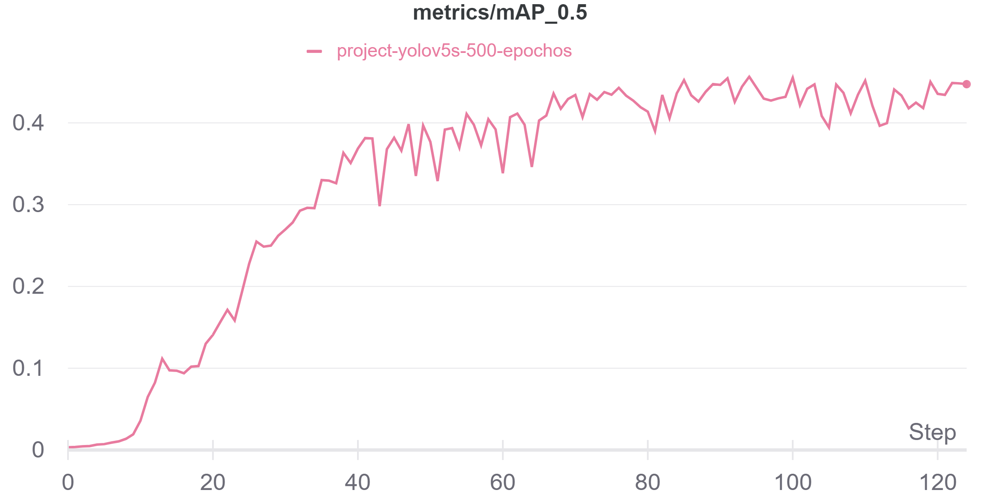

#### Yolo Ensemble

Yolov5 have many head architectures. Generaly, they all guve roughly the same mAP score. But for building an ensmeble we want the model to be differ from each other as much as we can, so now we would train five different yolo architechture, one for each of our 5 folds. 

We have first to create train.txt and val.txt for the five folds:

In [ ]:
working_path = Path('/content/yolo-ds')
working_path.mkdir(exist_ok=True)

for fold in range(nfolds):
    train_txt = '\n'.join(f'/content/jpeg-256/images/train/{f}' for f in train_df[train_df.val_fold != fold].image_fn.values)
    val_txt = '\n'.join(f'/content/jpeg-256/images/train/{f}' for f in train_df[train_df.val_fold == fold].image_fn.values)
    with open(working_path/f'train_fold_{fold}.txt', 'w+') as fp:
        fp.write(train_txt)
    with open(working_path/f'val_fold_{fold}.txt', 'w+') as fp:
        fp.write(val_txt)

In [ ]:
import yaml
for fold in range(nfolds):
    config = dict(
        train=str(working_path/f'train_fold_{fold}.txt'),
        val=str(working_path/f'val_fold_{fold}.txt'),
        nc=1,
        names=['0. opacity']
    )
    with open(working_path/f'config_fold_{fold}.yaml', 'w+') as fp:    
        yaml.dump(config, fp)

Now let's set the configuration of the 5-folds training. Based of former experimnets, will train `yolov5s` architecture for 400 epcohs and batch size of 256, `yolov5m` for 200 epochs with batch size of 128, yolov5l ,yolov5lx6 and yolo5vx for 120 epochs with batch size of 64.

In [ ]:
run_config = {
    0: {'model': 'yolov5s',
        'batch-size' : 256,
        'epochs': 400},
    1: {'model': 'yolov5s',
        'batch-size' : 256,
        'epochs': 300},
    2: {'model': 'yolov5m',
        'batch-size' : 128,
        'epochs': 200},
    3: {'model': 'yolov5l',
        'batch-size' : 64,
        'epochs': 120},
    4: {'model': 'yolov5x',
        'batch-size' : 64,
        'epochs': 120},   
}

In [ ]:
def train_yolo_fold(fold):
    model, batch_size, epochs = run_config[fold]['model'], run_config[fold]['batch-size'], run_config[fold]['epochs'] 
    !python train.py \
    --img 256 \
    --batch-size $batch_size \
    --epochs $epochs \
    --data $working_path/config_fold_{fold}.yaml \
    --weights {model}.pt \
    --hyp data/hyps/hyp.finetune.yaml \
    --name project-$model-$batch_size-$epochs-fold-$fold

In [ ]:
for fold in range(nfolds):
    train_yolo_fold(fold)

train: weights=yolov5s.pt, cfg=, data=/content/yolo-ds/config_fold_0.yaml, hyp=data/hyps/hyp.finetune.yaml, epochs=400, batch_size=256, imgsz=256, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=project-yolov5s-256-400-fold-0, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
remote: Enumerating objects: 4, done.
remote: Counting objects: 100% (4/4), done.
remote: Total 4 (delta 3), reused 4 (delta 3), pack-reused 0
Unpacking objects: 100% (4/4), done.
From https://github.com/ultralytics/yolov5
   7643b7d..56e003b  feature/annotator -> origin/feature/annotator
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-8-28 torch 1.9.0+cu10

Below an wandb graph which summerize the training process for the five folds.

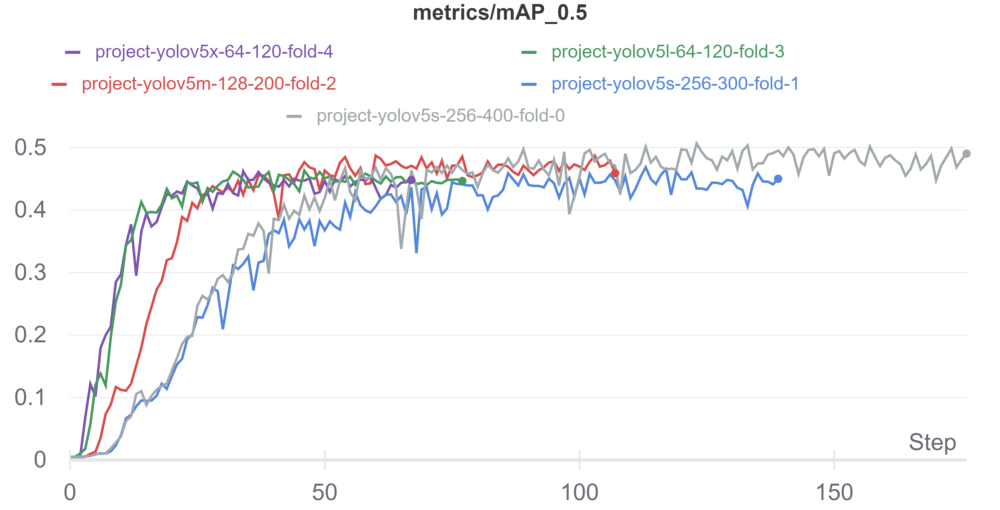

The epochs settings is based on former experimnets, which show that longer training lead to overfiting and the model didn't improve after certain number of epochs (different number between the models). All the models stopped before the numbers of epochs by the early stopping algorithm, but still the performance of the simplest model (yolov5) set to 400 epochs give the best results.

### Predicting `none` class

In addition to predicting the bounding boxes, we have to give for each image the probability that there are no findings at all in the CXR as confidence for `none` class. The common way in kaggle to handle with this class was to train a new model to decide whether the image conatians findings or not. But according the competition description, no findings means `negative` case, so such a model is exactly as trainin a binary model for the `negative` class, what, as we saw earlier, is much less accurate than the four model class!! So, the right thing will be just use the `negative` score here too. As we will see later, with this simple change we can imporve any of the open solutions in kaggle also.

# Conclusions And Final Score 

Putting all the above models together, the final score of this solution is 0.567. 

As a solution for the competition, I could find on kaggle open solution much better than mine. Armed with the above insight about the `none` class, I took the best open solution I could find on kaggle before the end of the competiton, and set the `none` class prediction to the `negtaive` probablity of the study which the image belongs to. By this change I imporved the place of the solution on the LB in about 50 places, and achived a bronze medal 🥉✌✌✌!!

How could I improve my solution?

On the study level, I think that obtain more data may be very helpful.
During the project, obtaining more data seems to me as something that requires a group of specialists to label the data to the four classes according to the new grading system defined for this problem. But at the end I realized that training a model which could classify negatives better or covid19 cases would be very helpful for this problem too, even if it cannot determining atypical and indeterminate cases according the grading system. More than that, any CXR taken before 2019 is for sure not a covid 19 case, so any dataset of CXR from the last years would be helpful for the problem.

On the image level, obtaining more data would be much harder. But on the image level I examined here only yolov5. There are libraries  like [mmdetection](https://github.com/open-mmlab/mmdetection) (which I discovered on the very last days) which contains a large set of object detection algorithm, from Fast R-CNN to YOLOX. Using a such library, It can be relatively easy to examine and compare large amount of object detection algorithms.

# Summary

In this project we developed a tool for Covid19 diagnosis using CXR. 

This includes diagnosis by the CXR using the predefined grading system alongside determining opacities areas in the lungs.

To do that, we developed two different models; one for the pneumonia diagnosis and the other for opacity determining.

For the diagnosis model, we examined several Resnet architectures, with differnet image resolutions. In addition, we developed a lung detector and used it to train another set of models which fed with the lung detector annotations alongside the original input. Although all the trained models gave similar results, ensembling then all together produce a siginfcant performance imporve on the test set. We conclude that additional improvement can be achived by obtaining a new dataset, and suggest a method for using external data for this problem.

For the opacity detection, we trained several yolov5 models with mAP of 0.45-0.5. to build the opacity detection ensemble.